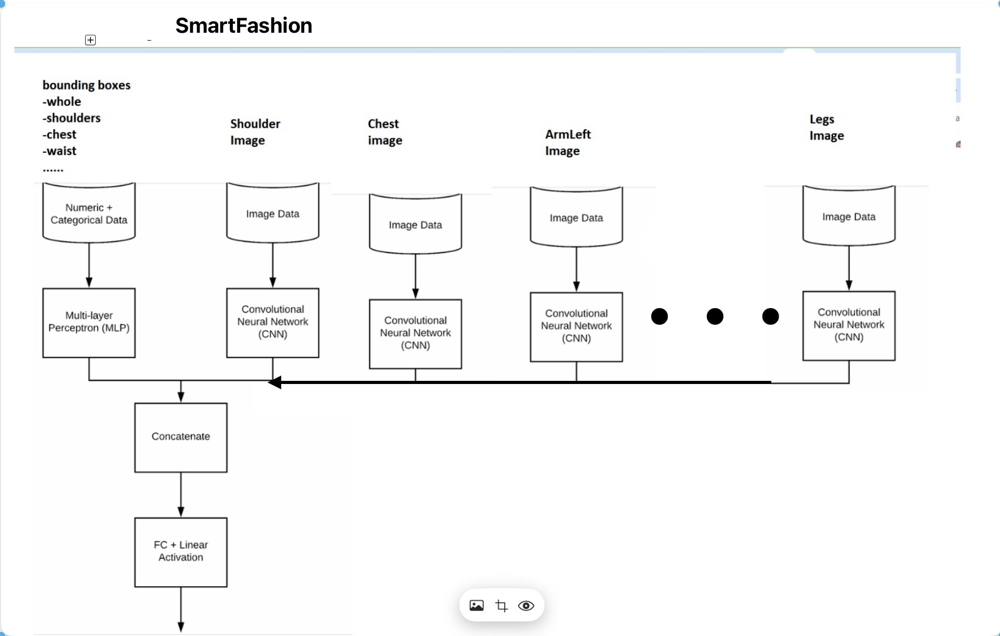

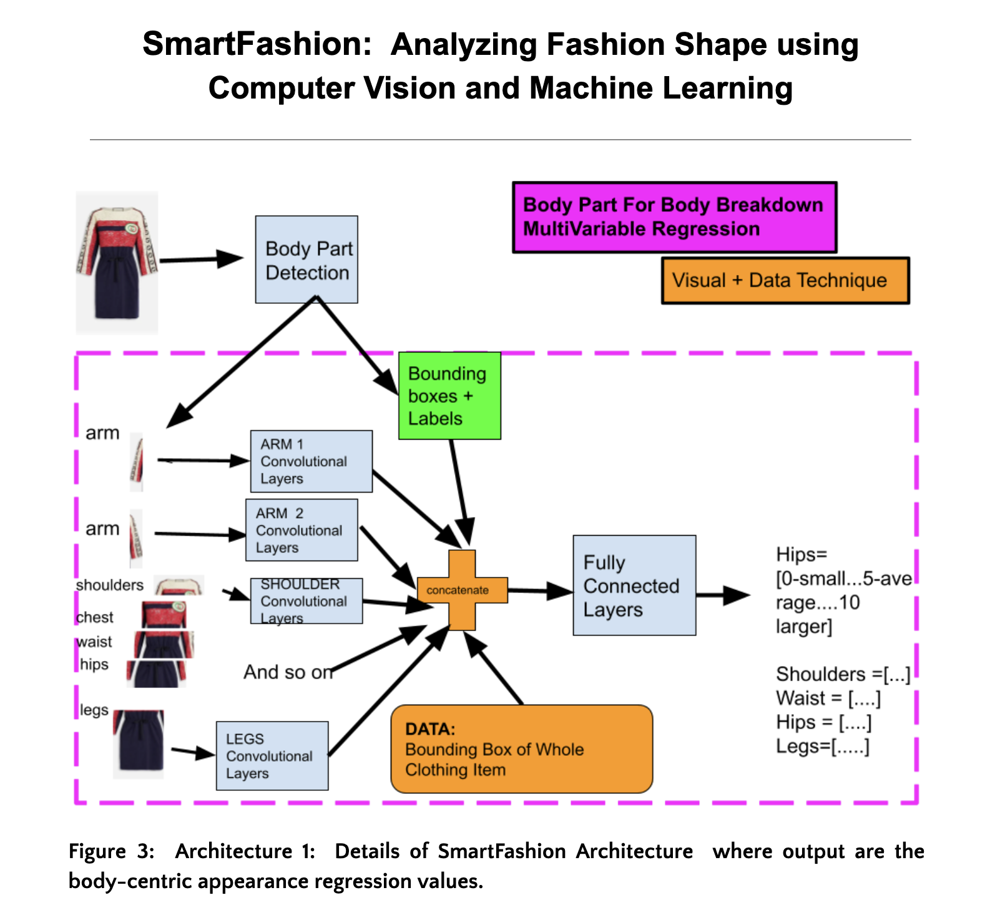




---
---

### **Multiple Input**
*  Multiple Input = Image (partimageFilenamme)  + Data(bounding Box of whole item--in this case a person   AND bounding box of part item --in this case a specified body part like shoulders).
* xmin, ymin, xmax, ymax =  represents the bounding box of an image of a "whole" item (in this case of a person)
* xminSX, yminSX, xmaxSX, ymaxSX = represents the bounding box of an image of a "part"item (in this case a body part, like shoulders).  NOTE SX = SB to indicate for Shoulders_Breadth, the bounding box which will have the regression value of SHoulders_Breadth associated with it.  SX= SS is for Shoulders_Symmetry and ST= for Shoulders_Tone.  See below step 2 for actual details of these values and how they appear in the data input

---
### **Multiple Output**
* Multiple regression outputs.  In this example, it is performed for a body part of shoulders and the regression values are "breadth", "tone" and "symmetry").
* In this example the actual values are Shoulders_Breadth, Shoulders_Symmetry, Shoulders_Tone  ---for a total of 3 regression outputs that evaluate the fitness of a user's shoulders body part.


---
## **Steps**

* **STEP 0 Mount Google Drive** this is where the data will be stored and written to
* **STEP 1 Install necessary modules and setup the Colab environment**
* **STEP 2.1 reading in a SpreadSheet** that contains data of the following format
[wholeImageFilename bbWholeX1 bbWholeY1 bbWholeX2 bbWholeY2 partImageFilename bbPartX1 bbPartY1 bbPartX2 bbPartY2 regOut1 regOut2 regOut3] --> create arrays wholeImageFileNames[] ,  partImageFilenames[],  bbWhole[], bbPart[], regOut1[], regOut2[], regOut3[]
* **STEP 2.2 sort into training and testing** arrays--> trainWholeImageFileNames[], trainpartImageFilenames[], trainbbWhole[], trainbbPart[], trainRegOut1[], trainRegOut2[]    AND  testWholeImageFileNames[], etc.
* **STEP 2.3 load images and prepocess data** create arrays trainImages[], testImages[] and validationImags[] that contain the actual images to be used for training and test.    ALSO, trainingNumericalData, testingNumericalData and validationNumericalData that contain the bounding box information for the whole body, and the shoulders (3 boxes for the 3 regression value images).  ALSO, **trainAllRegressionData**(also **testAllRegressionData & validationAllRegressionData** for test and validation data)  = numpy array of arrays = [[SB1, SS1, ST1], [SB2, SS2, ST2], ....]    where SBi = Shoulders_Breadth regression value for sample i, SSi = Shoulders_Symmetry for sample i,  STi = Shoulder_Tone for sample i.    An example:

```
[[5. 3. 5.]
 [5. 5. 4.]
 [3. 5. 3.]
 [3. 5. 5.]
 [9. 7. 7.]
 [3. 7. 7.]
 [5. 5. 5.]
 [5. 5. 5.]]
```
***CURRENTLY do not normalize data --may do in the future***
* **STEP 3 define the model** using Tensorflow and concatenate define the Multi-Input and Multi-Output model (see https://pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/ for an example).
* **STEP 4 train the model**  This will include a CNN pre-trained pre-existing Feature Extractor (CNN without the last layers).   Then this connects to incomming data (bounding box info) using Concatenate and this is passed to a Fully Connected network.  The output layer will be the 3 regression output values.
*  **STEP 5 test the model**


---
## **TRAINING + TESTING**
train a custom image regression model from a pre-existing model
*  tune parameters
*  evaluate it
*  run test cases and plot results
*  run tensorboard
*  save it to Saved_Model
*  export as TFLite




---
## **About Regression Training In General**

How is this done:  
*   The only difference from classification the metric for loss ---see below is where mean_absolute_errror is used and in our case the final output layer has a cardinality of 1  (which represents "severity" our target regression value)


```
 model.compile(
        optimizer=optimizer, loss="mean_absolute_error", metrics=[MeanAbsoluteError(), MeanAbsolutePercentageError()]
    )
```

*  Once the model is built, configure the training procedure using the Keras Model.compile method. The most important arguments to compile are the loss and the optimizer, since these define what will be optimized (mean_absolute_error) and how (using the tf.keras.optimizers.Adam).



References:
* https://www.tensorflow.org/tutorials/keras/regression
* https://rosenfelder.ai/keras-regression-efficient-net/


# **Expected Data**



*   images_dir = directory containing  the images both the whole and body part (shouders) images as well as the csv file
*   annotationsSingleLine.csv = a CSV file containing the following columns:
wholeimage, xmin,ymin,xmax,ymax,filenameSB (part image for Shoulders_Breadth), Shouders_Breadth regression,xminSB,yminSB,xmaxSB,ymaxSB, filenameSS (part image for Shoulders_Symmetry), Shouders_Symmetry regression,xminSS,yminSS,xmaxSS,ymaxSS, filenameST (part image for Shoulders_Tone), Shouders_Tone regression,xminST,yminST,xmaxST,ymaxST,

WHERE the Shoulders_Breadth, Shoulders_Symmetry and Shoulders_Tone are the output regression values ranging
in our case from 0 to 10 **bold text**

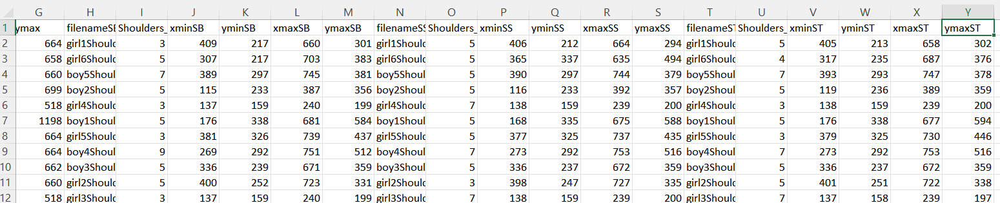

In [ ]:
# Copyright 2021 The TensorFlow Hub Authors. All Rights Reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# ==============================================================================

# STEP 0: mount Drive and install libraries and import packages

### assumes data in drive/Mask/MaskDetect/data


Here you'll use the dataset given in the zip file (http://borg.csueastbay.edu/~grewe/CS663/Mat/TensorFlow/TensorFlowLiteModelMaker/data.zip).

*  grab the zip and unzip and upload the content to your drive in the path YOUDRIVE/Mask/MaskDetect

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## STEP 1:  SETUP

In [ ]:
import itertools
import os

import matplotlib.pylab as plt
import numpy as np

import tensorflow as tf
import tensorflow_hub as hub

import pandas as pd

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)
print("GPU is", "available" if tf.config.list_physical_devices('GPU') else "NOT AVAILABLE")

TF version: 2.15.0
Hub version: 0.16.1
GPU is available


## Select the TF2 SavedModel module to use & specify BATCH_SIZE, determine IMAGE_SIZE to allign with model input size

For starters, use [https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/4](https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/4). The same URL can be used in code to identify the SavedModel and in your browser to show its documentation. (Note that models in TF1 Hub format won't work here.)

You can find more TF2 models that generate image feature vectors [here](https://tfhub.dev/s?module-type=image-feature-vector&tf-version=tf2).

There are multiple possible models to try. All you need to do is select a different one on the cell below and follow up with the notebook.

In [ ]:
#@title

model_name = "efficientnetv2-b0" # @param ['efficientnetv2-s', 'efficientnetv2-m', 'efficientnetv2-l', 'efficientnetv2-s-21k', 'efficientnetv2-m-21k', 'efficientnetv2-l-21k', 'efficientnetv2-xl-21k', 'efficientnetv2-b0-21k', 'efficientnetv2-b1-21k', 'efficientnetv2-b2-21k', 'efficientnetv2-b3-21k', 'efficientnetv2-s-21k-ft1k', 'efficientnetv2-m-21k-ft1k', 'efficientnetv2-l-21k-ft1k', 'efficientnetv2-xl-21k-ft1k', 'efficientnetv2-b0-21k-ft1k', 'efficientnetv2-b1-21k-ft1k', 'efficientnetv2-b2-21k-ft1k', 'efficientnetv2-b3-21k-ft1k', 'efficientnetv2-b0', 'efficientnetv2-b1', 'efficientnetv2-b2', 'efficientnetv2-b3', 'efficientnet_b0', 'efficientnet_b1', 'efficientnet_b2', 'efficientnet_b3', 'efficientnet_b4', 'efficientnet_b5', 'efficientnet_b6', 'efficientnet_b7', 'bit_s-r50x1', 'inception_v3', 'inception_resnet_v2', 'resnet_v1_50', 'resnet_v1_101', 'resnet_v1_152', 'resnet_v2_50', 'resnet_v2_101', 'resnet_v2_152', 'nasnet_large', 'nasnet_mobile', 'pnasnet_large', 'mobilenet_v2_100_224', 'mobilenet_v2_130_224', 'mobilenet_v2_140_224', 'mobilenet_v3_small_100_224', 'mobilenet_v3_small_075_224', 'mobilenet_v3_large_100_224', 'mobilenet_v3_large_075_224']

model_handle_map = {
  "efficientnetv2-s": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_s/feature_vector/2",
  "efficientnetv2-m": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_m/feature_vector/2",
  "efficientnetv2-l": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_l/feature_vector/2",
  "efficientnetv2-s-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_s/feature_vector/2",
  "efficientnetv2-m-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_m/feature_vector/2",
  "efficientnetv2-l-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_l/feature_vector/2",
  "efficientnetv2-xl-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_xl/feature_vector/2",
  "efficientnetv2-b0-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b0/feature_vector/2",
  "efficientnetv2-b1-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b1/feature_vector/2",
  "efficientnetv2-b2-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b2/feature_vector/2",
  "efficientnetv2-b3-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b3/feature_vector/2",
  "efficientnetv2-s-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_s/feature_vector/2",
  "efficientnetv2-m-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/feature_vector/2",
  "efficientnetv2-l-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_l/feature_vector/2",
  "efficientnetv2-xl-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_xl/feature_vector/2",
  "efficientnetv2-b0-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b0/feature_vector/2",
  "efficientnetv2-b1-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b1/feature_vector/2",
  "efficientnetv2-b2-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b2/feature_vector/2",
  "efficientnetv2-b3-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b3/feature_vector/2",
  "efficientnetv2-b0": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/feature_vector/2",
  "efficientnetv2-b1": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b1/feature_vector/2",
  "efficientnetv2-b2": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b2/feature_vector/2",
  "efficientnetv2-b3": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b3/feature_vector/2",
  "efficientnet_b0": "https://tfhub.dev/tensorflow/efficientnet/b0/feature-vector/1",
  "efficientnet_b1": "https://tfhub.dev/tensorflow/efficientnet/b1/feature-vector/1",
  "efficientnet_b2": "https://tfhub.dev/tensorflow/efficientnet/b2/feature-vector/1",
  "efficientnet_b3": "https://tfhub.dev/tensorflow/efficientnet/b3/feature-vector/1",
  "efficientnet_b4": "https://tfhub.dev/tensorflow/efficientnet/b4/feature-vector/1",
  "efficientnet_b5": "https://tfhub.dev/tensorflow/efficientnet/b5/feature-vector/1",
  "efficientnet_b6": "https://tfhub.dev/tensorflow/efficientnet/b6/feature-vector/1",
  "efficientnet_b7": "https://tfhub.dev/tensorflow/efficientnet/b7/feature-vector/1",
  "bit_s-r50x1": "https://tfhub.dev/google/bit/s-r50x1/1",
  "inception_v3": "https://tfhub.dev/google/imagenet/inception_v3/feature-vector/4",
  "inception_resnet_v2": "https://tfhub.dev/google/imagenet/inception_resnet_v2/feature-vector/4",
  "resnet_v1_50": "https://tfhub.dev/google/imagenet/resnet_v1_50/feature-vector/4",
  "resnet_v1_101": "https://tfhub.dev/google/imagenet/resnet_v1_101/feature-vector/4",
  "resnet_v1_152": "https://tfhub.dev/google/imagenet/resnet_v1_152/feature-vector/4",
  "resnet_v2_50": "https://tfhub.dev/google/imagenet/resnet_v2_50/feature-vector/4",
  "resnet_v2_101": "https://tfhub.dev/google/imagenet/resnet_v2_101/feature-vector/4",
  "resnet_v2_152": "https://tfhub.dev/google/imagenet/resnet_v2_152/feature-vector/4",
  "nasnet_large": "https://tfhub.dev/google/imagenet/nasnet_large/feature_vector/4",
  "nasnet_mobile": "https://tfhub.dev/google/imagenet/nasnet_mobile/feature_vector/4",
  "pnasnet_large": "https://tfhub.dev/google/imagenet/pnasnet_large/feature_vector/4",
  "mobilenet_v2_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/4",
  "mobilenet_v2_130_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/feature_vector/4",
  "mobilenet_v2_140_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/feature_vector/4",
  "mobilenet_v3_small_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/feature_vector/5",
  "mobilenet_v3_small_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_075_224/feature_vector/5",
  "mobilenet_v3_large_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/feature_vector/5",
  "mobilenet_v3_large_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_075_224/feature_vector/5",
}

model_image_size_map = {
  "efficientnetv2-s": 384,
  "efficientnetv2-m": 480,
  "efficientnetv2-l": 480,
  "efficientnetv2-b0": 224,
  "efficientnetv2-b1": 240,
  "efficientnetv2-b2": 260,
  "efficientnetv2-b3": 300,
  "efficientnetv2-s-21k": 384,
  "efficientnetv2-m-21k": 480,
  "efficientnetv2-l-21k": 480,
  "efficientnetv2-xl-21k": 512,
  "efficientnetv2-b0-21k": 224,
  "efficientnetv2-b1-21k": 240,
  "efficientnetv2-b2-21k": 260,
  "efficientnetv2-b3-21k": 300,
  "efficientnetv2-s-21k-ft1k": 384,
  "efficientnetv2-m-21k-ft1k": 480,
  "efficientnetv2-l-21k-ft1k": 480,
  "efficientnetv2-xl-21k-ft1k": 512,
  "efficientnetv2-b0-21k-ft1k": 224,
  "efficientnetv2-b1-21k-ft1k": 240,
  "efficientnetv2-b2-21k-ft1k": 260,
  "efficientnetv2-b3-21k-ft1k": 300,
  "efficientnet_b0": 224,
  "efficientnet_b1": 240,
  "efficientnet_b2": 260,
  "efficientnet_b3": 300,
  "efficientnet_b4": 380,
  "efficientnet_b5": 456,
  "efficientnet_b6": 528,
  "efficientnet_b7": 600,
  "inception_v3": 299,
  "inception_resnet_v2": 299,
  "nasnet_large": 331,
  "pnasnet_large": 331,
}

model_handle = model_handle_map.get(model_name)
pixels = model_image_size_map.get(model_name, 224)

print(f"Selected model: {model_name} : {model_handle}")

IMAGE_SIZE = (pixels, pixels)
print(f"Input size {IMAGE_SIZE}")

BATCH_SIZE = 4 #@param {type:"integer"}
print(f"Batch size {BATCH_SIZE}")

Selected model: efficientnetv2-b0 : https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/feature_vector/2
Input size (224, 224)
Batch size 4


#  STEP 2:  Set up the  dataset



## **For now will hardcode the data**

## Step 2.1 : read in the regressionData.csv file that contains in csv format:
 wholeimage, xmin,ymin,xmax,ymax,filenameSB (part image for Shoulders_Breadth), Shouders_Breadth regression,xminSB,yminSB,xmaxSB,ymaxSB, filenameSS (part image for Shoulders_Symmetry), Shouders_Symmetry regression,xminSS,yminSS,xmaxSS,ymaxSS, filenameST (part image for Shoulders_Tone), Shouders_Tone regression,xminST,yminST,xmaxST,ymaxST, using [pandas DataFrame](https://pandas.pydata.org/docs/reference/api/pandas.read_csv.html)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from typing import Iterator, List, Union, Tuple, Any

In [ ]:
#i_dir = "drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations"
i_dir = "drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly"
!ls $i_dir

classImages  trainingRun


In [ ]:
image_dir= "drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations"
main_dir =  "drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly"
log_dir = "drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/tensorboard"
print("image_dir\n")

print(image_dir)
!ls $image_dir
print("main_dir\n")
!ls $main_dir
print("log_dir\n")
!ls $log_dir

#dataFile = image_dir + "/annotationsSingleLine.csv"
dataFile = image_dir + "/parsedannotations3.csv"
!cat $dataFile


Streaming output truncated to the last 5000 lines.
 Neck7_07_png_Legs_Length.jpg
 Neck7_07_png_Neck_Depth.jpg
 Neck7_07_png_Shoulders_Breadth.jpg
 Neck7_07_png_UpArmL_Breadth.jpg
 Neck7_07_png_UpArmR_Breadth.jpg
 Neck7_07_png_Waist_Breadth.jpg
 Neck7_07_png_whole.jpg
 Neck8_01_png_ArmL_Length.jpg
 Neck8_01_png_ArmR_Length.jpg
 Neck8_01_png_Chest_Breadth.jpg
 Neck8_01_png_Hips_Breadth.jpg
 Neck8_01_png_Legs_Breadth.jpg
 Neck8_01_png_Legs_Length.jpg
 Neck8_01_png_Neck_Depth.jpg
 Neck8_01_png_Shoulders_Breadth.jpg
 Neck8_01_png_UpArmL_Breadth.jpg
 Neck8_01_png_UpArmR_Breadth.jpg
 Neck8_01_png_Waist_Breadth.jpg
 Neck8_01_png_whole.jpg
 Neck8_02_png_Chest_Breadth.jpg
 Neck8_02_png_Hips_Breadth.jpg
 Neck8_02_png_Legs_Breadth.jpg
 Neck8_02_png_Legs_Length.jpg
 Neck8_02_png_Neck_Depth.jpg
 Neck8_02_png_Waist_Breadth.jpg
 Neck8_02_png_whole.jpg
 Neck8_04_png_ArmL_Length.jpg
 Neck8_04_png_ArmR_Length.jpg
 Neck8_04_png_Chest_Breadth.jpg
 Neck8_04_png_Neck_Depth.jpg
 Neck8_04_png_Shoulders_Breadth

In [ ]:
#open a csv file with pandas
pandasDataFrame = pd.read_csv(dataFile)
print(pandasDataFrame)

                                             Unnamed: 0  \
0     sleeveWidth9_01_jpeg.rf.f04a2b6fadcc3f33e22ebc...   
1     skirt26_jpeg.rf.f104c801ba9a455c4f27886aa97669...   
2     tops32_jpeg.rf.ee1f092bab10c97092362f758b33341...   
3     tops78_jpeg.rf.f25fd3932176ac86d3471342500a797...   
4     skirt130_jpeg.rf.f12921890ae921a99a43f420fb620...   
...                                                 ...   
1067  dress26_jpeg.rf.74a2eca619c469a12f71864503fbfc...   
1068  jumpsuit22_jpeg.rf.73b932d4b188cc70d47527b2e98...   
1069  shorts36_jpeg.rf.74a2fc873b4bec869e2774c553a0f...   
1070  sleeve6_03_jpeg.rf.74e03921b3cac85b74cedc5b9cd...   
1071  tops12_jpeg.rf.7435f1a7a31aadb36db0ddb45945dbe...   

                                            filenameNew  width  height   xmin  \
0     sleeveWidth9_01_jpeg.rf.f04a2b6fadcc3f33e22ebc...    512     640  140.0   
1     skirt26_jpeg.rf.f104c801ba9a455c4f27886aa97669...    426     640   63.0   
2     tops32_jpeg.rf.ee1f092bab10c97092362f758b3

In [ ]:
print(pandasDataFrame['filenameNew'])
print(pandasDataFrame['SB_classvalue'])

0       sleeveWidth9_01_jpeg.rf.f04a2b6fadcc3f33e22ebc...
1       skirt26_jpeg.rf.f104c801ba9a455c4f27886aa97669...
2       tops32_jpeg.rf.ee1f092bab10c97092362f758b33341...
3       tops78_jpeg.rf.f25fd3932176ac86d3471342500a797...
4       skirt130_jpeg.rf.f12921890ae921a99a43f420fb620...
                              ...                        
1067    dress26_jpeg.rf.74a2eca619c469a12f71864503fbfc...
1068    jumpsuit22_jpeg.rf.73b932d4b188cc70d47527b2e98...
1069    shorts36_jpeg.rf.74a2fc873b4bec869e2774c553a0f...
1070    sleeve6_03_jpeg.rf.74e03921b3cac85b74cedc5b9cd...
1071    tops12_jpeg.rf.7435f1a7a31aadb36db0ddb45945dbe...
Name: filenameNew, Length: 1072, dtype: object
0      -1.0
1      -1.0
2       2.0
3       4.0
4      -1.0
       ... 
1067    2.0
1068    1.0
1069   -1.0
1070    4.0
1071    5.0
Name: SB_classvalue, Length: 1072, dtype: float64


In [ ]:
# add the correct path for the image locations.
pandasDataFrame["whole_image"] = (
        image_dir + "/" + pandasDataFrame["whole_image"]
    )
pandasDataFrame["ND_image"] = (
        image_dir + "/" + pandasDataFrame["ND_image"]
    )
pandasDataFrame["SB_image"] = (
        image_dir + "/" + pandasDataFrame["SB_image"]
    )
pandasDataFrame["CB_image"] = (
        image_dir + "/" + pandasDataFrame["CB_image"]
    )
pandasDataFrame["WB_image"] = (
        image_dir + "/" + pandasDataFrame["WB_image"]
    )
pandasDataFrame["HB_image"] = (
        image_dir + "/" + pandasDataFrame["HB_image"]
    )
pandasDataFrame["LB_image"] = (
        image_dir + "/" + pandasDataFrame["LB_image"]
    )
pandasDataFrame["LL_image"] = (
        image_dir + "/" + pandasDataFrame["LL_image"]
    )
pandasDataFrame["UpLeft_ArmBreadth_image"] = (
        image_dir + "/" + pandasDataFrame["UpLeft_ArmBreadth_image"]
    )
pandasDataFrame["UpRight_ArmBreadth_image"] = (
        image_dir + "/" + pandasDataFrame["UpRight_ArmBreadth_image"]
    )
pandasDataFrame["ArmL_Length_image"] = (
        image_dir + "/" + pandasDataFrame["ArmL_Length_image"]
    )
pandasDataFrame["ArmR_Length_image"] = (
        image_dir + "/" + pandasDataFrame["ArmR_Length_image"]
    )

In [ ]:
for x in pandasDataFrame["ND_image"]:
  print(x)


drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/tops32_jpeg_Neck_Depth.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/tops78_jpeg_Neck_Depth.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket55_jpeg_Neck_Depth.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/tops22_jpeg_Neck_Depth.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/trai

## Step 2.2 split the pandas DataFrame (just arrays of image filenames and severities) into train, test, validation.   Uses [train_test_split() from sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html)



*  [ pandas DataFrame](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.html) api




In [ ]:
from sklearn.model_selection import train_test_split
testAndValid_percent = 0.2  #as decimal percentange of data to form test+valid """was 0.4 but changed to 0.2"""
test_valid_split_percent = 0.5 #as a decimal the percentage of the test+valid data to test data

def split_data(df: pd.DataFrame) -> Tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame]:
    """Accepts a Pandas DataFrame and splits it into training, testing and validation data. Returns DataFrames.

    Parameters
    ----------
    df : pd.DataFrame
        Your Pandas DataFrame containing all your data.

    Returns
    -------
    Union[pd.DataFrame, pd.DataFrame, pd.DataFrame]
        [description]
    """
    train, val_test = train_test_split(df, test_size=testAndValid_percent, random_state=1)  # split the data with a validation size of train_valid_percent
    val, test = train_test_split( val_test, test_size=test_valid_split_percent, random_state=1)  # split the valid and test data by percent specified above

    print("shape train: ", train.shape)  # type: ignore
    print("shape val: ", val.shape)  # type: ignore
    print("shape test: ", test.shape)  # type: ignore

    print("Descriptive statistics of train:")
    print(train.describe())  # type: ignore
    return train, val, test  # type: ignore


#use function above to split into train test, validation
train, val, test = split_data(pandasDataFrame)

#see https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.html  for documentation on DataFrames in Pandas

#print out lengths
print("LENGTH:  train test valid:  " + str(len(train)) + ", " + str(len(test)) + ", " + str(len(val)))


#print out data

print("train")
for index, row in train.iterrows():
    print(row["LB_image"], row["LB_classvalue"])

print("\n\n test")
for index, row in test.iterrows():
    print(row["LB_image"], row["LB_classvalue"])

print("\n\n valid")
for index, row in val.iterrows():
    print(row["LB_image"], row["LB_classvalue"])

print("\n\nshape train: ", train.shape)  # type: ignore
print("shape val: ", val.shape)  # type: ignore
print("shape test: ", test.shape)  # type: ignore

print("\n\nDescriptive statistics of test:")
print(test.describe())  # type: ignore


print(train.info)
#print(train.iteritems)
print(train.itertuples)


shape train:  (857, 75)
shape val:  (107, 75)
shape test:  (108, 75)
Descriptive statistics of train:
            width      height        xmin        ymin        xmax        ymax  \
count  857.000000  857.000000  857.000000  857.000000  857.000000  857.000000   
mean   474.042007  639.696616   66.726954   54.225204  406.425904  581.802800   
std     57.623764    7.038871   44.734159   48.264162   65.404792   57.608103   
min    291.000000  438.000000    0.000000    0.000000    0.000000    0.000000   
25%    426.000000  640.000000   29.000000   20.000000  365.000000  561.000000   
50%    488.000000  640.000000   62.000000   37.000000  399.000000  598.000000   
75%    512.000000  640.000000   99.000000   78.000000  445.000000  618.000000   
max    640.000000  640.000000  185.000000  211.000000  640.000000  640.000000   

           xminND      yminND      xmaxND      ymaxND  ...  xminALeftL  \
count  857.000000  857.000000  857.000000  857.000000  ...  857.000000   
mean    91.603267   

In [ ]:
test.columns

Index(['Unnamed: 0', 'filenameNew', 'width', 'height', 'xmin', 'ymin', 'xmax',
       'ymax', 'whole_image', 'xminND', 'yminND', 'xmaxND', 'ymaxND',
       'ND_classvalue', 'ND_image', 'xminSB', 'yminSB', 'xmaxSB', 'ymaxSB',
       'SB_classvalue', 'SB_image', 'xminCB', 'yminCB', 'xmaxCB', 'ymaxCB',
       'CB_classvalue', 'CB_image', 'xminWB', 'yminWB', 'xmaxWB', 'ymaxWB',
       'WB_classvalue', 'WB_image', 'xminHB', 'yminHB', 'xmaxHB', 'ymaxHB',
       'HB_classvalue', 'HB_image', 'xminLB', 'yminLB', 'xmaxLB', 'ymaxLB',
       'LB_classvalue', 'LB_image', 'xminLL', 'yminLL', 'xmaxLL', 'ymaxLL',
       'LL_classvalue', 'LL_image', 'xminUpLeftAB', 'yminUpLeftAB',
       'xmaxUpLeftAB', 'ymaxUpLeftAB', 'UpLeft_ArmBreadth_classvalue',
       'UpLeft_ArmBreadth_image', 'xminUpRightAB', 'yminUpRightAB',
       'xmaxUpRightAB', 'ymaxUpRightAB', 'UpRight_ArmBreadth_classvalue',
       'UpRight_ArmBreadth_image', 'xminALeftL', 'yminALeftL', 'xmaxALeftL',
       'ymaxALeftL', 'ArmL_Length_cla

In [ ]:
columns_to_count = ['ND_classvalue', 'SB_classvalue', 'CB_classvalue', 'WB_classvalue', 'HB_classvalue','LB_classvalue', 'LL_classvalue','UpLeft_ArmBreadth_classvalue', 'UpRight_ArmBreadth_classvalue','ArmL_Length_classvalue', 'ArmR_Length_classvalue']  # List your columns here

for column in columns_to_count:
    counts = test[column].value_counts()
    print(f"Counts for {column}:")
    print(f"-1s: {counts.get(-1, 0)},1s: {counts.get(1.0, 0)}, 2s: {counts.get(2.0, 0)}, 3s: {counts.get(3.0, 0)},4s: {counts.get(4.0, 0)},5s: {counts.get(5.0, 0)},6s: {counts.get(6.0, 0)},7s: {counts.get(7.0, 0)},8s: {counts.get(8.0, 0)},9s: {counts.get(9.0, 0)}")

Counts for ND_classvalue:
-1s: 59,1s: 3, 2s: 10, 3s: 6,4s: 5,5s: 7,6s: 13,7s: 3,8s: 2,9s: 0
Counts for SB_classvalue:
-1s: 58,1s: 9, 2s: 2, 3s: 7,4s: 15,5s: 3,6s: 4,7s: 3,8s: 4,9s: 3
Counts for CB_classvalue:
-1s: 51,1s: 9, 2s: 4, 3s: 9,4s: 11,5s: 6,6s: 10,7s: 2,8s: 4,9s: 2
Counts for WB_classvalue:
-1s: 53,1s: 17, 2s: 9, 3s: 9,4s: 6,5s: 6,6s: 0,7s: 4,8s: 4,9s: 0
Counts for HB_classvalue:
-1s: 15,1s: 10, 2s: 14, 3s: 37,4s: 10,5s: 5,6s: 6,7s: 8,8s: 2,9s: 1
Counts for LB_classvalue:
-1s: 23,1s: 7, 2s: 12, 3s: 14,4s: 15,5s: 17,6s: 7,7s: 8,8s: 2,9s: 3
Counts for LL_classvalue:
-1s: 24,1s: 7, 2s: 6, 3s: 16,4s: 4,5s: 5,6s: 9,7s: 11,8s: 21,9s: 5
Counts for UpLeft_ArmBreadth_classvalue:
-1s: 62,1s: 9, 2s: 5, 3s: 5,4s: 6,5s: 8,6s: 4,7s: 5,8s: 1,9s: 3
Counts for UpRight_ArmBreadth_classvalue:
-1s: 62,1s: 8, 2s: 5, 3s: 5,4s: 6,5s: 7,6s: 4,7s: 6,8s: 2,9s: 3
Counts for ArmL_Length_classvalue:
-1s: 60,1s: 8, 2s: 1, 3s: 4,4s: 1,5s: 0,6s: 3,7s: 9,8s: 20,9s: 2
Counts for ArmR_Length_classvalue:
-1s: 61

LENGTH:  train test valid:  857, 108, 107
train
drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket55_jpeg_Hips_Breadth.jpg 4.0


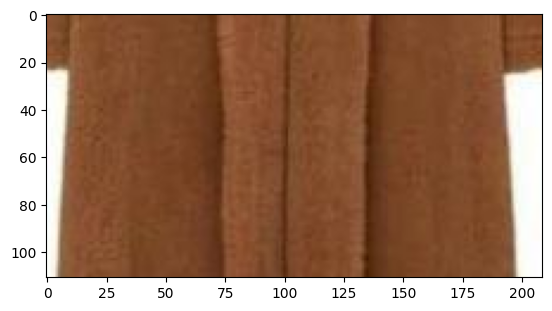

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress129_jpeg_Hips_Breadth.jpg 9.0


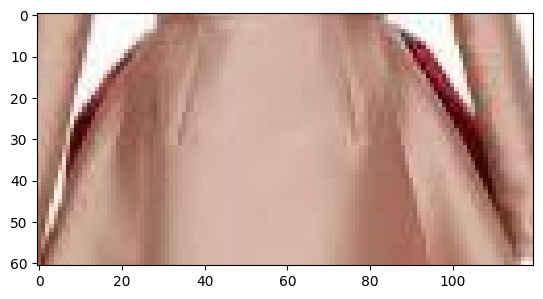

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/sleeve5_07_jpeg_Hips_Breadth.jpg 7.0


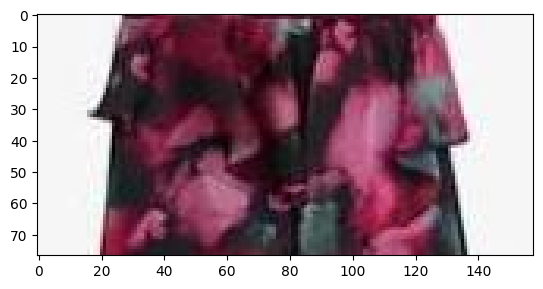

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/waistp4_03_jpeg_Hips_Breadth.jpg 5.0


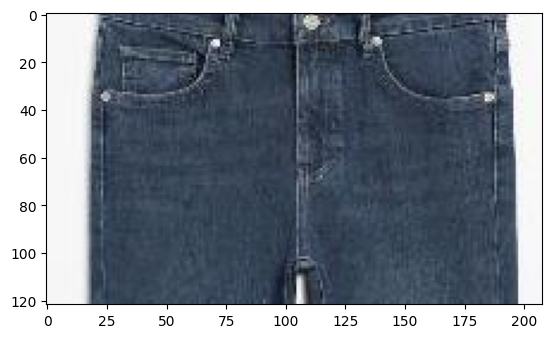

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants110_jpeg_Hips_Breadth.jpg 3.0


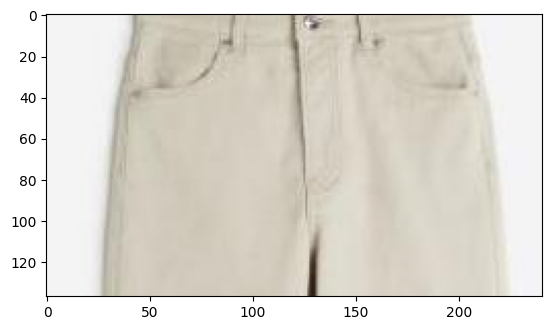

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress119_jpeg_Hips_Breadth.jpg 1.0


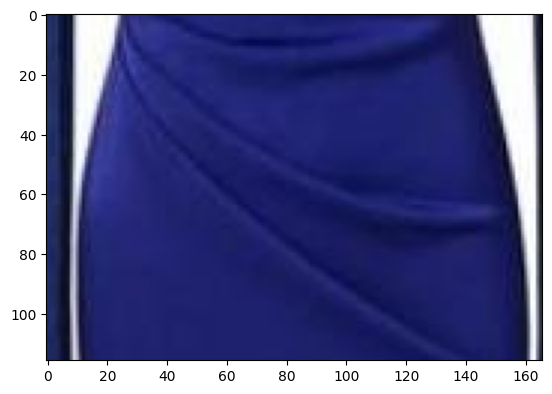

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/Neck5_05_png_Hips_Breadth.jpg 1.0


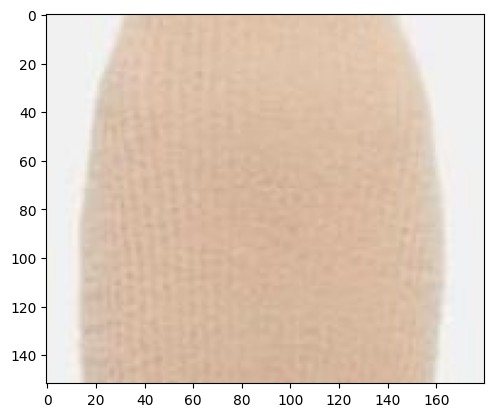

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts107_jpeg_Hips_Breadth.jpg 4.0


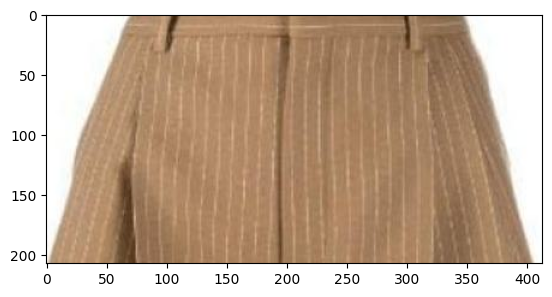

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


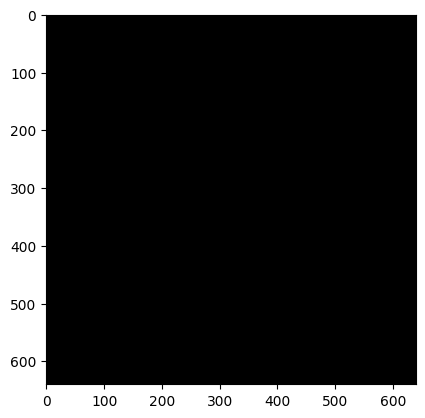

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket18_jpeg_Hips_Breadth.jpg 3.0


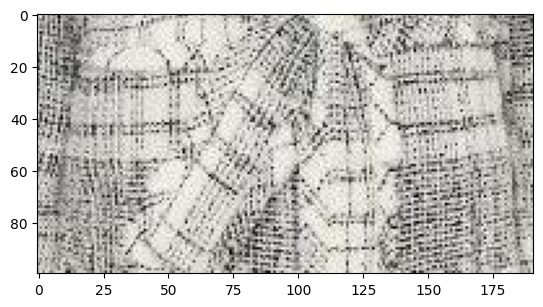

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/Screenshot-2023-12-18-at-10-08-42-AM_png_Hips_Breadth.jpg 4.0


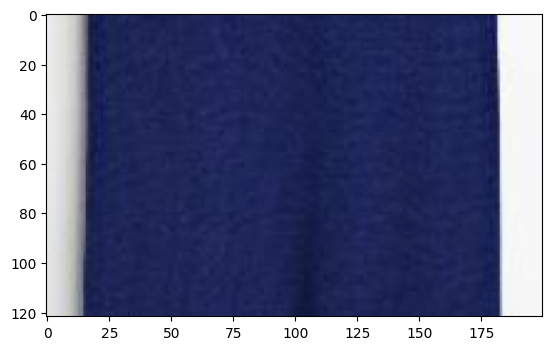

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


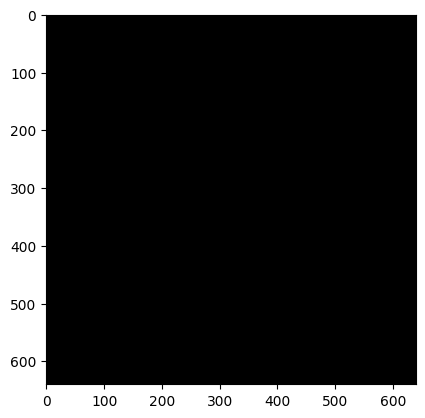

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


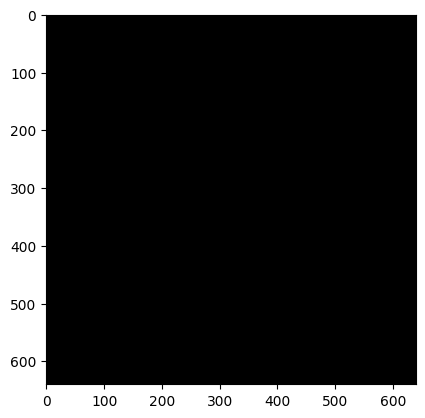

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/sleeve7_05_jpeg_Hips_Breadth.jpg 3.0


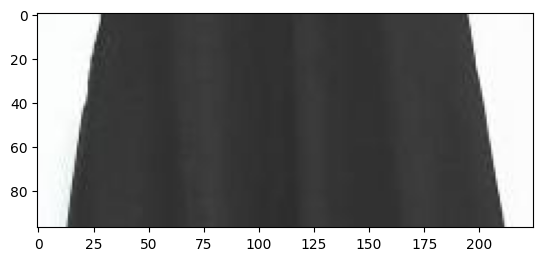

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


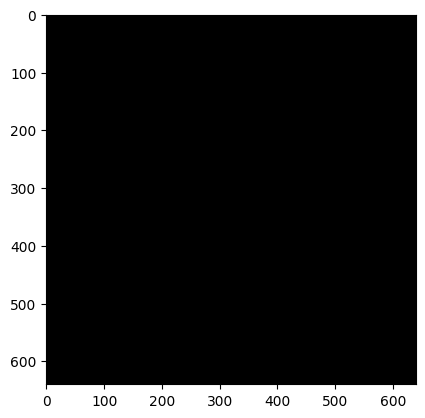

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt32_jpeg_Hips_Breadth.jpg 3.0


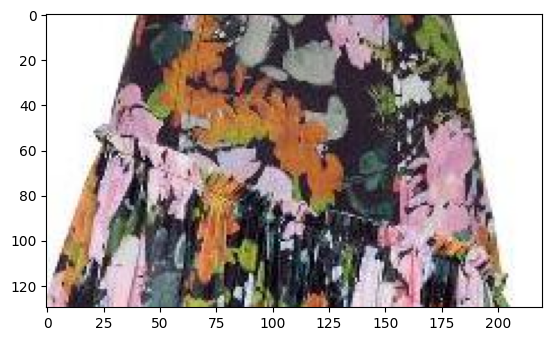

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/tops71_jpeg_Hips_Breadth.jpg 3.0


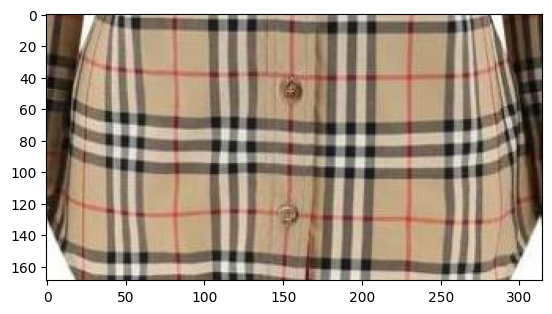

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit7_jpeg_Hips_Breadth.jpg 2.0


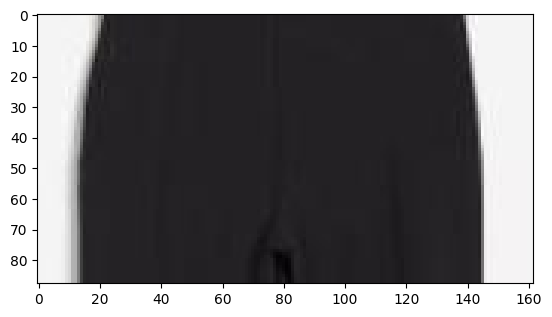

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants13_jpeg_Hips_Breadth.jpg 4.0


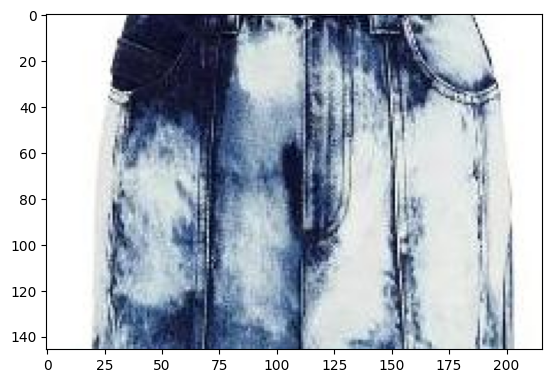

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


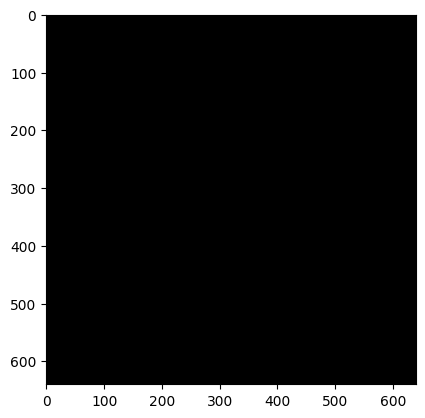

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit61_jpeg_Hips_Breadth.jpg 4.0


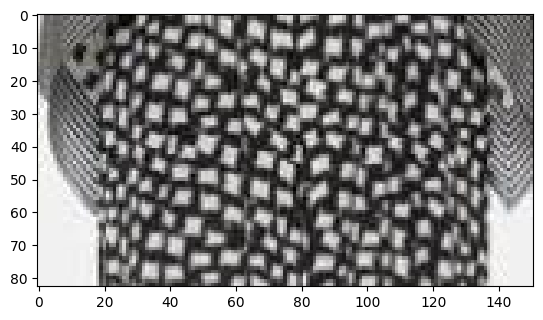

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt107_jpeg_Hips_Breadth.jpg 4.0


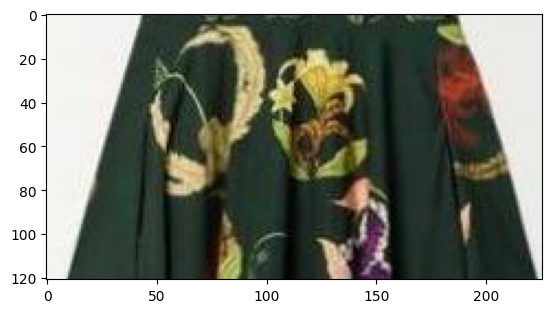

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


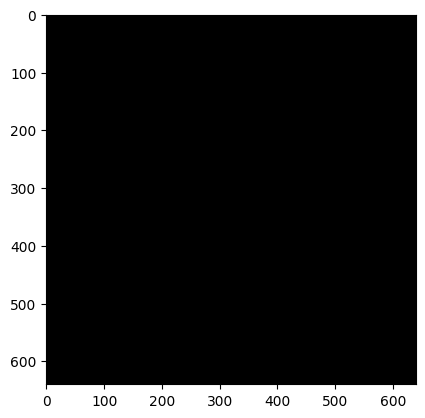

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants112_jpeg_Hips_Breadth.jpg 4.0


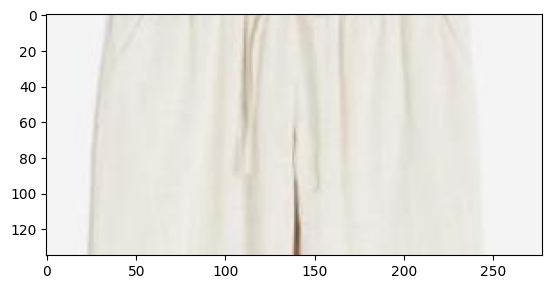

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts89_jpeg_Hips_Breadth.jpg 1.0


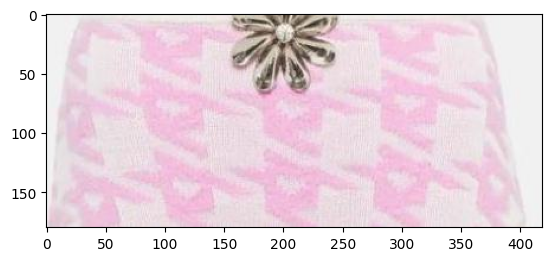

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit28_jpeg_Hips_Breadth.jpg 3.0


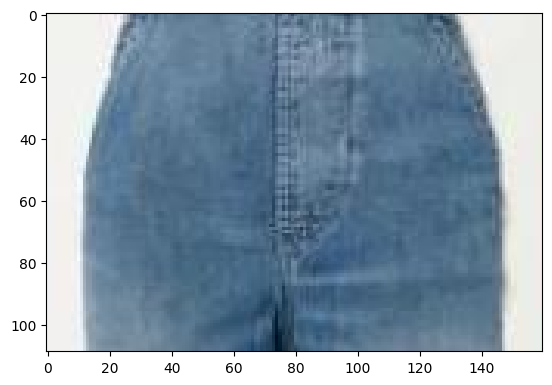

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


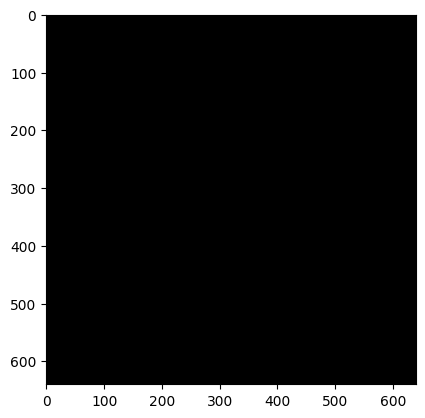

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit32_jpeg_Hips_Breadth.jpg 4.0


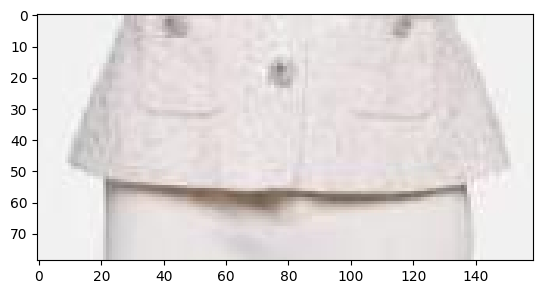

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket19_jpeg_Hips_Breadth.jpg 3.0


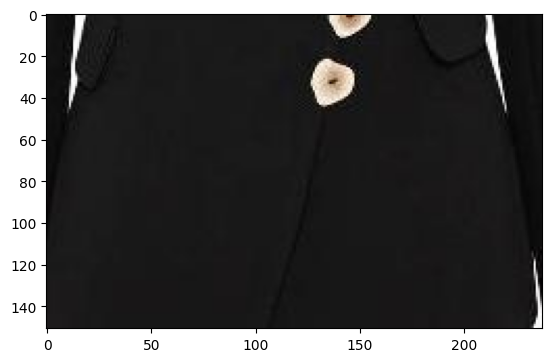

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts99_jpeg_Hips_Breadth.jpg 1.0


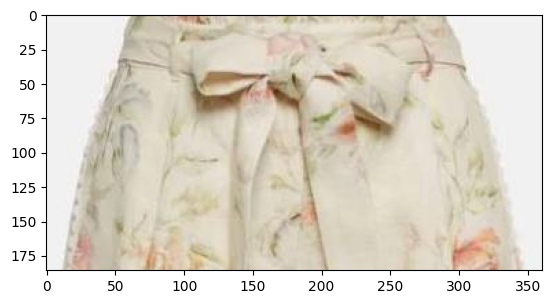

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/sleeve2_03_jpeg_Hips_Breadth.jpg 2.0


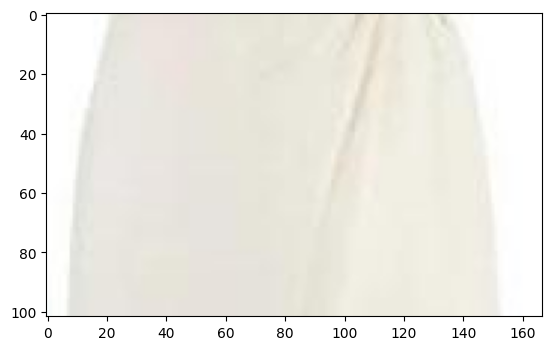

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket25_jpeg_Hips_Breadth.jpg 4.0


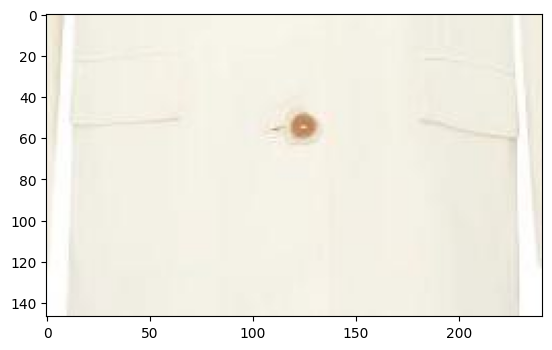

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt117_jpeg_Hips_Breadth.jpg 3.0


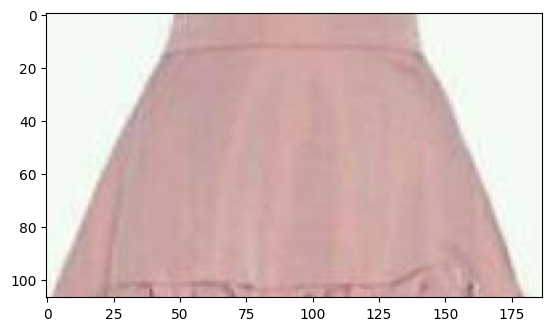

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts52_jpeg_Hips_Breadth.jpg 3.0


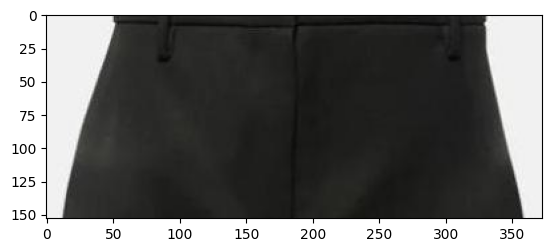

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts126_jpeg_Hips_Breadth.jpg 1.0


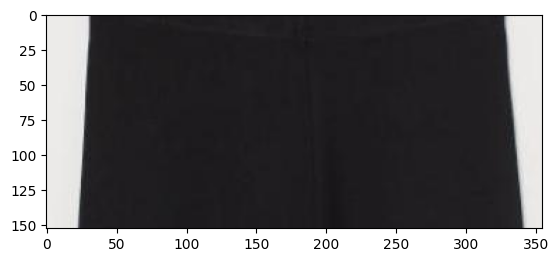

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress58_jpeg_Hips_Breadth.jpg 6.0


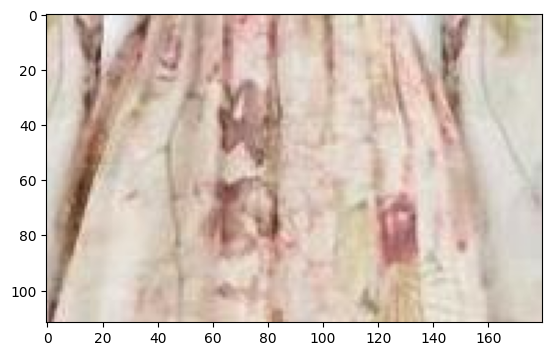

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts90_jpeg_Hips_Breadth.jpg 3.0


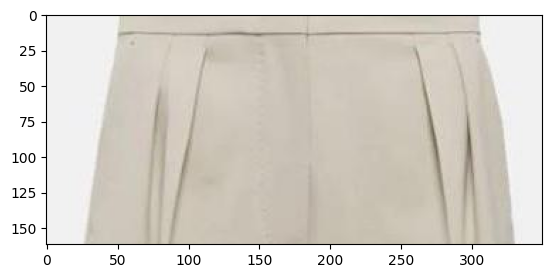

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts1278jpeg_jpeg_Hips_Breadth.jpg 2.0


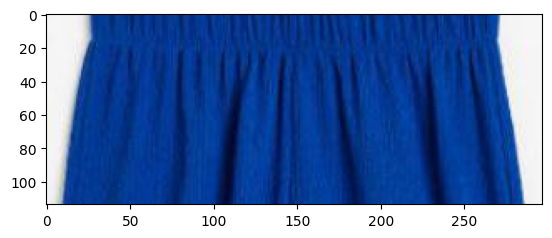

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants43_jpeg_Hips_Breadth.jpg 3.0


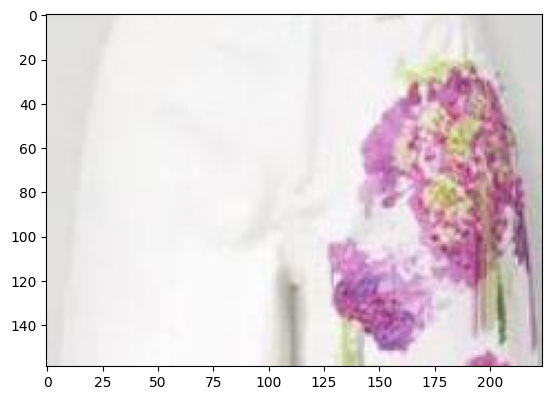

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/hips8_02_jpeg_Hips_Breadth.jpg 8.0


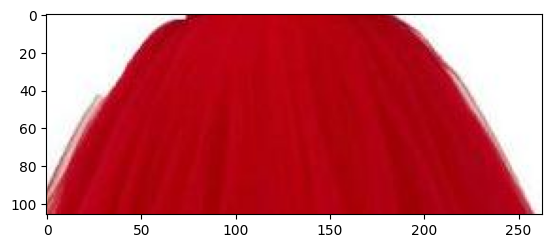

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/chest9_06_jpeg_Hips_Breadth.jpg 3.0


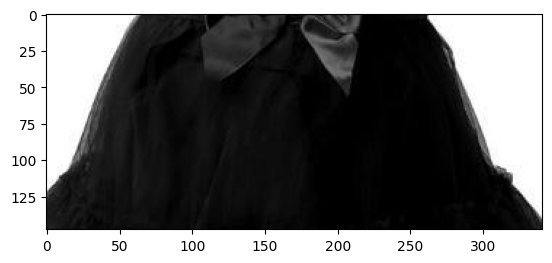

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts51_jpeg_Hips_Breadth.jpg 3.0


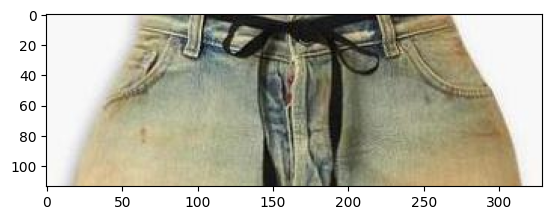

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jacket20_jpeg_Hips_Breadth.jpg 3.0


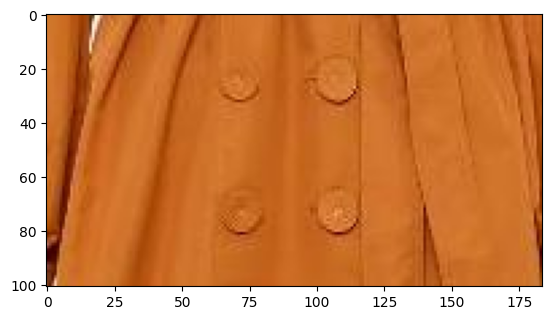

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts21_jpeg_Hips_Breadth.jpg 3.0


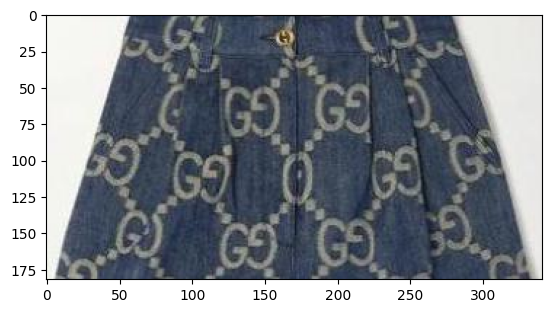

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt63_jpeg_Hips_Breadth.jpg 4.0


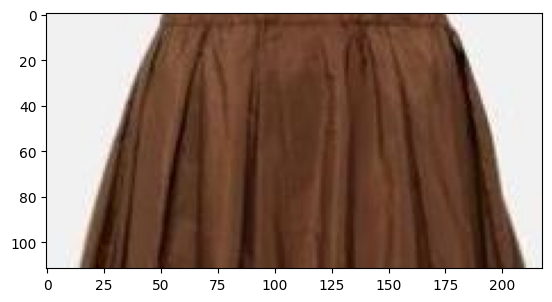

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


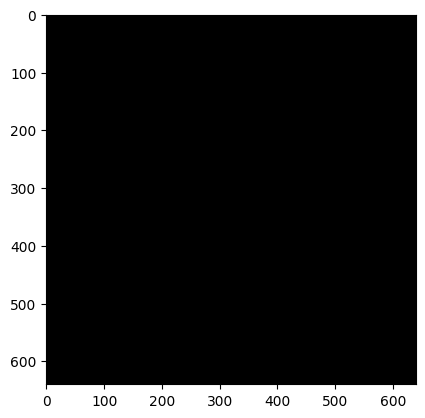

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pantslong66_jpeg_Hips_Breadth.jpg 4.0


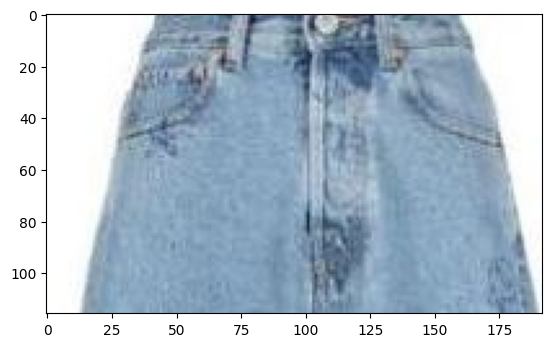

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt34_jpeg_Hips_Breadth.jpg 3.0


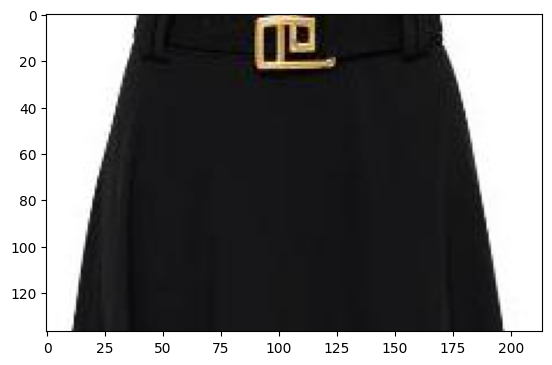

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress128_jpeg_Hips_Breadth.jpg 1.0


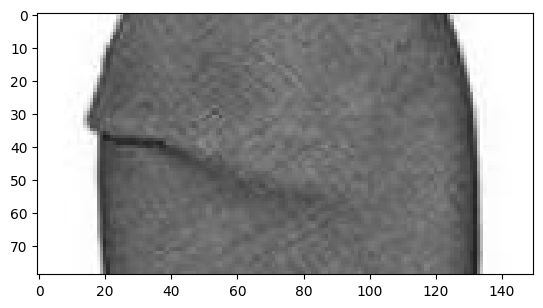

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts42_jpeg_Hips_Breadth.jpg 1.0


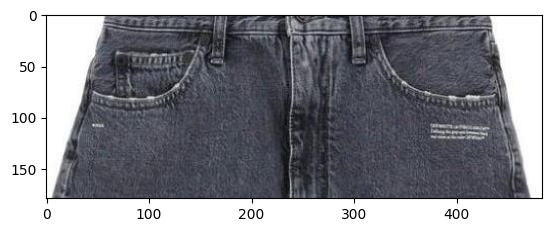

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts103_jpeg_Hips_Breadth.jpg 3.0


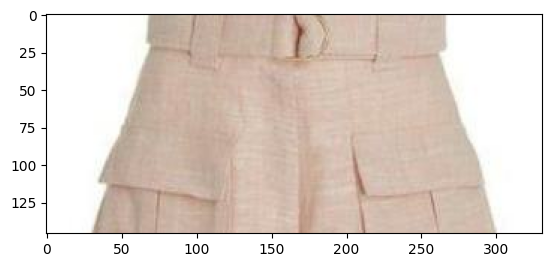

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants41_jpeg_Hips_Breadth.jpg 1.0


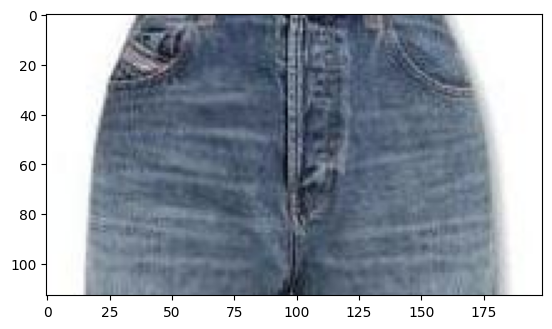

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants114_jpeg_Hips_Breadth.jpg 3.0


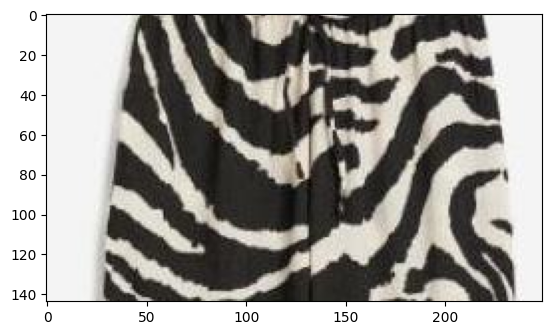

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit20_jpeg_Hips_Breadth.jpg 1.0


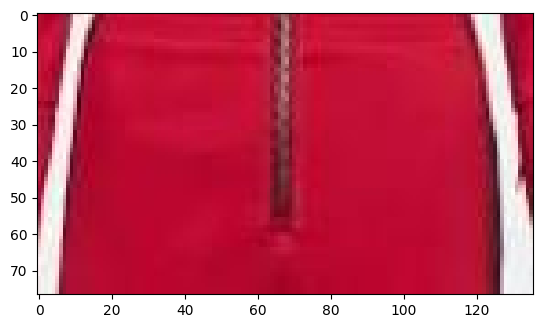

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress141_jpeg_Hips_Breadth.jpg 3.0


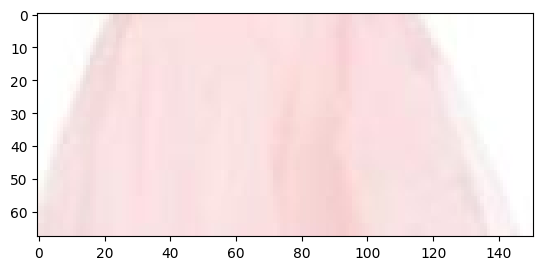

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants14_jpeg_Hips_Breadth.jpg 3.0


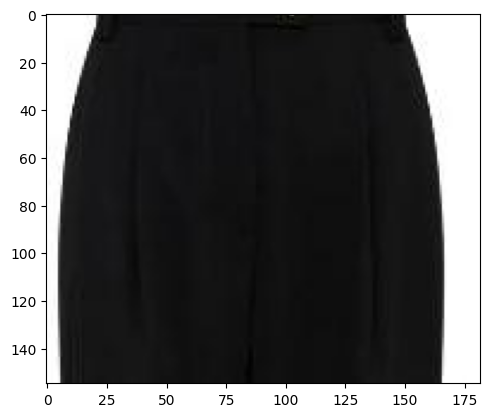

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


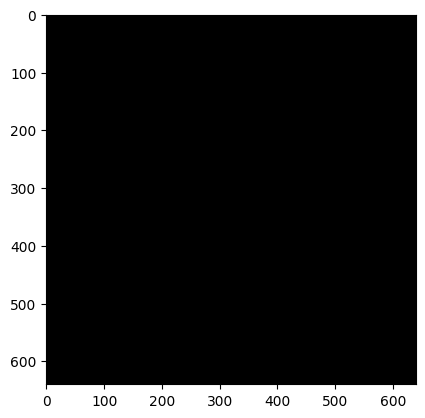

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts104_jpeg_Hips_Breadth.jpg 3.0


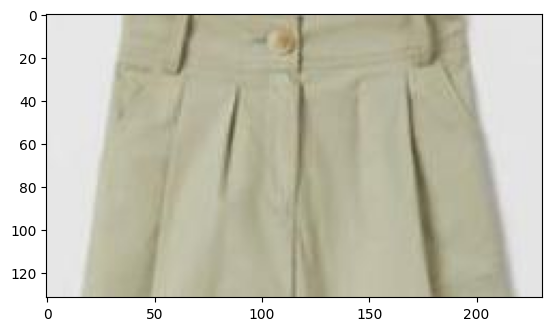

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt110_jpeg_Hips_Breadth.jpg 3.0


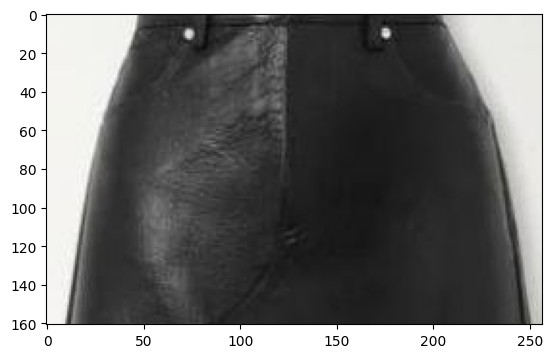

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress114_jpeg_Hips_Breadth.jpg 3.0


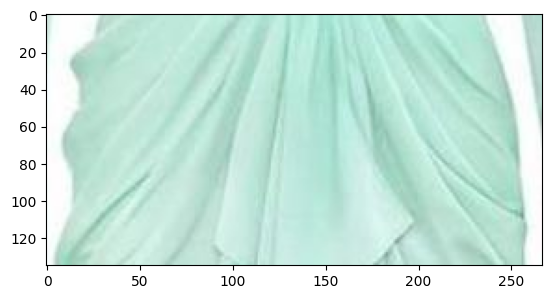

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit70_jpeg_Hips_Breadth.jpg 2.0


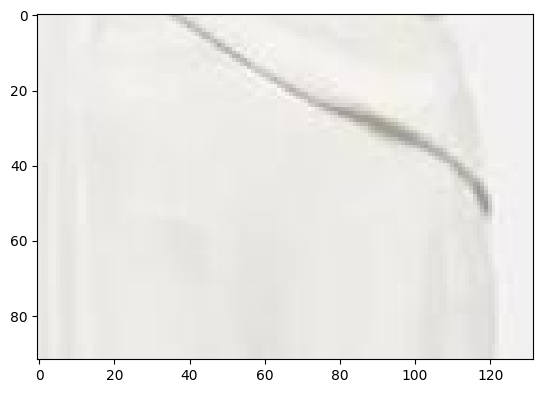

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit92_jpeg_Hips_Breadth.jpg 1.0


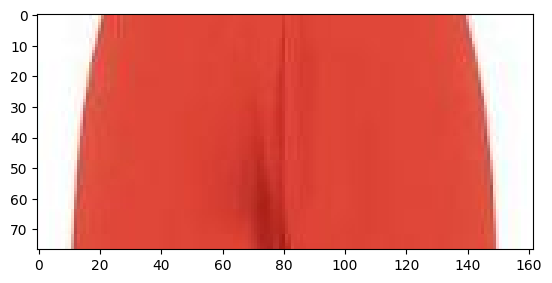

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress130_jpeg_Hips_Breadth.jpg 4.0


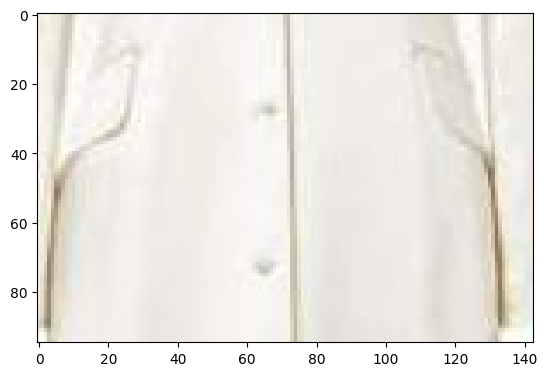

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt135_jpeg_Hips_Breadth.jpg 3.0


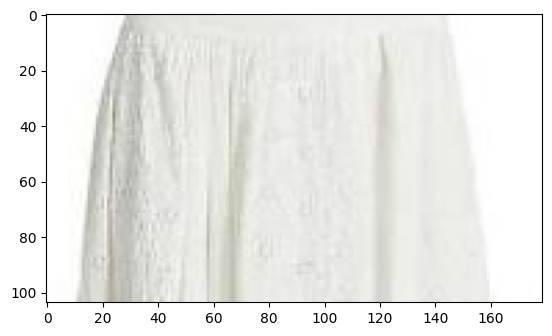

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants77_jpeg_Hips_Breadth.jpg 3.0


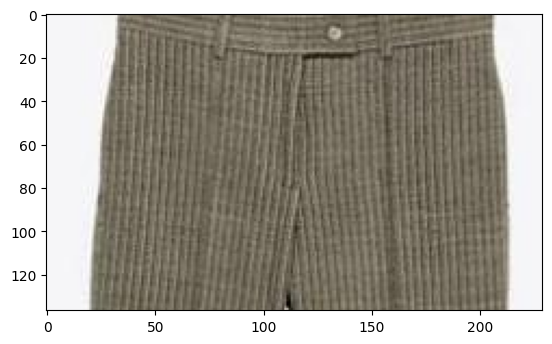

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants53_jpeg_Hips_Breadth.jpg 1.0


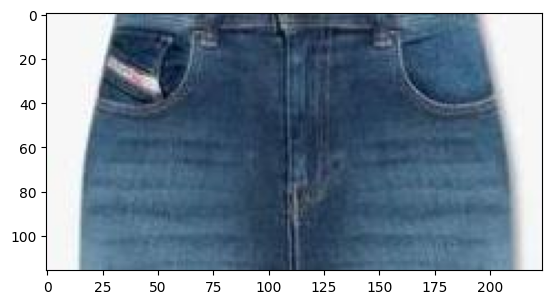

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/Neck2_02_png_Hips_Breadth.jpg 3.0


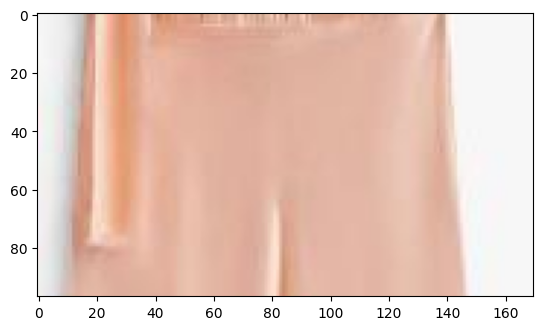

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts57_jpeg_Hips_Breadth.jpg 2.0


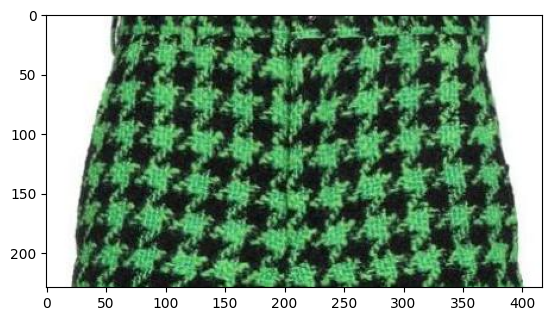

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress38_jpeg_Hips_Breadth.jpg 6.0


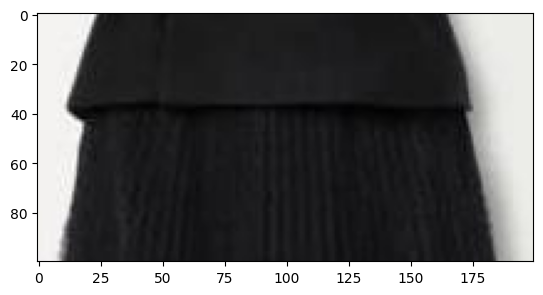

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts34_jpeg_Hips_Breadth.jpg 1.0


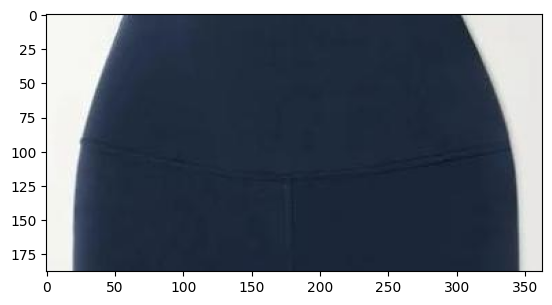

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/legsWidthSkirt3_03_jpeg_Hips_Breadth.jpg 2.0


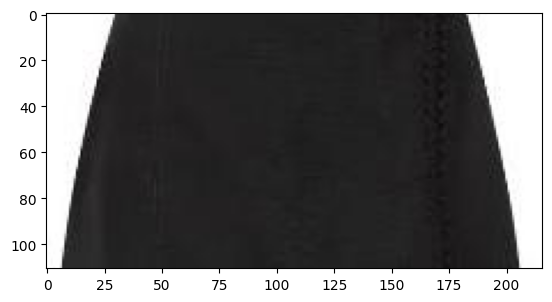

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts81_jpeg_Hips_Breadth.jpg 1.0


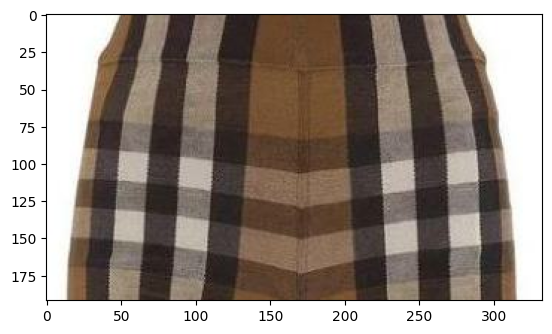

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/pants86_jpeg_Hips_Breadth.jpg 1.0


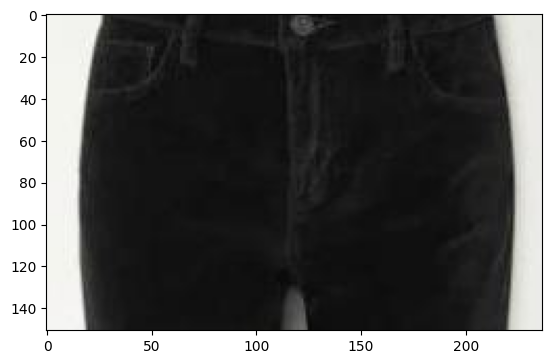

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shoulder2_03_jpeg_Hips_Breadth.jpg 4.0


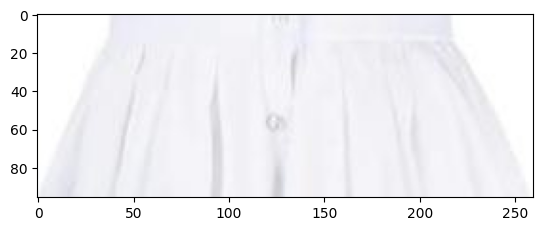

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit52_jpeg_Hips_Breadth.jpg 4.0


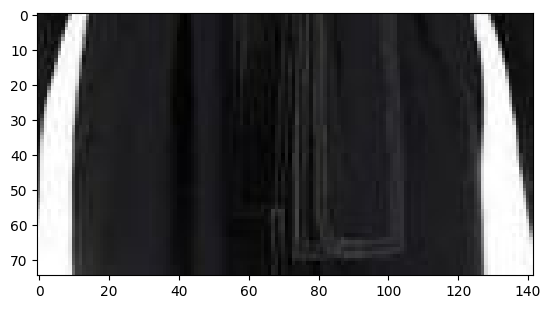

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit12_jpeg_Hips_Breadth.jpg 4.0


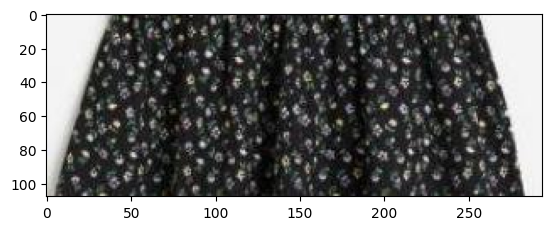

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/legsWidthSkirt8_05_jpeg_Hips_Breadth.jpg 6.0


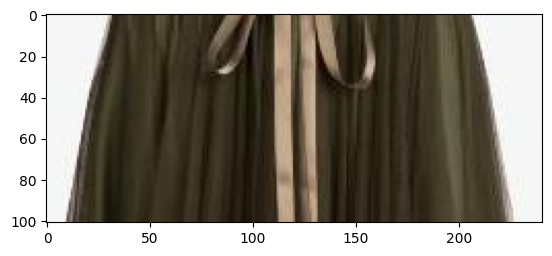

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt37_jpeg_Hips_Breadth.jpg 2.0


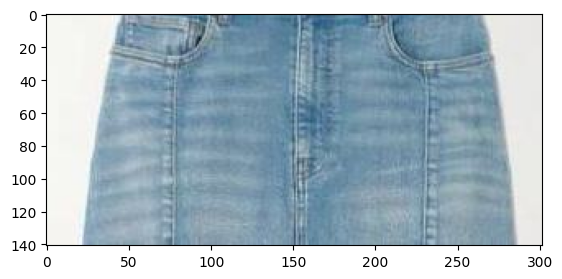

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shoulder2_02_jpeg_Hips_Breadth.jpg 3.0


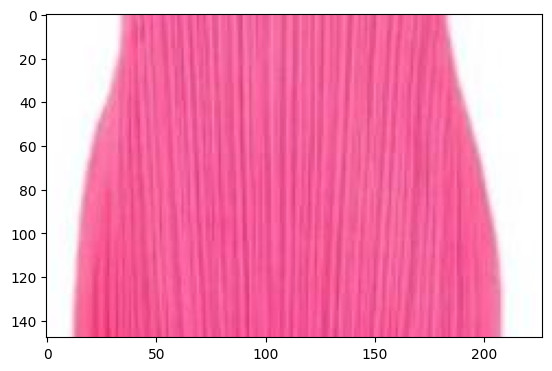

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


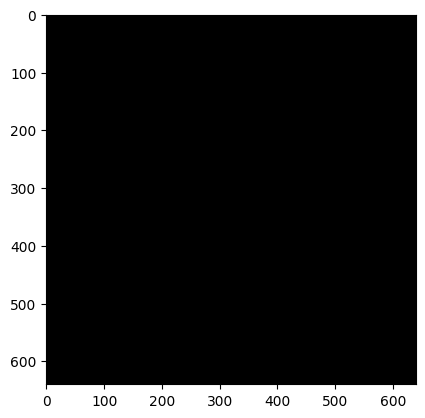

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/jumpsuit79_jpeg_Hips_Breadth.jpg 3.0


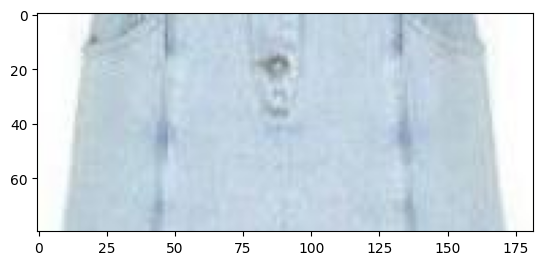

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt124_jpeg_Hips_Breadth.jpg 7.0


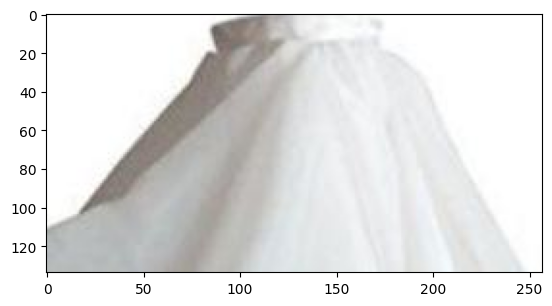

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt40_jpeg_Hips_Breadth.jpg 3.0


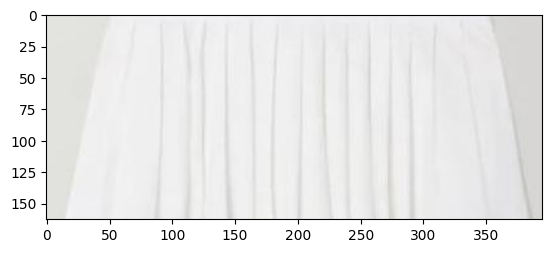

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/chest7_01_jpeg_Hips_Breadth.jpg 6.0


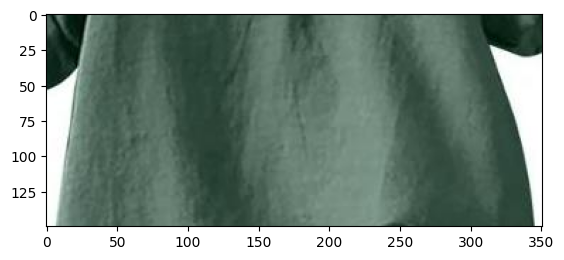

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/dress26_jpeg_Hips_Breadth.jpg 2.0


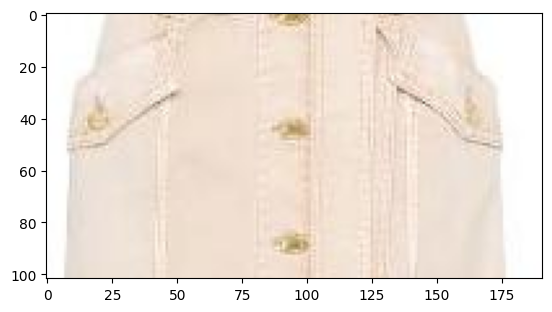

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/tops34_jpeg_Hips_Breadth.jpg 6.0


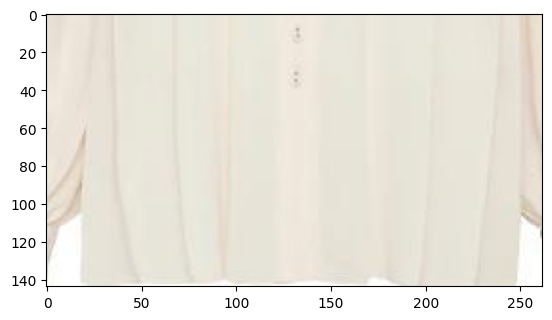

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt56_jpeg_Hips_Breadth.jpg 3.0


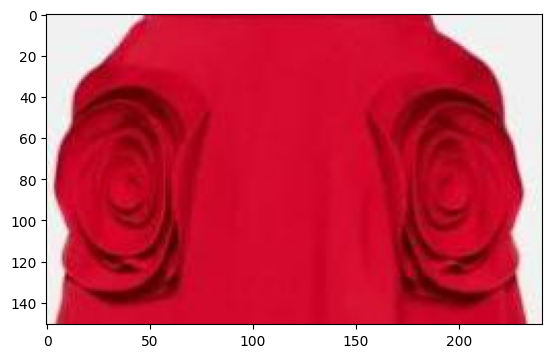

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/skirt137_jpeg_Hips_Breadth.jpg 3.0


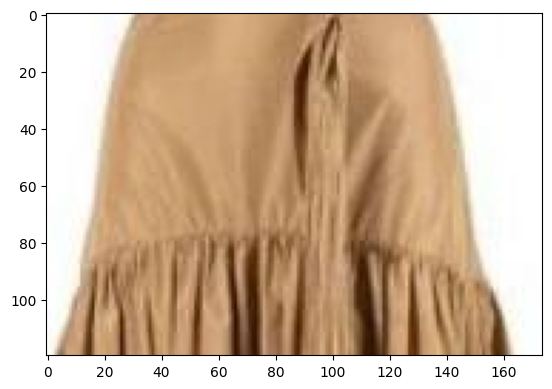

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/shorts129_jpeg_Hips_Breadth.jpg 3.0


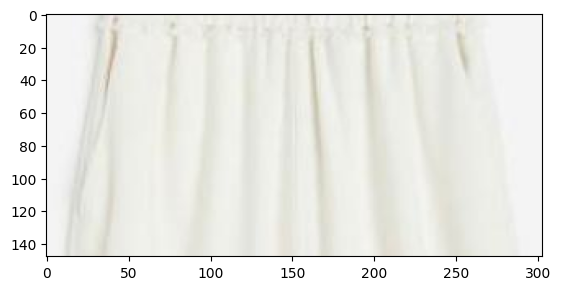

drive/MyDrive/ObjectDetection/SmartFashion/Regression/Data/train/imagesAnnotations/blank_image.jpg -1.0


KeyboardInterrupt: 

In [ ]:
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

print("LENGTH:  train test valid:  " + str(len(train)) + ", " + str(len(test)) + ", " + str(len(val)))


#print out data

print("train")
for index, row in train.iterrows():
    print(row["HB_image"], row["HB_classvalue"])
    image = Image.open(row["HB_image"])
    plt.imshow(image)
    plt.show()


##STEP 2.3 create numpy arrays of images and corresponding arrays of regression outputs (Shoulders_Breadth, Shoulders_Symmetry, Shoulders_Tone) using pandas DataFrame


### Step 2.3.1 load and resize images for training, testing and validation & load Regression values in corresponding order



*   ***input*** = pandas DataFrames train, test, val containing columns "filename" and "severity"

*   ***output*** = ***trainImages,testImage, validationImages*** :  **DICTIONARIES** of loaded images that are resized to IMAGE_SIZE (e.g. 224,224 )

*   ***output*** = ***trainShoulder_Breadth, trainShoulder_Symmetry, trainShoulder_Tone, testShoulder_Breadth, testShoulder_Symmetry, testnShoulder_Tone, validationShoulder_Breadth, validationShoulder_Symmetry, validationShoulder_Tone***,: **NUMPY ARRAYS** of corresponding regrestion values for the trainImages, testImages, etc.

*   ***output*** = **trainNumericData,testNumericData,validationNumericData** = **NUMPY ARRAYS** containing all of the numeric data which in this example are the bounding boxes of the whole person, and bounding boxes for the 3 regression values of Shoulder_Breadth, Shoulder_Symmetry and Shoulder_Tone for the training, testing and validaton data respectively


## **<mark>IMPORTANT NOTE</mark>**:  I take the image from Shoulders_Breadth as the image to use for the body part,  I don't want all three.**POTENTIAL ISSUE**by choosing one image it could be that other bounding boxes outside this image however, as long as I am not trying to do any drawing with this bounding box that is fine.  





In [ ]:
#TOGGLE This if you want to have the CNN layers be trainable or not
scale_data = True #@param {type:"boolean"}

In [ ]:
#PROCESS TRAINING DATA
# see https://datascience.stackexchange.com/questions/106600/how-to-perform-regression-on-image-data-using-tensorflow
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

#toggle betwee True and False if want to plot images + show info that are read in
#IMAGE_SIZE = (224, 224)
showInfo = False

#first define as dictionaries and lists as they can grow dynamically unlike arrays.
trainImagesND = {}
trainImagesSB = {}
trainImagesCB = {}
trainImagesWB = {}
trainImagesHB = {}
trainImagesLLB = {}
#trainImagesLL = {}
trainImagesUpLeftAB = {}
trainImagesUpRightAB = {}
trainImagesALeftL = {}
trainImagesARightL = {}


# Lists for measurements
trainNeckDepth = []
trainShoulderBreadth = []
trainChestBreadth = []
trainWaistBreadth = []
trainHipsBreadth = []
trainLegsBreadth = []
trainLegsLength = []
trainUpLeftArmBreadth = []
trainUpRightArmBreadth = []
trainArmL_Length = []
trainArmR_Length = []
trainNumericData = []

i=0
newsize = (IMAGE_SIZE, IMAGE_SIZE)

print("TRAIN Images")
for index, row in train.iterrows():
    # Append the measurements
    trainNeckDepth.append(row["ND_classvalue"])
    trainShoulderBreadth.append(row["SB_classvalue"])
    trainChestBreadth.append(row["CB_classvalue"])
    trainWaistBreadth.append(row["WB_classvalue"])
    trainHipsBreadth.append(row["HB_classvalue"])
    trainLegsBreadth.append(row["LB_classvalue"])
    trainLegsLength.append(row["LL_classvalue"])
    trainUpLeftArmBreadth.append(row["UpLeft_ArmBreadth_classvalue"])
    trainUpRightArmBreadth.append(row["UpRight_ArmBreadth_classvalue"])
    trainArmL_Length.append(row["ArmL_Length_classvalue"])
    trainArmR_Length.append(row["ArmR_Length_classvalue"])

    numericList = [
        row["xmin"], row["ymin"], row["xmax"], row["ymax"],
        row["xminND"], row["yminND"], row["xmaxND"], row["ymaxND"],
        row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],
        row["xminCB"], row["yminCB"], row["xmaxCB"], row["ymaxCB"],
        row["xminWB"], row["yminWB"], row["xmaxWB"], row["ymaxWB"],
        row["xminHB"], row["yminHB"], row["xmaxHB"], row["ymaxHB"],
        row["xminLB"], row["yminLB"], row["xmaxLB"], row["ymaxLB"],
        row["xminLL"], row["yminLL"], row["xmaxLL"], row["ymaxLL"],
        row["xminUpLeftAB"], row["yminUpLeftAB"], row["xmaxUpLeftAB"], row["ymaxUpLeftAB"],
        row["xminUpRightAB"], row["yminUpRightAB"], row["xmaxUpRightAB"], row["ymaxUpRightAB"],
        row["xminALeftL"], row["yminALeftL"], row["xmaxALeftL"], row["ymaxALeftL"],
        row["xminARightL"], row["yminARightL"], row["xmaxARightL"], row["ymaxARightL"]
    ]
    print(numericList)
    trainNumericData.append(np.array(numericList))

    # Process each type of measurement's image
    imgND = row["ND_image"]
    trainImagesND[i] = np.array(PIL.Image.open(imgND).resize(IMAGE_SIZE))

    imgSB = row["SB_image"]
    trainImagesSB[i] = np.array(PIL.Image.open(imgSB).resize(IMAGE_SIZE))

    imgCB = row["CB_image"]
    trainImagesCB[i] = np.array(PIL.Image.open(imgCB).resize(IMAGE_SIZE))

    imgWB = row["WB_image"]
    trainImagesWB[i] = np.array(PIL.Image.open(imgWB).resize(IMAGE_SIZE))

    imgHB = row["HB_image"]
    trainImagesHB[i] = np.array(PIL.Image.open(imgHB).resize(IMAGE_SIZE))

    imgLLB = row["LB_image"]
    trainImagesLLB[i] = np.array(PIL.Image.open(imgLLB).resize(IMAGE_SIZE))

    imgUpLeftAB = row["UpLeft_ArmBreadth_image"]
    trainImagesUpLeftAB[i] = np.array(PIL.Image.open(imgUpLeftAB).resize(IMAGE_SIZE))

    imgUpRightAB = row["UpRight_ArmBreadth_image"]
    trainImagesUpRightAB[i] = np.array(PIL.Image.open(imgUpRightAB).resize(IMAGE_SIZE))

    imgALeftL = row["ArmL_Length_image"]
    trainImagesALeftL[i] = np.array(PIL.Image.open(imgALeftL).resize(IMAGE_SIZE))

    imgARightL = row["ArmR_Length_image"]
    trainImagesARightL[i] = np.array(PIL.Image.open(imgARightL).resize(IMAGE_SIZE))

    if showInfo:
        plt.imshow(trainImagesND[i])
        plt.xlabel(f"(ND)= ({trainNeckDepth[i]})")
        plt.show()

        plt.imshow(trainImagesSB[i])
        plt.xlabel(f"(SB)= ({trainShoulderBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesCB[i])
        plt.xlabel(f"(CB)= ({trainChestBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesWB[i])
        plt.xlabel(f"(WB)= ({trainWaistBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesHB[i])
        plt.xlabel(f"(HB)= ({trainHipsBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesLLB[i])
        plt.xlabel("(LB,LL)= (" + str(trainLegsBreadth[i]) + "," + str(trainLegsLength[i]) + ")")
        plt.show()

        plt.imshow(trainImagesUpLeftAB[i])
        plt.xlabel(f"(UpLeftA)= ({trainUpLeftArmBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesUpRightAB[i])
        plt.xlabel(f"(UpRightAB)= ({trainUpRightArmBreadth[i]})")
        plt.show()

        plt.imshow(trainImagesALeftL[i])
        plt.xlabel(f"(ALeftL)= ({trainArmL_Length[i]})")
        plt.show()

        plt.imshow(trainImagesARightL[i])
        plt.xlabel(f"(ARighttL)= ({trainArmR_Length[i]})")
        plt.show()

    i += 1

if showInfo:
    plt.close()

trainNeckDepth = np.fromiter(trainNeckDepth, dtype=np.float32)
#print(trainShoulderBreadth)
trainShoulderBreadth = np.fromiter(trainShoulderBreadth, dtype=np.float32)
trainChestBreadth = np.fromiter(trainChestBreadth, dtype=np.float32)
trainWaistBreadth = np.fromiter(trainWaistBreadth, dtype=np.float32)
trainHipsBreadth = np.fromiter(trainHipsBreadth, dtype=np.float32)
trainLegsBreadth = np.fromiter(trainLegsBreadth, dtype=np.float32)
trainLegsLength = np.fromiter(trainLegsLength, dtype=np.float32)
trainUpLeftArmBreadth = np.fromiter(trainUpLeftArmBreadth, dtype=np.float32)
trainUpRightArmBreadth = np.fromiter(trainUpRightArmBreadth, dtype=np.float32)
trainArmL_Length = np.fromiter(trainArmL_Length, dtype=np.float32)
trainArmR_Length = np.fromiter(trainArmR_Length, dtype=np.float32)
trainNumericData = np.array(trainNumericData)

'''
print("TRAIN Images")
for index, row in train.iterrows():
    trainShoulder_Breadth.append(row["Shoulder_Breadth"])
    trainShoulder_Symmetry.append(row["Shoulder_Symmetry"])
    trainShoulder_Tone.append(row["Shoulder_Tone"])
    list = [row["xmin"], row["ymin"], row["xmax"], row["ymax"],
                    row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],
                    row["xminSS"], row["yminSS"], row["xmaxSS"], row["ymaxSS"],
                    row["xminST"], row["yminST"], row["xmaxST"], row["ymaxST"]]
    print(list)
    trainNumericData.append(np.array(list));

    img = row["filenameSB"]    #POTENTIAL ISSUE by choosing one image it could be that other bounding boxes outside this image
   # ax = plt.subplot(3, 3, i + 1)  # create a 3x3 grid
    trainImages[i]=np.array(PIL.Image.open(img).resize(IMAGE_SIZE))
    if showInfo : plt.imshow(trainImages[i])
    if showInfo : plt.xlabel("(b,s,t)= (" + str(trainShoulder_Breadth[i]) + "," + str(trainShoulder_Symmetry[i]) + "," + str(trainShoulder_Tone[i]) +")")
    if showInfo : plt.show()
    i = i+1

if showInfo : plt.close()

#convert lists to numpy arrays
print("trainShoulder_Breadth before conversion")
print(trainShoulder_Breadth)

print("trainShoulder_Breadth AFTER conversion")
trainShoulder_Breadth = np.fromiter(trainShoulder_Breadth, dtype=np.float32)
print(trainShoulder_Breadth)
trainShoulder_Symmetry = np.fromiter(trainShoulder_Symmetry, dtype=np.float32)
trainShoulder_Tone = np.fromiter(trainShoulder_Tone, dtype=np.float32)

print("Before Convert trainNumericData --still a list")
print(trainNumericData)
print("After Converstion trainNumericData to a numpy array")
trainNumericData = np.array(trainNumericData)
print(trainNumericData)
'''

TRAIN Images
[125.0, 94.0, 390.0, 549.0, 216.0, 99.0, 307.0, 285.0, 144.0, 117.0, 368.0, 202.0, 167.0, 193.0, 350.0, 288.0, 164.0, 275.0, 355.0, 366.0, 158.0, 353.0, 367.0, 464.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 319.0, 122.0, 380.0, 240.0, 136.0, 121.0, 198.0, 237.0, 322.0, 123.0, 383.0, 384.0, 134.0, 121.0, 185.0, 390.0]
[11.0, 108.0, 382.0, 528.0, 158.0, 119.0, 202.0, 146.0, 124.0, 124.0, 237.0, 149.0, 142.0, 155.0, 218.0, 199.0, 143.0, 182.0, 226.0, 236.0, 125.0, 206.0, 245.0, 267.0, 12.0, 259.0, 382.0, 534.0, 14.0, 265.0, 384.0, 530.0, 222.0, 133.0, 258.0, 190.0, 111.0, 119.0, 147.0, 200.0, 214.0, 121.0, 265.0, 269.0, 110.0, 132.0, 150.0, 272.0]
[154.0, 112.0, 355.0, 526.0, 219.0, 112.0, 293.0, 150.0, 184.0, 130.0, 338.0, 170.0, 195.0, 161.0, 319.0, 232.0, 186.0, 210.0, 323.0, 294.0, 177.0, 255.0, 335.0, 332.0, 158.0, 276.0, 354.0, 524.0, 154.0, 273.0, 350.0, 527.0, 294.0, 135.0, 359.0, 241.0, 167.0, 132.0, 215.0, 235.0, 304.0, 127.0, 355.0, 237.0, 166.0, 130.0, 212.0, 241.

'\nprint("TRAIN Images")\nfor index, row in train.iterrows():\n    trainShoulder_Breadth.append(row["Shoulder_Breadth"])\n    trainShoulder_Symmetry.append(row["Shoulder_Symmetry"])\n    trainShoulder_Tone.append(row["Shoulder_Tone"])\n    list = [row["xmin"], row["ymin"], row["xmax"], row["ymax"],\n                    row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],\n                    row["xminSS"], row["yminSS"], row["xmaxSS"], row["ymaxSS"],\n                    row["xminST"], row["yminST"], row["xmaxST"], row["ymaxST"]]\n    print(list)\n    trainNumericData.append(np.array(list));\n\n    img = row["filenameSB"]    #POTENTIAL ISSUE by choosing one image it could be that other bounding boxes outside this image\n   # ax = plt.subplot(3, 3, i + 1)  # create a 3x3 grid\n    trainImages[i]=np.array(PIL.Image.open(img).resize(IMAGE_SIZE))\n    if showInfo : plt.imshow(trainImages[i])\n    if showInfo : plt.xlabel("(b,s,t)= (" + str(trainShoulder_Breadth[i]) + "," + str(train

In [ ]:

print(trainNeckDepth)
print(trainShoulderBreadth)
print(trainChestBreadth)
print(trainWaistBreadth)
print(trainHipsBreadth)
print(trainLegsBreadth)
print(trainLegsLength)
print(trainUpLeftArmBreadth)
print(trainUpRightArmBreadth)
print(trainArmL_Length)
print(trainArmR_Length)
print("Numeric data After conversion")
print(trainNumericData)




[ 7.  3.  2. -1. -1.  6.  5. -1.  2.  6.  2.  6.  4.  3.  6. -1.  2.  5.
 -1.  5.  3. -1.  2. -1. -1.  3.  2.  3.  5. -1.  4.  7. -1. -1. -1.  3.
 -1. -1. -1.  8. -1. -1.  7. -1. -1.  3. -1. -1. -1. -1. -1. -1. -1.  3.
  6. -1.  5. -1. -1.  8. -1. -1.  7.  6. -1. -1.  2. -1.  4. -1. -1. -1.
 -1.  4.  4.  5. -1. -1.  3.  3.  6. -1. -1.  5.  4.  2. -1. -1. -1.  6.
  3.  3. -1.  5.  2.  8.  5. -1.  6.  3.  5. -1. -1.  2. -1.  1.  9.  4.
  2.  3. -1.  6.  2.  4.  2. -1.  8.  6.  5.  3. -1.  1.  9. -1. -1. -1.
 -1. -1. -1.  1.  3. -1. -1.  8.  3. -1.  3.  1. -1. -1. -1. -1.  3.  7.
  7.  5.  8.  2. -1. -1.  7.  5.  1.  4. -1.  3. -1.  5.  6.  1.  3. -1.
  2.  2. -1. -1.  2.  6.  4.  3. -1. -1. -1.  2. -1.  5.  1.  3. -1.  3.
  5.  2.  7. -1.  5. -1.  6. -1.  7. -1.  3.  3. -1. -1.  5.  3. -1. -1.
  1. -1. -1.  7.  1.  2. -1.  5. -1. -1. -1.  6. -1. -1.  6.  5.  3. -1.
  3.  4. -1. -1. -1.  5.  3. -1.  2.  7. -1. -1. -1. -1.  3. -1. -1. -1.
  7. -1.  7. -1. -1. -1. -1. -1. -1.  7. -1. -1.  7

In [ ]:
print("Numeric data After conversion")
print(trainNumericData)

Numeric data After conversion
[[125.  94. 390. ... 121. 185. 390.]
 [ 11. 108. 382. ... 132. 150. 272.]
 [154. 112. 355. ... 130. 212. 241.]
 ...
 [ 80.  32. 445. ... 117. 165. 607.]
 [107.  34. 320. ...   0.   0.   0.]
 [ 67.   4. 363. ...  14. 163.  82.]]


In [ ]:
#PROCESS TESTING DATA
# see https://datascience.stackexchange.com/questions/106600/how-to-perform-regression-on-image-data-using-tensorflow
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

#toggle betwee True and False if want to plot images + show info that are read in
#IMAGE_SIZE = (224, 224)
showInfo = False

#first define as dictionaries and lists as they can grow dynamically unlike arrays.
testImagesND = {}
testImagesSB = {}
testImagesCB = {}
testImagesWB = {}
testImagesHB = {}
testImagesLLB = {}
#testImagesLL = {}
testImagesUpLeftAB = {}
testImagesUpRightAB = {}
testImagesALeftL = {}
testImagesARightL = {}


# Lists for measurements
testNeckDepth = []
testShoulderBreadth = []
testChestBreadth = []
testWaistBreadth = []
testHipsBreadth = []
testLegsBreadth = []
testLegsLength = []
testUpLeftArmBreadth = []
testUpRightArmBreadth = []
testArmL_Length = []
testArmR_Length = []
testNumericData = []

i=0
newsize = (IMAGE_SIZE, IMAGE_SIZE)

print("TEST Images")
for index, row in test.iterrows():
    # Append the measurements
    testNeckDepth.append(row["ND_classvalue"])
    testShoulderBreadth.append(row["SB_classvalue"])
    testChestBreadth.append(row["CB_classvalue"])
    testWaistBreadth.append(row["WB_classvalue"])
    testHipsBreadth.append(row["HB_classvalue"])
    testLegsBreadth.append(row["LB_classvalue"])
    testLegsLength.append(row["LL_classvalue"])
    testUpLeftArmBreadth.append(row["UpLeft_ArmBreadth_classvalue"])
    testUpRightArmBreadth.append(row["UpRight_ArmBreadth_classvalue"])
    testArmL_Length.append(row["ArmL_Length_classvalue"])
    testArmR_Length.append(row["ArmR_Length_classvalue"])

    numericListt = [
        row["xmin"], row["ymin"], row["xmax"], row["ymax"],
        row["xminND"], row["yminND"], row["xmaxND"], row["ymaxND"],
        row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],
        row["xminCB"], row["yminCB"], row["xmaxCB"], row["ymaxCB"],
        row["xminWB"], row["yminWB"], row["xmaxWB"], row["ymaxWB"],
        row["xminHB"], row["yminHB"], row["xmaxHB"], row["ymaxHB"],
        row["xminLB"], row["yminLB"], row["xmaxLB"], row["ymaxLB"],
        row["xminLL"], row["yminLL"], row["xmaxLL"], row["ymaxLL"],
        row["xminUpLeftAB"], row["yminUpLeftAB"], row["xmaxUpLeftAB"], row["ymaxUpLeftAB"],
        row["xminUpRightAB"], row["yminUpRightAB"], row["xmaxUpRightAB"], row["ymaxUpRightAB"],
        row["xminALeftL"], row["yminALeftL"], row["xmaxALeftL"], row["ymaxALeftL"],
        row["xminARightL"], row["yminARightL"], row["xmaxARightL"], row["ymaxARightL"]
    ]
    print(numericListt)
    testNumericData.append(np.array(numericListt))

    # Process each type of measurement's image
    imgNDt = row["ND_image"]
    testImagesND[i] = np.array(PIL.Image.open(imgNDt).resize(IMAGE_SIZE))

    imgSBt = row["SB_image"]
    testImagesSB[i] = np.array(PIL.Image.open(imgSBt).resize(IMAGE_SIZE))

    imgCBt = row["CB_image"]
    testImagesCB[i] = np.array(PIL.Image.open(imgCBt).resize(IMAGE_SIZE))

    imgWBt = row["WB_image"]
    testImagesWB[i] = np.array(PIL.Image.open(imgWBt).resize(IMAGE_SIZE))

    imgHBt = row["HB_image"]
    testImagesHB[i] = np.array(PIL.Image.open(imgHBt).resize(IMAGE_SIZE))

    imgLLBt = row["LB_image"]
    testImagesLLB[i] = np.array(PIL.Image.open(imgLLBt).resize(IMAGE_SIZE))

    imgUpLeftABt = row["UpLeft_ArmBreadth_image"]
    testImagesUpLeftAB[i] = np.array(PIL.Image.open(imgUpLeftABt).resize(IMAGE_SIZE))

    imgUpRightABt = row["UpRight_ArmBreadth_image"]
    testImagesUpRightAB[i] = np.array(PIL.Image.open(imgUpRightABt).resize(IMAGE_SIZE))

    imgALeftLt = row["ArmL_Length_image"]
    testImagesALeftL[i] = np.array(PIL.Image.open(imgALeftLt).resize(IMAGE_SIZE))

    imgARightLt = row["ArmR_Length_image"]
    testImagesARightL[i] = np.array(PIL.Image.open(imgARightLt).resize(IMAGE_SIZE))

    if showInfo:
        plt.imshow(testImagesND[i])
        plt.xlabel(f"(ND)= ({testNeckDepth[i]})")
        plt.show()

        plt.imshow(testImagesSB[i])
        plt.xlabel(f"(SB)= ({testShoulderBreadth[i]})")
        plt.show()

        plt.imshow(testImagesCB[i])
        plt.xlabel(f"(CB)= ({testChestBreadth[i]})")
        plt.show()

        plt.imshow(testImagesWB[i])
        plt.xlabel(f"(WB)= ({testWaistBreadth[i]})")
        plt.show()

        plt.imshow(testImagesHB[i])
        plt.xlabel(f"(HB)= ({testHipsBreadth[i]})")
        plt.show()

        plt.imshow(testImagesLLB[i])
        plt.xlabel("(LB,LL)= (" + str(testLegsBreadth[i]) + "," + str(testLegsLength[i]) + ")")
        plt.show()

        plt.imshow(testImagesUpLeftAB[i])
        plt.xlabel(f"(UpLeftA)= ({testUpLeftArmBreadth[i]})")
        plt.show()

        plt.imshow(testImagesUpRightAB[i])
        plt.xlabel(f"(UpRightAB)= ({testUpRightArmBreadth[i]})")
        plt.show()

        plt.imshow(testImagesALeftL[i])
        plt.xlabel(f"(ALeftL)= ({testArmL_Length[i]})")
        plt.show()

        plt.imshow(testImagesARightL[i])
        plt.xlabel(f"(ARighttL)= ({testArmR_Length[i]})")
        plt.show()

    i += 1

if showInfo:
    plt.close()

#convert lists to numpy arrays
print("testNeckDepth before conversion")
print(testNeckDepth)
print("testNeckDepth AFTER conversion")
testNeckDepth = np.fromiter(testNeckDepth, dtype=np.float32)
print(testNeckDepth)

print("testShoulderBreadth before conversion")
print(testShoulderBreadth)
print("testShoulderBreadth AFTER conversion")
testShoulderBreadth = np.fromiter(testShoulderBreadth, dtype=np.float32)
print(testShoulderBreadth)

print("testChestBreadth before conversion")
print(testChestBreadth)
print("testChestBreadth AFTER conversion")
testChestBreadth = np.fromiter(testChestBreadth, dtype=np.float32)
print(testChestBreadth)

print("testWaistBreadth before conversion")
print(testWaistBreadth)
print("testWaistBreadth AFTER conversion")
testWaistBreadth = np.fromiter(testWaistBreadth, dtype=np.float32)
print(testWaistBreadth)

print("testHipsBreadth before conversion")
print(testHipsBreadth)
print("testHipsBreadth AFTER conversion")
testHipsBreadth = np.fromiter(testHipsBreadth, dtype=np.float32)
print(testHipsBreadth)

print("testLegsBreadth before conversion")
print(testLegsBreadth)
print("testLegsBreadth AFTER conversion")
testLegsBreadth = np.fromiter(testLegsBreadth, dtype=np.float32)
print(testLegsBreadth)

print("testLegsLength before conversion")
print(testLegsLength)
print("testLegsLength AFTER conversion")
testLegsLength = np.fromiter(testLegsLength, dtype=np.float32)
print(testLegsLength)

print("testUpLeftArmBreadth before conversion")
print(testUpLeftArmBreadth)
print("testUpLeftArmBreadth AFTER conversion")
testUpLeftArmBreadth = np.fromiter(testUpLeftArmBreadth, dtype=np.float32)
print(testUpLeftArmBreadth)

print("testUpRightArmBreadth before conversion")
print(testUpRightArmBreadth)
print("testUpRightArmBreadth AFTER conversion")
testUpRightArmBreadth = np.fromiter(testUpRightArmBreadth, dtype=np.float32)
print(testUpRightArmBreadth)

print("testArmL_Length before conversion")
print(testArmL_Length)
print("testArmL_Length AFTER conversion")
testArmL_Length = np.fromiter(testArmL_Length, dtype=np.float32)
print(testArmL_Length)

print("testArmR_Length before conversion")
print(testArmR_Length)
print("testArmR_Length AFTER conversion")
testArmR_Length = np.fromiter(testArmR_Length, dtype=np.float32)
print(testArmR_Length)

print("Before Convert testNumericData --still a list")
print(testNumericData)
print("After Converstion testNumericData to a numpy array")
testNumericData = np.array(testNumericData)
print(testNumericData)

TEST Images
[29.0, 43.0, 530.0, 518.0, 229.0, 42.0, 330.0, 142.0, 119.0, 84.0, 444.0, 187.0, 151.0, 149.0, 403.0, 276.0, 140.0, 228.0, 406.0, 359.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 351.0, 95.0, 493.0, 336.0, 67.0, 98.0, 210.0, 322.0, 353.0, 82.0, 531.0, 493.0, 31.0, 88.0, 182.0, 500.0]
[49.0, 47.0, 281.0, 588.0, 108.0, 49.0, 232.0, 174.0, 57.0, 42.0, 295.0, 122.0, 84.0, 115.0, 273.0, 201.0, 81.0, 141.0, 266.0, 238.0, 77.0, 189.0, 260.0, 294.0, 59.0, 272.0, 278.0, 596.0, 50.0, 266.0, 277.0, 607.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 221.0, 56.0, 279.0, 166.0, 55.0, 60.0, 116.0, 175.0]
[43.0, 0.0, 453.0, 634.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 69.0, 31.0, 442.0, 201.0, 45.0, 131.0, 458.0, 640.0, 47.0, 137.0, 455.0, 638.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[21.0, 80.0, 413.0, 561.0, 158.0, 95.0, 273.0, 200.0, 74.0, 97.0, 360.0, 179.0, 99.0, 193.0, 329.0, 304.0, 93.0

In [ ]:
#PROCESS VALIDATION DATA
# see https://datascience.stackexchange.com/questions/106600/how-to-perform-regression-on-image-data-using-tensorflow
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

#toggle betwee True and False if want to plot images + show info that are read in
#IMAGE_SIZE = (224, 224)
showInfo = False

#first define as dictionaries and lists as they can grow dynamically unlike arrays.
validationImagesND = {}
validationImagesSB = {}
validationImagesCB = {}
validationImagesWB = {}
validationImagesHB = {}
validationImagesLLB = {}
#validationImagesLL = {}
validationImagesUpLeftAB = {}
validationImagesUpRightAB = {}
validationImagesALeftL = {}
validationImagesARightL = {}


# Lists for measurements
validationNeckDepth = []
validationShoulderBreadth = []
validationChestBreadth = []
validationWaistBreadth = []
validationHipsBreadth = []
validationLegsBreadth = []
validationLegsLength = []
validationUpLeftArmBreadth = []
validationUpRightArmBreadth = []
validationArmL_Length = []
validationArmR_Length = []
validationNumericData = []

i=0
newsize = (IMAGE_SIZE, IMAGE_SIZE)

print("VALIDATION Images")
for index, row in val.iterrows():
    # Append the measurements
    validationNeckDepth.append(row["ND_classvalue"])
    validationShoulderBreadth.append(row["SB_classvalue"])
    validationChestBreadth.append(row["CB_classvalue"])
    validationWaistBreadth.append(row["WB_classvalue"])
    validationHipsBreadth.append(row["HB_classvalue"])
    validationLegsBreadth.append(row["LB_classvalue"])
    validationLegsLength.append(row["LL_classvalue"])
    validationUpLeftArmBreadth.append(row["UpLeft_ArmBreadth_classvalue"])
    validationUpRightArmBreadth.append(row["UpRight_ArmBreadth_classvalue"])
    validationArmL_Length.append(row["ArmL_Length_classvalue"])
    validationArmR_Length.append(row["ArmR_Length_classvalue"])

    numericListv = [
        row["xmin"], row["ymin"], row["xmax"], row["ymax"],
        row["xminND"], row["yminND"], row["xmaxND"], row["ymaxND"],
        row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],
        row["xminCB"], row["yminCB"], row["xmaxCB"], row["ymaxCB"],
        row["xminWB"], row["yminWB"], row["xmaxWB"], row["ymaxWB"],
        row["xminHB"], row["yminHB"], row["xmaxHB"], row["ymaxHB"],
        row["xminLB"], row["yminLB"], row["xmaxLB"], row["ymaxLB"],
        row["xminLL"], row["yminLL"], row["xmaxLL"], row["ymaxLL"],
        row["xminUpLeftAB"], row["yminUpLeftAB"], row["xmaxUpLeftAB"], row["ymaxUpLeftAB"],
        row["xminUpRightAB"], row["yminUpRightAB"], row["xmaxUpRightAB"], row["ymaxUpRightAB"],
        row["xminALeftL"], row["yminALeftL"], row["xmaxALeftL"], row["ymaxALeftL"],
        row["xminARightL"], row["yminARightL"], row["xmaxARightL"], row["ymaxARightL"]
    ]
    print(numericListv)
    validationNumericData.append(np.array(numericListv))

    # Process each type of measurement's image
    imgNDv = row["ND_image"]
    validationImagesND[i] = np.array(PIL.Image.open(imgNDv).resize(IMAGE_SIZE))

    imgSBv = row["SB_image"]
    validationImagesSB[i] = np.array(PIL.Image.open(imgSBv).resize(IMAGE_SIZE))

    imgCBv = row["CB_image"]
    validationImagesCB[i] = np.array(PIL.Image.open(imgCBv).resize(IMAGE_SIZE))

    imgWBv = row["WB_image"]
    validationImagesWB[i] = np.array(PIL.Image.open(imgWBv).resize(IMAGE_SIZE))

    imgHBv = row["HB_image"]
    validationImagesHB[i] = np.array(PIL.Image.open(imgHBv).resize(IMAGE_SIZE))

    imgLLBv = row["LB_image"]
    validationImagesLLB[i] = np.array(PIL.Image.open(imgLLBv).resize(IMAGE_SIZE))

    imgUpLeftABv = row["UpLeft_ArmBreadth_image"]
    validationImagesUpLeftAB[i] = np.array(PIL.Image.open(imgUpLeftABv).resize(IMAGE_SIZE))

    imgUpRightABv = row["UpRight_ArmBreadth_image"]
    validationImagesUpRightAB[i] = np.array(PIL.Image.open(imgUpRightABv).resize(IMAGE_SIZE))

    imgALeftLv = row["ArmL_Length_image"]
    validationImagesALeftL[i] = np.array(PIL.Image.open(imgALeftLv).resize(IMAGE_SIZE))

    imgARightLv = row["ArmR_Length_image"]
    validationImagesARightL[i] = np.array(PIL.Image.open(imgARightLv).resize(IMAGE_SIZE))

    if showInfo:
        plt.imshow(validationImagesND[i])
        plt.xlabel(f"(ND)= ({validationNeckDepth[i]})")
        plt.show()

        plt.imshow(validationImagesSB[i])
        plt.xlabel(f"(SB)= ({validationShoulderBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesCB[i])
        plt.xlabel(f"(CB)= ({validationChestBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesWB[i])
        plt.xlabel(f"(WB)= ({validationWaistBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesHB[i])
        plt.xlabel(f"(HB)= ({validationHipsBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesLLB[i])
        plt.xlabel("(LB,LL)= (" + str(validationLegsBreadth[i]) + "," + str(validationLegsLength[i]) + ")")
        plt.show()

        plt.imshow(validationImagesUpLeftAB[i])
        plt.xlabel(f"(UpLeftA)= ({validationUpLeftArmBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesUpRightAB[i])
        plt.xlabel(f"(UpRightAB)= ({validationUpRightArmBreadth[i]})")
        plt.show()

        plt.imshow(validationImagesALeftL[i])
        plt.xlabel(f"(ALeftL)= ({validationArmL_Length[i]})")
        plt.show()

        plt.imshow(validationImagesARightL[i])
        plt.xlabel(f"(ARighttL)= ({validationArmR_Length[i]})")
        plt.show()

    i += 1

if showInfo:
    plt.close()

#convert lists to numpy arrays
print("validationNeckDepth before conversion")
print(validationNeckDepth)
print("validationNeckDepth AFTER conversion")
validationNeckDepth = np.fromiter(validationNeckDepth, dtype=np.float32)
print(validationNeckDepth)

print("validationShoulderBreadth before conversion")
print(validationShoulderBreadth)
print("validationShoulderBreadth AFTER conversion")
validationShoulderBreadth = np.fromiter(validationShoulderBreadth, dtype=np.float32)
print(validationShoulderBreadth)

print("validationChestBreadth before conversion")
print(validationChestBreadth)
print("validationChestBreadth AFTER conversion")
validationChestBreadth = np.fromiter(validationChestBreadth, dtype=np.float32)
print(validationChestBreadth)

print("validationWaistBreadth before conversion")
print(validationWaistBreadth)
print("validationWaistBreadth AFTER conversion")
validationWaistBreadth = np.fromiter(validationWaistBreadth, dtype=np.float32)
print(validationWaistBreadth)

print("validationHipsBreadth before conversion")
print(validationHipsBreadth)
print("validationHipsBreadth AFTER conversion")
validationHipsBreadth = np.fromiter(validationHipsBreadth, dtype=np.float32)
print(validationHipsBreadth)

print("validationLegsBreadth before conversion")
print(validationLegsBreadth)
print("validationLegsBreadth AFTER conversion")
validationLegsBreadth = np.fromiter(validationLegsBreadth, dtype=np.float32)
print(validationLegsBreadth)

print("validationLegsLength before conversion")
print(validationLegsLength)
print("validationLegsLength AFTER conversion")
validationLegsLength = np.fromiter(validationLegsLength, dtype=np.float32)
print(validationLegsLength)

print("validationUpLeftArmBreadth before conversion")
print(validationUpLeftArmBreadth)
print("validationUpLeftArmBreadth AFTER conversion")
validationUpLeftArmBreadth = np.fromiter(validationUpLeftArmBreadth, dtype=np.float32)
print(validationUpLeftArmBreadth)

print("validationUpRightArmBreadth before conversion")
print(validationUpRightArmBreadth)
print("validationUpRightArmBreadth AFTER conversion")
validationUpRightArmBreadth = np.fromiter(validationUpRightArmBreadth, dtype=np.float32)
print(validationUpRightArmBreadth)

print("validationArmL_Length before conversion")
print(validationArmL_Length)
print("validationArmL_Length AFTER conversion")
validationArmL_Length = np.fromiter(validationArmL_Length, dtype=np.float32)
print(validationArmL_Length)

print("validationArmR_Length before conversion")
print(validationArmR_Length)
print("testArmR_Length AFTER conversion")
validationArmR_Length = np.fromiter(validationArmR_Length, dtype=np.float32)
print(validationArmR_Length)

print("Before Convert validationNumericData --still a list")
print(validationNumericData)
print("After Converstion validationNumericData to a numpy array")
validationNumericData = np.array(validationNumericData)
print(validationNumericData)

VALIDATION Images
[146.0, 33.0, 366.0, 595.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 171.0, 80.0, 335.0, 184.0, 152.0, 120.0, 355.0, 590.0, 159.0, 126.0, 367.0, 598.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[74.0, 115.0, 450.0, 559.0, 181.0, 119.0, 328.0, 175.0, 126.0, 120.0, 387.0, 195.0, 158.0, 201.0, 357.0, 334.0, 154.0, 305.0, 360.0, 410.0, 137.0, 367.0, 378.0, 479.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 344.0, 131.0, 417.0, 320.0, 105.0, 128.0, 188.0, 306.0, 336.0, 133.0, 428.0, 539.0, 87.0, 128.0, 166.0, 527.0]
[31.0, 1.0, 264.0, 520.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49.0, 29.0, 251.0, 167.0, 31.0, 71.0, 264.0, 517.0, 33.0, 76.0, 263.0, 520.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[18.0, 3.0, 492.0, 633.0, 195.0, 3.0, 320.0, 158.0, 74.0, 50.0, 443.0, 160.0, 119.0, 184.0, 403.0, 311.0, 119.0, 279.0, 408.0, 4

/content/drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/train/gril6Shoulders.jpg













### **Step 2.3.2  package images into numpy arrays of 2D numpy arrays  for input for training, validation and testing**



*  input =  trainImages,testImages & validationImages , dictionaries of images
*  ouptupt = nparrays of float32 called trainImageData, testImageData and validationImageData

#### **NOTE:**
* EfficientNet expects int as input, as it automatically does the conversion to float and rescale to 0-1.0 see https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet/EfficientNetB0

* HOWEVER my model below puts an input layer in front of the EfficientNEt model so that takes as input float32 values by default so in this block I convert to float32 only.  


In [ ]:
#convert image dictionaries into numpy array of 2D arrays

trainImagesNDData = np.array([each for each in trainImagesND.values()]).astype(np.float32)
trainImagesSBData = np.array([each for each in trainImagesSB.values()]).astype(np.float32)
trainImagesCBData = np.array([each for each in trainImagesCB.values()]).astype(np.float32)
trainImagesWBData = np.array([each for each in trainImagesWB.values()]).astype(np.float32)
trainImagesHBData = np.array([each for each in trainImagesHB.values()]).astype(np.float32)
trainImagesLLBData = np.array([each for each in trainImagesLLB.values()]).astype(np.float32)
trainImagesUpLeftABData = np.array([each for each in trainImagesUpLeftAB.values()]).astype(np.float32)
trainImagesUpRightABData = np.array([each for each in trainImagesUpRightAB.values()]).astype(np.float32)
trainImagesALeftLData = np.array([each for each in trainImagesALeftL.values()]).astype(np.float32)
trainImagesARightLData = np.array([each for each in trainImagesARightL.values()]).astype(np.float32)


validationImagesNDData = np.array([each for each in validationImagesND.values()]).astype(np.float32)
validationImagesSBData = np.array([each for each in validationImagesSB.values()]).astype(np.float32)
validationImagesCBData = np.array([each for each in validationImagesCB.values()]).astype(np.float32)
validationImagesWBData = np.array([each for each in validationImagesWB.values()]).astype(np.float32)
validationImagesHBData = np.array([each for each in validationImagesHB.values()]).astype(np.float32)
validationImagesLLBData = np.array([each for each in validationImagesLLB.values()]).astype(np.float32)
validationImagesUpLeftABData = np.array([each for each in validationImagesUpLeftAB.values()]).astype(np.float32)
validationImagesUpRightABData = np.array([each for each in validationImagesUpRightAB.values()]).astype(np.float32)
validationImagesALeftLData = np.array([each for each in validationImagesALeftL.values()]).astype(np.float32)
validationImagesARightLData = np.array([each for each in validationImagesARightL.values()]).astype(np.float32)


testImagesNDData = np.array([each for each in testImagesND.values()]).astype(np.float32)
testImagesSBData = np.array([each for each in testImagesSB.values()]).astype(np.float32)
testImagesCBData = np.array([each for each in testImagesCB.values()]).astype(np.float32)
testImagesWBData = np.array([each for each in testImagesWB.values()]).astype(np.float32)
testImagesHBData = np.array([each for each in testImagesHB.values()]).astype(np.float32)
testImagesLLBData = np.array([each for each in testImagesLLB.values()]).astype(np.float32)
testImagesUpLeftABData = np.array([each for each in testImagesUpLeftAB.values()]).astype(np.float32)
testImagesUpRightABData = np.array([each for each in testImagesUpRightAB.values()]).astype(np.float32)
testImagesALeftLData = np.array([each for each in testImagesALeftL.values()]).astype(np.float32)
testImagesARightLData = np.array([each for each in testImagesARightL.values()]).astype(np.float32)


#trainImageData = np.array([each for each in trainImages.values()]).astype(np.float32)
#validationImageData = np.array([each for each in validationImages.values()]).astype(np.float32)
#testImageData = np.array([each for each in testImages.values()]).astype(np.float32)

In [ ]:
print("number train images " + str(testImagesNDData.shape[0]))
print(testImagesNDData)

number train images 108
[[[[232. 232. 232.]
   [232. 232. 232.]
   [232. 232. 232.]
   ...
   [233. 233. 233.]
   [233. 233. 233.]
   [233. 233. 233.]]

  [[232. 232. 232.]
   [232. 232. 232.]
   [232. 232. 232.]
   ...
   [233. 233. 233.]
   [233. 233. 233.]
   [233. 233. 233.]]

  [[232. 232. 232.]
   [232. 232. 232.]
   [232. 232. 232.]
   ...
   [233. 233. 233.]
   [233. 233. 233.]
   [233. 233. 233.]]

  ...

  [[175.  58. 102.]
   [175.  58. 102.]
   [176.  58. 102.]
   ...
   [156.  50.  88.]
   [155.  49.  87.]
   [155.  49.  87.]]

  [[175.  58. 102.]
   [175.  58. 102.]
   [176.  58. 102.]
   ...
   [156.  50.  88.]
   [156.  50.  88.]
   [156.  50.  88.]]

  [[175.  58. 102.]
   [175.  58. 102.]
   [176.  58. 102.]
   ...
   [156.  50.  88.]
   [156.  50.  88.]
   [156.  50.  88.]]]


 [[[236. 230. 242.]
   [236. 230. 242.]
   [235. 229. 241.]
   ...
   [234. 234. 236.]
   [234. 234. 236.]
   [234. 234. 236.]]

  [[237. 231. 242.]
   [237. 231. 242.]
   [236. 230. 241.]
   .

### **Step 2.3.2  package regression value arrays into float based numpy arrays for input numerical data for training, validation and testing**



*  input =  trainShould_Breadth(,testShoulder_Breadth & validationShoulder_Breadth, ETC.(Symmetry and Tone too) as Numpy Arrays of Ints
*  ouptupt = nparrays of float32 called trainShoulder_Breadth, testSeverity and validationSeverity (Symmetry and Tone too)
*  output = **trainAllRegressionData**(also testAllRegressionData & validationAllRegressionData for test and validation data)  = an array of arrays = [[SB1, SS1, ST1], [SB2, SS2, ST2], ....]    where SBi = Shoulders_Breadth for sample i, SSi = Shoulders_Symmetry for sample i,  STi = Shoulder_Tone for sample i.    An example:

```
[[5. 3. 5.]
 [5. 5. 4.]
 [3. 5. 3.]
 [3. 5. 5.]
 [9. 7. 7.]
 [3. 7. 7.]
 [5. 5. 5.]
 [5. 5. 5.]]
```



In [ ]:
#now setup train and test arrays to be nparrays of float32 from the *Shoulder_Breadth,*Shoulder_Symmetry, *Shoulder_Tone (i.e. trainShoulder_Breadth) from numpy arrays created above

#trainNeckDepth = np.fromiter(trainNeckDepth, dtype=np.float32)
#print(trainShoulder_Breadth)
#trainShoulder_Symmetry = np.fromiter(trainShoulder_Symmetry, dtype=np.float32)
#print(trainShoulder_Symmetry)
#trainShoulder_Tone = np.fromiter(trainShoulder_Tone, dtype=np.float32)
#print(trainShoulder_Tone)

#now for test data
#testShoulder_Breadth = np.fromiter(testShoulder_Breadth, dtype=np.float32)
#print(testShoulder_Breadth)
#testShoulder_Symmetry = np.fromiter(testShoulder_Symmetry, dtype=np.float32)
#print(testShoulder_Symmetry)
#testShoulder_Tone = np.fromiter(testShoulder_Tone, dtype=np.float32)
#print(testShoulder_Tone)


#now for validation data
#validationShoulder_Breadth = np.fromiter(validationShoulder_Breadth, dtype=np.float32)
#print(validationShoulder_Breadth)
#validationShoulder_Symmetry = np.fromiter(validationShoulder_Symmetry, dtype=np.float32)
#print(validationShoulder_Symmetry)
#validationShoulder_Tone = np.fromiter(validationShoulder_Tone, dtype=np.float32)
#print(validationShoulder_Tone)


#Now create single array where each element has the regression values {Shoulder_Breadth, Shoulder_Symmetry, Shoulder_Tone}
# in that order using numpy.stack
trainAllRegressionData = np.stack((trainNeckDepth, trainShoulderBreadth,trainChestBreadth, trainWaistBreadth, trainHipsBreadth, trainLegsBreadth, trainLegsLength,trainUpLeftArmBreadth, trainUpRightArmBreadth, trainArmL_Length, trainArmR_Length), axis=1)
print("train ALL Regression Data as a numpy array")
print(trainAllRegressionData)

testAllRegressionData = np.stack((testNeckDepth, testShoulderBreadth,testChestBreadth, testWaistBreadth, testHipsBreadth, testLegsBreadth, testLegsLength,testUpLeftArmBreadth, testUpRightArmBreadth, testArmL_Length, testArmR_Length), axis=1)
print("test ALL Regression Data as a numpy array")
print(testAllRegressionData)

validationAllRegressionData = np.stack((validationNeckDepth, validationShoulderBreadth,validationChestBreadth, validationWaistBreadth, validationHipsBreadth, validationLegsBreadth, validationLegsLength,validationUpLeftArmBreadth, validationUpRightArmBreadth, validationArmL_Length, validationArmR_Length), axis=1)
print("validation ALL Regression Data as a numpy array")
print(validationAllRegressionData)


train ALL Regression Data as a numpy array
[[ 7.  6.  6. ...  6.  8.  8.]
 [ 3.  5.  3. ...  1.  7.  7.]
 [ 2.  3.  4. ...  1.  4.  4.]
 ...
 [ 1.  5.  5. ...  5.  9.  9.]
 [-1. -1. -1. ... -1. -1. -1.]
 [ 5.  1.  7. ...  1.  1.  1.]]
test ALL Regression Data as a numpy array
[[ 3.  3.  4. ...  5.  7.  7.]
 [ 7.  1.  2. ... -1.  1.  1.]
 [-1. -1. -1. ... -1. -1. -1.]
 ...
 [-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 [ 3.  2.  3. ...  2.  2.  2.]]
validation ALL Regression Data as a numpy array
[[-1. -1. -1. ... -1. -1. -1.]
 [ 4.  5.  4. ...  5.  8.  8.]
 [-1. -1. -1. ... -1. -1. -1.]
 ...
 [ 6. -1.  1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 [ 3.  2.  8. ...  6.  8.  8.]]


# **STEP 3: *Defining* the model**

**All it takes is to put a SINGLE dense layer (1D for output predictions from regression) on top of the `feature_extractor_layer` with the Hub module.**

For speed, we start out with a non-trainable `feature_extractor_layer`, but you can also enable fine-tuning for greater accuracy.


This is the model that will will create - One input is the image and the other is the numeric data input in the following order:

*  (**4x4=12 elements**):
1.   bounding box whole person,
2.   bounding box for Shoulders_Breadth,
3.   bounding box for Shoulders_Symmetry
4.   bounding box for Shoulders_Tone

= *{xmin, ymin, xmax, ymax, xminSB, yminSB, xmaxSB,ymaxSB, xminSS, yminSS, xmaxSS, ymaxSS, xminST, yminST, xmaxST, ymaxST}*
*   where SB = indicates for Shoulders_Breadth, SS= indicates for ShouldersSymmetry, ST = indicates for ShouldersTone

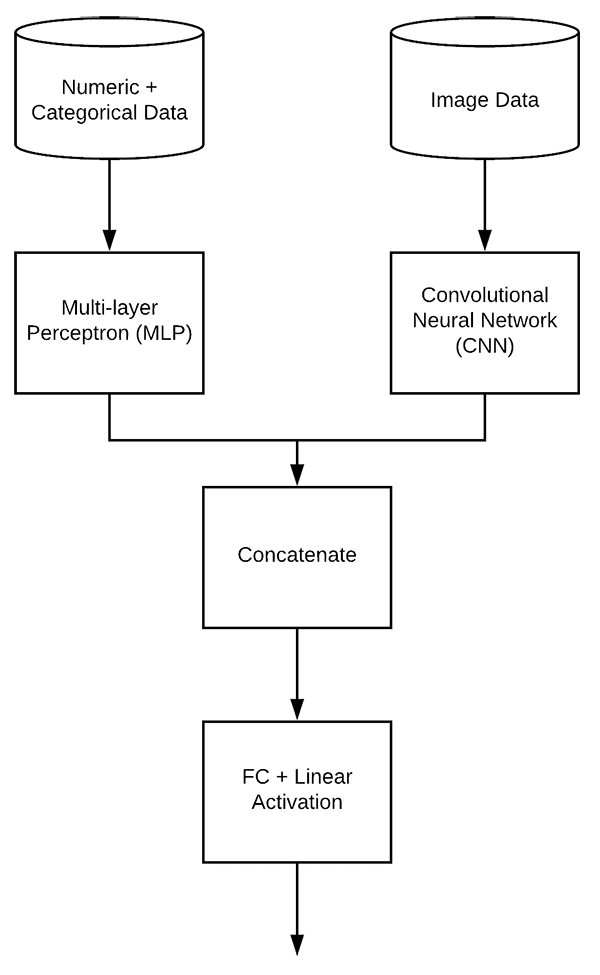

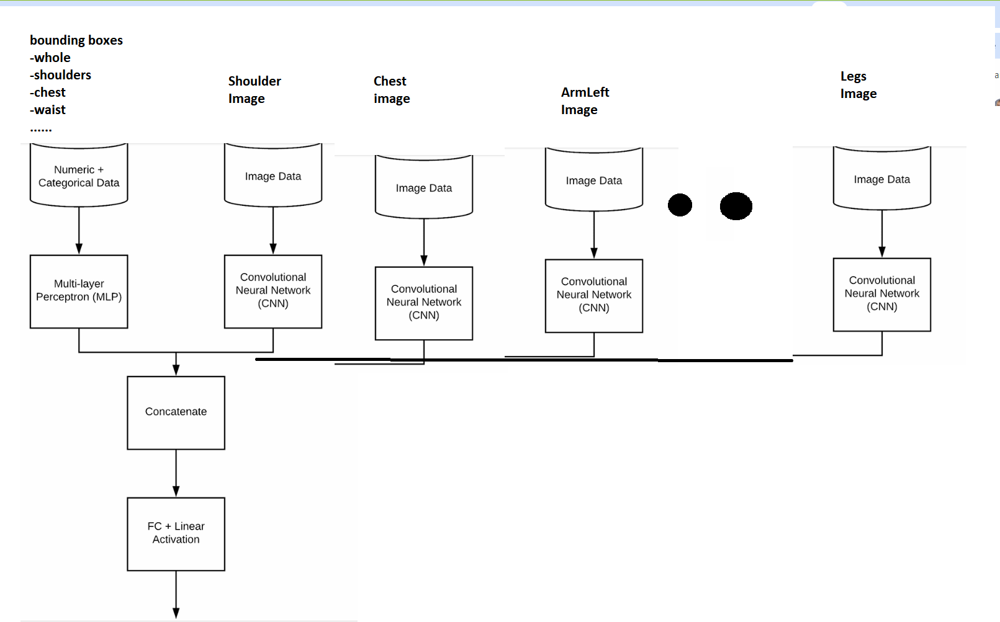

In [ ]:
#TOGGLE This if you want to have the CNN layers be trainable or not
do_fine_tuning = True #@param {type:"boolean"}

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import concatenate
from tensorflow.keras.regularizers import l2

## **Step 3.0 Define the output regression vector for the model**

In [ ]:
print("\n\n\n\n")

#trainNeckDepth, trainShoulderBreadth,trainChestBreadth, trainWaistBreadth, trainHipsBreadth, trainLegsBreadth, trainLegsLength,trainUpLeftArmBreadth, trainUpRightArmBreadth, trainArmL_Length, trainArmR_Length

output_order=["Neck_Depth", "Shoulder_Breadth", "Chest_Breadth", "Waist_Breadth", "Hips_Breadth", "Legs_Breadth", "Legs_Length", "UpperArmLeft_Breadth", "UpperArmRight_Breadth", "ArmLeft_Length", "ArmRight_Length"]
output_dimension = len(output_order)
print(" Length of first sample  trainAllRegressionData[0] =" + str(len(trainAllRegressionData[0])))
print("output dimension is " + str(output_dimension))
print(output_order)






 Length of first sample  trainAllRegressionData[0] =11
output dimension is 11
['Neck_Depth', 'Shoulder_Breadth', 'Chest_Breadth', 'Waist_Breadth', 'Hips_Breadth', 'Legs_Breadth', 'Legs_Length', 'UpperArmLeft_Breadth', 'UpperArmRight_Breadth', 'ArmLeft_Length', 'ArmRight_Length']


## **Step 3.1 Define function to create the DataProcessing Branch dataMLP**

In [ ]:
#define the dimension of input data
# Whole,ND(neck depth), SB(shoulder breadth), CB(chest breadth), WB (waist Breadth), HB (hips breadth),
# LB (legs breadth), LL (legs length), UpperLeftAB (Upper Left Arm breadth),
# UpperRightAB (Upper Right Arm breadth), ALeftL (Arm Left Length), ARightL (Arm Right Length)

data_order=["xmin","ymin","xmax","ymax","xminND","yminND","xmaxND","ymaxND","xminSB","yminSB","xmaxSB","ymaxSB","xminCB","yminCB","xmaxCB","ymaxCB","xminWB","yminWB","xmaxWB","ymaxWB","xminHB","yminHB","xmaxHB","ymaxHB", "xminLB","yminLB","xmaxLB","ymaxLB", "xminLL","yminLL","xmaxLL","ymaxLL", "xminUpLeftAB","yminUpLeftAB","xmaxUpLeftAB","ymaxUpLeftAB", "xminUpRightAB","yminUpRightAB","xmaxUpRightAB","ymaxUpRightAB", "xminALeftL","yminALeftL","xmaxALeftL","ymaxALeftL", "xminARightL","yminARightL","xmaxARightL","ymaxARightL"]
data_dimension = len(data_order)
print(" THE read in data length of first sample =" + str(len(trainNumericData[0])))
print("data dimension is "+ str(data_dimension))
print("data order is =")
print(data_order)



 THE read in data length of first sample =48
data dimension is 48
data order is =
['xmin', 'ymin', 'xmax', 'ymax', 'xminND', 'yminND', 'xmaxND', 'ymaxND', 'xminSB', 'yminSB', 'xmaxSB', 'ymaxSB', 'xminCB', 'yminCB', 'xmaxCB', 'ymaxCB', 'xminWB', 'yminWB', 'xmaxWB', 'ymaxWB', 'xminHB', 'yminHB', 'xmaxHB', 'ymaxHB', 'xminLB', 'yminLB', 'xmaxLB', 'ymaxLB', 'xminLL', 'yminLL', 'xmaxLL', 'ymaxLL', 'xminUpLeftAB', 'yminUpLeftAB', 'xmaxUpLeftAB', 'ymaxUpLeftAB', 'xminUpRightAB', 'yminUpRightAB', 'xmaxUpRightAB', 'ymaxUpRightAB', 'xminALeftL', 'yminALeftL', 'xmaxALeftL', 'ymaxALeftL', 'xminARightL', 'yminARightL', 'xmaxARightL', 'ymaxARightL']


In [ ]:
from tensorflow.keras.models import load_model

model_directory = '/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/TrainingRun/Run1.2/saved_model'
model = load_model(model_directory)

In [ ]:
#this is the part of the model network for the Data prior to concatenation


def create_dataMLP(dim, regress=False):
	# define our MLP network
	model = Sequential()
	model.add(Dense(16, input_dim=dim, activation="relu"))  # was 8 in orientation with a smaller input vector
	model.add(Dense(8, activation="relu"))   # was 4
	# check to see if the regression node should be added
	if regress:
		model.add(Dense(1, activation="linear"))
	# return our model
	return model



## **Step 3.2 Define function to create the ImageProcessing Branch imageCNN**

In [ ]:
def create_imageCNN(name):
	#define model as the first part (no decision layer) of the specified model_handle --like EfficientDet
  # that is pretrained with the corresponding  IMAGE_SIZE
  #  also the option above do_fine_tuning determines if model will be trainable or fixed.
  model = tf.keras.Sequential([
    # Explicitly define the input shape so the model can be properly
    # loaded by the TFLiteConverter
    tf.keras.layers.InputLayer(input_shape=IMAGE_SIZE + (3,)),  #dtype	Optional datatype of the input. When not provided, the Keras default float type will be used.
    hub.KerasLayer(model_handle, trainable=do_fine_tuning, name=name),
    #tf.keras.layers.Dropout(rate=0.2),
    #tf.keras.layers.Dense(1, name="pred")    #, kernel_regularizer=tf.keras.regularizers.l2(0.0001))
   ])
  #Adding unique name to each layer of the model because we are going to have a duplicate of the model of CNN
  #for i in range(len(model.weights)):
  #  # Creating a unique ID using i and parameter 'id'
  #  newID = str(i) + "_" + str(id)
  #  #model.weights[i]._handle_name = model.weights[i].name + "_" + newID
  #  model.weights[i]._handle_name = model.weights[i].name + "_" + str(id)

  return model

## **Step 3.3 create function and run it to create and concatenate a data model_dataMLP and MULTIPLE (one for each body part) image imageCNNs into a single multi-input model with multiple output regression values of Shoulder_Breadth, Shoulder_Symmetry and Shoulder_Tone**

[Video of Multi-Image + Data Input Regression Model below](https://youtu.be/Zspia0Jzb-A)

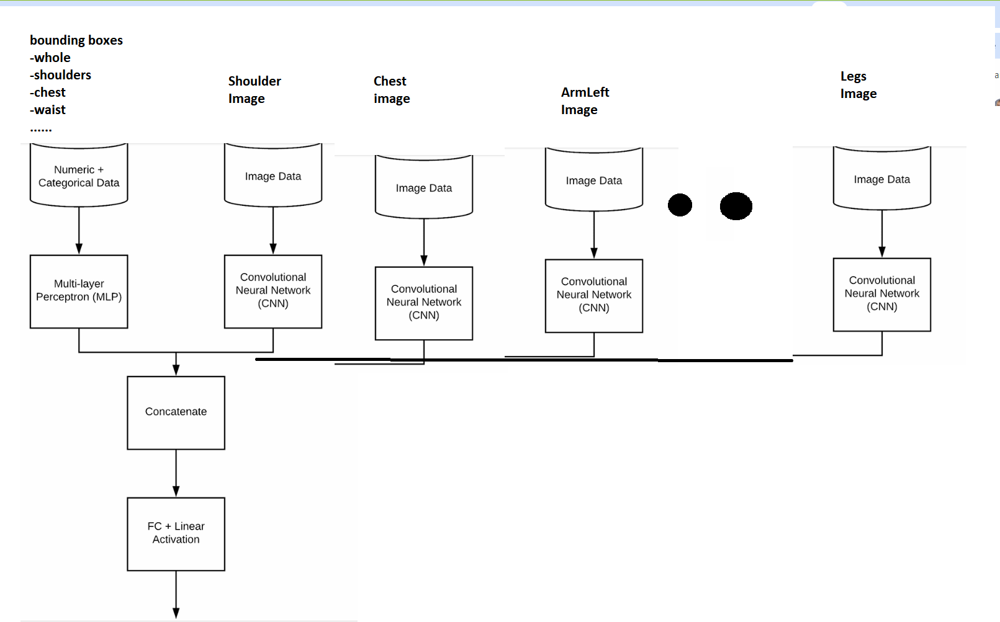

In [ ]:
#FUNCTION to create the model
def create_MultiInputMultiOutputRegressionModel():
  #
  # create the MLP and CNN models

  #first create the dataMLP model
  model_dataMLP = create_dataMLP(data_dimension)
  print("DATA MLP model branch")
  model_dataMLP.summary()

  #next create the Neck imageCNN model

  print("\n\n----------------------")
  neck_model_imageCNN = create_imageCNN("Neck1")
  print("IMAGE CNN model branch")
  neck_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the SHOULDER imageCNN model

  print("\n\n----------------------")
  shoulder_model_imageCNN = create_imageCNN("Shoulder1")
  print("IMAGE CNN model branch")
  shoulder_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the CHEST imageCNN model

  print("\n\n----------------------")
  chest_model_imageCNN = create_imageCNN("Chest1")
  print("IMAGE CNN model branch")
  chest_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the WAIST imageCNN model
  print("\n\n----------------------")
  waist_model_imageCNN = create_imageCNN("Waist1")
  print("IMAGE CNN model branch")
  waist_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the HIPS imageCNN model
  print("\n\n----------------------")
  hips_model_imageCNN = create_imageCNN("Hips1")
  print("IMAGE CNN model branch")
  hips_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the LEGS imageCNN model
  print("\n\n----------------------")
  legs_model_imageCNN = create_imageCNN("Legs1")
  print("IMAGE CNN model branch")
  legs_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the UpperArmLeft_Breadth imageCNN model
  print("\n\n----------------------")
  Uparm_left_model_imageCNN = create_imageCNN("UpArmLeft1")
  print("IMAGE CNN model branch")
  Uparm_left_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the UpperArmRight_Breadth imageCNN model
  print("\n\n----------------------")
  Uparm_right_model_imageCNN = create_imageCNN("UpArmRight1")
  print("IMAGE CNN model branch")
  Uparm_right_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the ARM_Left_Length imageCNN model
  print("\n\n----------------------")
  arm_left_length_model_imageCNN = create_imageCNN("ArmLeft1")
  print("IMAGE CNN model branch")
  arm_left_length_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  #next create the ARM_Right_Length imageCNN model
  print("\n\n----------------------")
  arm_right_length_model_imageCNN = create_imageCNN("ArmRight1")
  print("IMAGE CNN model branch")
  arm_right_length_model_imageCNN.summary()
  print("\n\n\n\n----------------------")

  # create the input to our final set of layers as the *output* of both
  # the mode_dataMLP and ALL THE multiple model_imageCNNs
  #combinedInput = concatenate([model_dataMLP.output, model_imageCNN.output])
  combinedInput = concatenate([model_dataMLP.output, neck_model_imageCNN.output, shoulder_model_imageCNN.output, chest_model_imageCNN.output, waist_model_imageCNN.output, hips_model_imageCNN.output, legs_model_imageCNN.output, Uparm_left_model_imageCNN.output, Uparm_right_model_imageCNN.output, arm_left_length_model_imageCNN.output, arm_right_length_model_imageCNN.output])


  #CREATE the fully connected network after the concatenation
  # our final FC layer head will have two dense layers, the final one
  # being our regression head which has dimension of output_dimension
  x = Dense(128, activation="relu")(combinedInput)
  # LYNNE ADD A DROPOUT LAYER
  x =tf.keras.layers.Dropout(rate=0.2)(x)

 #CREATE 2nd the fully connected network after the concatenation
  # our final FC layer head will have two dense layers, the final one
  # being our regression head which has dimension of output_dimension
  x = Dense(64, activation="relu")(x)
  # LYNNE ADD A DROPOUT LAYER
  x =tf.keras.layers.Dropout(rate=0.2)(x)

 #CREATE 3rd the fully connected network after the concatenation
  x = Dense(32, activation="relu")(x)
  # LYNNE ADD A DROPOUT LAYER
  x =tf.keras.layers.Dropout(rate=0.2)(x)
  x = Dense(output_dimension, activation="linear", name="pred")(x)

  # our final model will accept categorical/numerical data on the MLP
  # input and images on the CNN input, outputting a single value (the
  # predicted price of the house)
  ######################model_dataMLP.output, neck_model_imageCNN.output, shoulder_model_imageCNN.output, chest_model_imageCNN.output, waist_model_imageCNN.output, hips_model_imageCNN.output, legs_model_imageCNN.output, arm_left_model_imageCNN.output, arm_right_model_imageCNN.output
  model = Model(inputs=[model_dataMLP.input, neck_model_imageCNN.input, shoulder_model_imageCNN.input, chest_model_imageCNN.input, waist_model_imageCNN.input, hips_model_imageCNN.input, legs_model_imageCNN.input, Uparm_left_model_imageCNN.input, Uparm_right_model_imageCNN.input, arm_left_length_model_imageCNN.input, arm_right_length_model_imageCNN.input], outputs=x)


  print("COMPLETE Multi-Input Multi-Output Model")
  model.summary()
  return model


In [ ]:
#CREATE THE MODEL
model = create_MultiInputMultiOutputRegressionModel()

DATA MLP model branch
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 16)                784       
                                                                 
 dense_1 (Dense)             (None, 8)                 136       
                                                                 
Total params: 920 (3.59 KB)
Trainable params: 920 (3.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


----------------------
IMAGE CNN model branch
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Neck1 (KerasLayer)          (None, 1280)              5919312   
                                                                 
Total params: 5919312 (22.58 MB)
Trainable params: 5858704 (22.35 

In [ ]:
checkpoint_path = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/TrainingRun/Run4/checkpoint-284-0.83.tf"

#ls $checkpoint_path
# Loads the weights
model.load_weights(checkpoint_path)


#  **STEP 4: Training the model for regression**


from https://rosenfelder.ai/keras-regression-efficient-net/
**use loss mean_absolute_error !!!**


```
model.compile(
        optimizer=optimizer, loss="mean_absolute_error", metrics=[MeanAbsoluteError(), MeanAbsolutePercentageError()]
    )
```



## Setup Checkpoint saving for model and Compile

<mark>IMPORTANT:  update the checkpoint_dir each time you do a different training run or copy over old checkpoints to different saved directory and clear it out</mark>

In [ ]:
#Model Compile and setup with checkpoint call back

def compileSetupModel(model, checkpoint_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12"):
  #from tensorflow.keras.losses import MeanAbsoluteError, MeanAbsolutePercentageErr

  print("Contents of checkpoints directory ")
  !ls $checkpoint_dir
  #setup the  loss as MeanAbsoluteError() so will do regression
  model.compile(
      optimizer=tf.keras.optimizers.SGD(learning_rate=0.0005, momentum=0.9),
      loss = tf.keras.losses.MeanAbsoluteError())

  checkpoint_dir = checkpoint_dir + "/checkpoint-{epoch:02d}-{val_loss:.2f}.hdf5"

  mc = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_dir, save_best_only=True, verbose=1, save_freq='epoch')   # save_weights_only=True


  #callback for tensorboard
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

'''
  initial_learning_rate = 0.0005
  lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=100000,
    decay_rate=0.96,
    staircase=True)

  optimizer = tf.keras.optimizers.SGD(learning_rate=lr_schedule, momentum=0.9)

  model.compile(
    optimizer=optimizer,
    loss = tf.keras.losses.MeanAbsoluteError())
'''

  #model.compile(
  #    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
  #    loss=tf.keras.losses.MeanAbsoluteError())


  # there is some issue with being able to  reload the model from a saved_model if MeanAbsolute Error is
  #  used as a metric or MeanSquaredError  so commenting this out so can save model and reload it.
  #  see below STEP 13 for information about this.   Also our lossis MeanAbsoluteError so this is already tracked.
  # metrics=[ MeanAbsoluteError()])  #, MeanAbsolutePercentageError() do not use as we have 0 value in our data

  #  recall above for  Classification  loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True, label_smoothing=0.1),


  # see https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint
  #checkpoints_dir = "drive/MyDrive/iLab/Stroke/LabeledData-Eye-Classifier-4Classes/checkpoints/checkpoint-{epoch:02d}-{val_loss:.2f}.hdf5""
  #  save every 5 epochs
  #for more on checkpoints also see this blog https://towardsdatascience.com/checkpointing-deep-learning-models-in-keras-a652570b8de6

compileSetupModel(model)

Contents of checkpoints directory 


In [ ]:
#JUST printing out some size information for Diagnostic info
train_size = len(trainImagesNDData)
print("TRAIN")
print(train_size)
print("corresponding Shoulder_Breadth size =" + str(len(trainImagesSBData)))
print("corresponding trainAllRegressionData size =" +str(len(trainAllRegressionData)))

print("\n\nVAL")
val_size = len(validationImagesNDData)
print(val_size)
print("corresponding  Shoulder_Breadth size =" +str(len(validationImagesSBData)))
print("corresponding validationAllRegressionData size =" +str(len(validationAllRegressionData)))

TRAIN
857
corresponding Shoulder_Breadth size =857
corresponding trainAllRegressionData size =857


VAL
107
corresponding  Shoulder_Breadth size =107
corresponding validationAllRegressionData size =107


## <mark>IMPORTANT:  move any previous Run Tensorboard files before retraining if you want to keep as different runs and be clear what files belong to which training run</mark>




In [ ]:
#SAFTEY CHECK

#FIRST TRAINING DATA
#print out info about inputs
print("trainNumericData length=" +str(len(trainNumericData)))
print("trainImageNDData length=" +str(len(trainImagesNDData)))
print("trainImageSBData length=" +str(len(trainImagesSBData)))
print("trainImageCBData length=" +str(len(trainImagesCBData)))
print("trainImageWBData length=" +str(len(trainImagesWBData)))
print("trainImageHBData length=" +str(len(trainImagesHBData)))
print("trainImageLLBData length=" +str(len(trainImagesLLBData)))
print("trainImageUpArmLeftData length=" +str(len(trainImagesUpLeftABData)))
print("trainImageUpArmRightData length=" +str(len(trainImagesUpRightABData)))
print("trainImageArmLeftLData length=" +str(len(trainImagesALeftLData)))
print("trainImageArmRightLData length=" +str(len(trainImagesARightLData)))
trainImageTotalData = len(trainImagesNDData) + len(trainImagesSBData) + len(trainImagesCBData) + len(trainImagesWBData) + len(trainImagesHBData) + len(trainImagesLLBData) + len(trainImagesUpLeftABData) + len(trainImagesUpRightABData) + len(trainImagesALeftLData) + len(trainImagesARightLData)
print("trainImageTotalData length=" +str(trainImageTotalData))
#print("trainImageTotalData length=" +str(len(trainImagesNDData) + len(trainImagesSBData) + len(trainImagesCBData) + len(trainImagesWBData) + len(trainImagesHBData) + len(trainImagesLLBData) + len(trainImagesUpLeftABData) + len(trainImagesUpRightABData) + len(trainImagesALeftLData) + len(trainImagesARightLData) ))


print("trainAllRegressionData length=" +str(len(trainAllRegressionData)))
#print out shape about inputs
print("trainNumericData shape=" +str(trainNumericData.shape))
print("trainImageData shape=" +str(trainImagesSBData.shape))
print("trainAllRegressionData shape=" +str(trainAllRegressionData.shape))


#Saftey -check if all inputs and outputs are numpy arrays
if isinstance(trainNumericData, np.ndarray):
    print("trainNumericData is a numpy array")
else:
    print("trainNumericData is NOT a numpy array")
if isinstance(trainImagesNDData, np.ndarray):
    print("trainImageData is a numpy array")
else:
    print("trainImageData is NOT a numpy array")
if isinstance(trainAllRegressionData, np.ndarray):
    print("trainALlRegressionData is a numpy array")
else:
    print("trainAllRegressionData is NOT a numpy array")



#SECOND VALIDATION DATA
#print out info about inputs
print("validationNumericData length=" +str(len(validationNumericData)))
print("validationImagesNDData length=" +str(len(validationImagesNDData)))
print("validationImagesSBData length=" +str(len(validationImagesSBData)))
print("validationImagesCBData length=" +str(len(validationImagesCBData)))
print("validationImagesWBData length=" +str(len(validationImagesWBData)))
print("validationImagesHBData length=" +str(len(validationImagesHBData)))
print("validationImagesLLBData length=" +str(len(validationImagesLLBData)))
print("validationImagesUpLeftABData length=" +str(len(validationImagesUpLeftABData)))
print("validationImagesUpRightABData length=" +str(len(validationImagesUpRightABData)))
print("validationImagesALeftLData length=" +str(len(validationImagesALeftLData)))
print("validationImagesARightLData length=" +str(len(validationImagesARightLData)))
validationImageTotalData = len(validationImagesNDData) + len(validationImagesSBData) + len(validationImagesCBData) + len(validationImagesWBData) + len(validationImagesHBData) + len(validationImagesLLBData) + len(validationImagesUpLeftABData) + len(validationImagesUpRightABData) + len(validationImagesALeftLData) + len(validationImagesARightLData)
print("validationImageTotalData length=" + str(validationImageTotalData))
#print("validationImageTotalData length=" +str(len(validationImagesNDData) + len(validationImagesSBData) + len(validationImagesCBData) + len(validationImagesWBData) + len(validationImagesHBData) + len(validationImagesLLBData) + len(validationImagesUpLeftABData) + len(validationImagesUpRightABData) + len(validationImagesALeftLData) + len(validationImagesARightLData) ))




print("trainAllRegressionData length=" +str(len(validationAllRegressionData)))
#print out shape about inputs
print("validationNumericData shape=" +str(validationNumericData.shape))
print("validationImageData shape=" +str(validationImagesNDData.shape))
print("validationAllRegressionData shape=" +str(validationAllRegressionData.shape))


#Saftey -check if all inputs and outputs are numpy arrays
if isinstance(validationNumericData, np.ndarray):
    print("validationNumericData is a numpy array")
else:
    print("validationNumericData is NOT a numpy array")
if isinstance(trainImagesNDData, np.ndarray):
    print("validationImageData is a numpy array")
else:
    print("validationImageData is NOT a numpy array")
if isinstance(validationAllRegressionData, np.ndarray):
    print("validationALlRegressionData is a numpy array")
else:
    print("validationAllRegressionData is NOT a numpy array")

trainNumericData length=857
trainImageNDData length=857
trainImageSBData length=857
trainImageCBData length=857
trainImageWBData length=857
trainImageHBData length=857
trainImageLLBData length=857
trainImageUpArmLeftData length=857
trainImageUpArmRightData length=857
trainImageArmLeftLData length=857
trainImageArmRightLData length=857
trainImageTotalData length=8570
trainAllRegressionData length=857
trainNumericData shape=(857, 48)
trainImageData shape=(857, 224, 224, 3)
trainAllRegressionData shape=(857, 11)
trainNumericData is a numpy array
trainImageData is a numpy array
trainALlRegressionData is a numpy array
validationNumericData length=107
validationImagesNDData length=107
validationImagesSBData length=107
validationImagesCBData length=107
validationImagesWBData length=107
validationImagesHBData length=107
validationImagesLLBData length=107
validationImagesUpLeftABData length=107
validationImagesUpRightABData length=107
validationImagesALeftLData length=107
validationImagesARight

In [ ]:
#Make unique names
for i in range(len(model.weights)):
    model.weights[i]._handle_name = model.weights[i].name + "_" + str(i)

In [ ]:
# Train using numpy arrays trainImages, train["severity"]  and validationImages, val["severity"]
# see https://datascience.stackexchange.com/questions/106600/how-to-perform-regression-on-image-data-using-tensorflow
# see model.fit
#from tensorflow.keras.callbacks import EarlyStopping

train_size = len(trainImagesNDData)
valid_size = len(validationImagesNDData)
print("train size " + str(train_size))
print("valid size " + str(valid_size))
print("batch size " + str(BATCH_SIZE))
#steps_per_epoch = (train_size // BATCH_SIZE) -1
#validation_steps = (valid_size // BATCH_SIZE) -1\

steps_per_epoch = 215
validation_steps = 27


#Saftey check --minimum steps is 1
if(steps_per_epoch < 1):
  steps_per_epoch = 1
  print("ERROR: you can NOT traing with less than 1 steps_per_epoch")
if(validation_steps < 1):
  validation_steps= 1
  print("ERROR: you can NOT have validation data with less than 1 steps_per_epoch")

print("steps_per_epoch ="+str(steps_per_epoch))
print("validation_steps ="+str(validation_steps))


epochs = 80  #should be more like 1000

print("Steps per epoch for training is "+ str(steps_per_epoch))
# train the model
print("[INFO] training model...")
'''
#from the blog https://pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/
model.fit(
	x=[trainAttrX, trainImagesX], y=trainY,
	validation_data=([testAttrX, testImagesX], testY),
	epochs=200, batch_size=8)
  '''
'''
input = np.array([trainNumericData, trainImageData])
print(input)
valid = np.array([validationNumericData, validationImages])
hist = model.fit(
    x=input,   #x=trainImages,    # images
    y=trainAllRegressionData,  #y=train["severity"],  # severity target regression value
    epochs=epochs, steps_per_epoch=steps_per_epoch,
    validation_data=(valid, validationAllRegressionData),
    validation_steps=validation_steps,
    callbacks=[mc, tensorboard_callback]).history   #callback for both checkpoints and tensorboard.
'''
checkpoint_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12"
#checkpoint_dir = checkpoint_dir + "/checkpoint-{epoch:02d}-{val_loss:.2f}.hdf5"
checkpoint_dir = checkpoint_dir + "/checkpoint-{epoch:02d}-{val_loss:.2f}.tf"
mc = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_dir, save_best_only=True, verbose=1, save_freq='epoch')   # save_weights_only=True
#callback for tensorboard
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

#validationImageData2 = validationImageData.copy()

# WORKS as everything is numpy arrays.... I think
hist = model.fit(
    x=[trainNumericData, trainImagesNDData, trainImagesSBData, trainImagesCBData, trainImagesWBData, trainImagesHBData,trainImagesLLBData, trainImagesUpLeftABData,trainImagesUpRightABData, trainImagesALeftLData, trainImagesARightLData],
    y=trainAllRegressionData,
    epochs=epochs,
    steps_per_epoch=steps_per_epoch,
    validation_data=([validationNumericData, validationImagesNDData, validationImagesSBData, validationImagesCBData, validationImagesWBData, validationImagesHBData, validationImagesLLBData, validationImagesUpLeftABData, validationImagesUpRightABData, validationImagesALeftLData, validationImagesARightLData], validationAllRegressionData),
    validation_steps=validation_steps,
    callbacks=[mc, tensorboard_callback]).history   #callback for both checkpoints and tensorboard.



'''
early_stopping_callback = EarlyStopping(
    monitor='val_loss',  # Monitor the validation loss
    patience=40,         # Number of epochs with no improvement after which training will be stopped
    verbose=1,           # To print messages when the callback takes action
    mode='min',          # The direction is automatically inferred if not set, 'min' means we want to minimize the loss
    restore_best_weights=True # Restores model weights from the epoch with the minimum validation loss
)
#OLD from my single input image only regression example
#make validation data a tuple (images array, severity array)
#A tuple (x_val, y_val) of Numpy arrays or tensors.i
validationData = (validationImageData, validationSeverity)
hist = model.fit(
    x=trainImageData,   #x=trainImages,    # images
    y=trainSeverity,  #y=train["severity"],  # severity target regression value
    epochs=epochs, steps_per_epoch=steps_per_epoch,
    validation_data=validationData,
    validation_steps=validation_steps,
    callbacks=[mc, tensorboard_callback]).history   #callback for both checkpoints and tensorboard.
    '''

train size 857
valid size 107
batch size 4
steps_per_epoch =215
validation_steps =27
Steps per epoch for training is 215
[INFO] training model...
Epoch 1/80
215/215 [==============================] - ETA: 0s - loss: 2.1767
Epoch 1: val_loss improved from inf to 1.36128, saving model to /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12/checkpoint-01-1.36.tf
215/215 [==============================] - 668s 1s/step - loss: 2.1767 - val_loss: 1.3613
Epoch 2/80
215/215 [==============================] - ETA: 0s - loss: 1.8705
Epoch 2: val_loss did not improve from 1.36128
215/215 [==============================] - 121s 563ms/step - loss: 1.8705 - val_loss: 1.4716
Epoch 3/80
215/215 [==============================] - ETA: 0s - loss: 1.9118
Epoch 3: val_loss did not improve from 1.36128
215/215 [==============================] - 115s 535ms/step - loss: 1.9118 - val_loss: 1.4706
Epoch 4/80
215/215 [==============================] - ETA: 0s - loss: 1.

'\nearly_stopping_callback = EarlyStopping(\n    monitor=\'val_loss\',  # Monitor the validation loss\n    patience=40,         # Number of epochs with no improvement after which training will be stopped\n    verbose=1,           # To print messages when the callback takes action\n    mode=\'min\',          # The direction is automatically inferred if not set, \'min\' means we want to minimize the loss\n    restore_best_weights=True # Restores model weights from the epoch with the minimum validation loss\n)\n#OLD from my single input image only regression example\n#make validation data a tuple (images array, severity array)\n#A tuple (x_val, y_val) of Numpy arrays or tensors.i\nvalidationData = (validationImageData, validationSeverity)\nhist = model.fit(\n    x=trainImageData,   #x=trainImages,    # images\n    y=trainSeverity,  #y=train["severity"],  # severity target regression value\n    epochs=epochs, steps_per_epoch=steps_per_epoch,\n    validation_data=validationData,\n    valida

In [ ]:
for i, w in enumerate(model.weights):
  print(i, w.name)

0 dense/kernel:0
1 dense/bias:0
2 dense_1/kernel:0
3 dense_1/bias:0
4 efficientnetv2-b0/blocks_0/conv2d/kernel:0_Neck
5 efficientnetv2-b0/blocks_0/tpu_batch_normalization/gamma:0_Neck
6 efficientnetv2-b0/blocks_0/tpu_batch_normalization/beta:0_Neck
7 efficientnetv2-b0/blocks_1/conv2d/kernel:0_Neck
8 efficientnetv2-b0/blocks_1/tpu_batch_normalization/gamma:0_Neck
9 efficientnetv2-b0/blocks_1/tpu_batch_normalization/beta:0_Neck
10 efficientnetv2-b0/blocks_1/conv2d_1/kernel:0_Neck
11 efficientnetv2-b0/blocks_1/tpu_batch_normalization_1/gamma:0_Neck
12 efficientnetv2-b0/blocks_1/tpu_batch_normalization_1/beta:0_Neck
13 efficientnetv2-b0/blocks_2/conv2d/kernel:0_Neck
14 efficientnetv2-b0/blocks_2/tpu_batch_normalization/gamma:0_Neck
15 efficientnetv2-b0/blocks_2/tpu_batch_normalization/beta:0_Neck
16 efficientnetv2-b0/blocks_2/conv2d_1/kernel:0_Neck
17 efficientnetv2-b0/blocks_2/tpu_batch_normalization_1/gamma:0_Neck
18 efficientnetv2-b0/blocks_2/tpu_batch_normalization_1/beta:0_Neck
19 eff

## **Step 4.1 Evaluate the training**

In [ ]:
# Evaluate the model

loss = model.evaluate([testNumericData, testImagesNDData,testImagesSBData, testImagesCBData, testImagesWBData, testImagesHBData, testImagesLLBData, testImagesUpLeftABData, testImagesUpRightABData, testImagesALeftLData, testImagesARightLData],testAllRegressionData ,batch_size = BATCH_SIZE, verbose=2)
print("trained model, loss: {:5.4f}%".format(100 * loss))

27/27 - 18s - loss: 0.9949 - 18s/epoch - 677ms/step
trained model, loss: 99.4891%


### Simple plot of loss (mean absolute error) ---this can also be seen below in tensorboard

NameError: name 'hist' is not defined

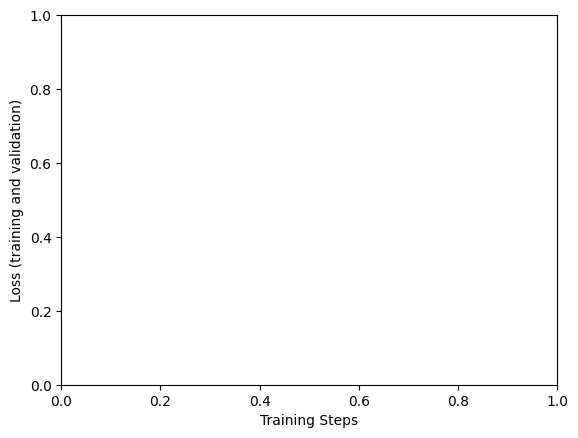

In [ ]:
#plots the history retruned see above in training
plt.figure()
plt.ylabel("Loss (training and validation)")
plt.xlabel("Training Steps")
#plt.ylim([0,2])
plt.plot(hist["loss"], color='orange')
plt.plot(hist["val_loss"], color='blue')
plt.legend(["train", "val"], loc ="lower right")



# **STEP 5:  test** -Try out the model on an image from the **test** data:

## **OPTION 5.1 Load from saved weights**

In [ ]:
# Rebuild top  from https://rosenfelder.ai/keras-regression-efficient-net/
print("Building model with", model_handle)
#model expects float input for images 3 channels (rgb) of IMAGE_SIZE (e.g. 224,224 as defined above)
#call function above in step 3.3 to create the multi input multi output regression model
#CREATE THE MODEL
model = create_MultiInputMultiOutputRegressionModel()
#compile the model
compileSetupModel(model)
model.summary()

Building model with https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/feature_vector/2
DATA MLP model branch
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 16)                784       
                                                                 
 dense_5 (Dense)             (None, 8)                 136       
                                                                 
Total params: 920 (3.59 KB)
Trainable params: 920 (3.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


----------------------


KeyboardInterrupt: 

## <mark>IMPORTANT:  set the checkpoint_path to the correct one</mark>

In [ ]:
#path of model checkpoint
#checkpoint_path = "drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/checkpoints/Run1/checkpoint-09-5.07.hdf5"
checkpoint_path = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run5/checkpoint-284-0.83.tf"

#ls $checkpoint_path
# Loads the weights
model.load_weights(checkpoint_path)

In [ ]:
# Evaluate the model

loss = model.evaluate([testNumericData, testImagesNDData,testImagesSBData, testImagesCBData, testImagesWBData, testImagesHBData, testImagesLLBData, testImagesUpLeftABData, testImagesUpRightABData, testImagesALeftLData, testImagesARightLData],testAllRegressionData ,batch_size = BATCH_SIZE, verbose=2)
print("trained model, loss: {:5.4f}%".format(100 * loss))

3/3 - 0s - loss: 2.1965 - 305ms/epoch - 102ms/step
trained model, loss: 219.6528%


## **Step 5.2 - Single Image** from either testImages or even trainImages or validationImages arrays already loaded

*   below have hardcoded to take the 0 element in the train images you can change this in the code to try different individual images in the train or more appropriately the test dataset.

Predictions for ALL test iamges)
4/4 [==============================] - 12s 351ms/step
prediction_scores output
[[ 1.3749485   3.2186196   4.9404535  ...  4.483629    5.48901
   5.4544935 ]
 [ 4.113861    0.51702225  1.4253489  ... -1.0492564   0.31384307
   0.31361717]
 [-0.9985501  -0.9992766  -1.0032396  ... -1.0010164  -0.99933165
  -1.0003744 ]
 ...
 [-0.9978218  -1.000023   -1.0026013  ... -1.0005801  -1.0004377
  -1.0012405 ]
 [-0.9986481  -0.9967738  -0.1108833  ... -1.0014611  -1.0000049
  -1.0031594 ]
 [ 2.065826    1.1092212   1.8825608  ...  0.6966939   0.17391199
   0.2784502 ]]




Prediction Test Image [0]


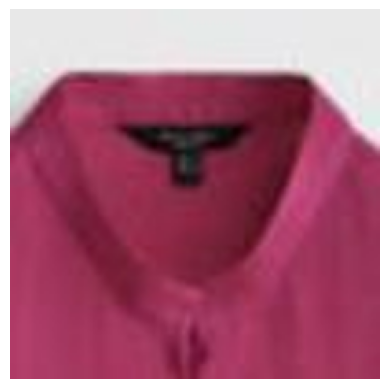




For Image 0
True Regression Vector: [ 3.  3.  4.  5. -1. -1. -1.  5.  5.  7.  7.]
Predicted label: [ 1.3749485  3.2186196  4.9404535  4.3436384 -0.519035  -0.6880437
 -0.4749937  4.4674497  4.483629   5.48901    5.4544935]




Prediction Test Image [1]


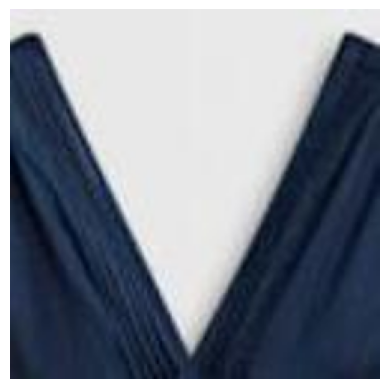




For Image 1
True Regression Vector: [ 7.  1.  2.  2.  5.  8.  8. -1. -1.  1.  1.]
Predicted label: [ 4.113861    0.51702225  1.4253489   0.91609085  3.1757598   4.340192
  6.8842454  -1.0452405  -1.0492564   0.31384307  0.31361717]


In [ ]:
# NEW CODE


# Expand the validation image to (1, 224, 224, 3) before predicting the label

#CAN ONLY SEEM TO PREDICT ALL TEST IMAGEDATA not the images array or single imageData
print("Predictions for ALL test iamges)")
prediction_scores = model.predict([testNumericData,testImagesNDData,testImagesSBData, testImagesCBData, testImagesWBData, testImagesHBData, testImagesLLBData, testImagesUpLeftABData, testImagesUpRightABData, testImagesALeftLData, testImagesARightLData] )
#prediction_scores = model.predict([trainNumericData[0],testImages[0]] )
#print("[INFO] predicting house prices...")
#preds = model.predict([testAttrX, testImagesX])
print("prediction_scores output")
print(prediction_scores)


print("\n\n\n\nPrediction Test Image [0]")
image = testImagesND[0]
true_regressionVector = testAllRegressionData[0]
plt.imshow(image)
plt.axis('off')
plt.show()
predicted_regressionVector = prediction_scores[0]
print("\n\n\nFor Image 0")
print("True Regression Vector: " + str(true_regressionVector))
print("Predicted label: " + str(predicted_regressionVector))



print("\n\n\n\nPrediction Test Image [1]")
image = testImagesND[1]
true_regressionVector = testAllRegressionData[1]
plt.imshow(image)
plt.axis('off')
plt.show()
predicted_regressionVector = prediction_scores[1]
print("\n\n\nFor Image 1")
print("True Regression Vector: " + str(true_regressionVector))
print("Predicted label: " + str(predicted_regressionVector))

In [ ]:
test.columns

Index(['Unnamed: 0', 'filenameNew', 'width', 'height', 'xmin', 'ymin', 'xmax',
       'ymax', 'whole_image', 'xminND', 'yminND', 'xmaxND', 'ymaxND',
       'ND_classvalue', 'ND_image', 'xminSB', 'yminSB', 'xmaxSB', 'ymaxSB',
       'SB_classvalue', 'SB_image', 'xminCB', 'yminCB', 'xmaxCB', 'ymaxCB',
       'CB_classvalue', 'CB_image', 'xminWB', 'yminWB', 'xmaxWB', 'ymaxWB',
       'WB_classvalue', 'WB_image', 'xminHB', 'yminHB', 'xmaxHB', 'ymaxHB',
       'HB_classvalue', 'HB_image', 'xminLB', 'yminLB', 'xmaxLB', 'ymaxLB',
       'LB_classvalue', 'LB_image', 'xminLL', 'yminLL', 'xmaxLL', 'ymaxLL',
       'LL_classvalue', 'LL_image', 'xminUpLeftAB', 'yminUpLeftAB',
       'xmaxUpLeftAB', 'ymaxUpLeftAB', 'UpLeft_ArmBreadth_classvalue',
       'UpLeft_ArmBreadth_image', 'xminUpRightAB', 'yminUpRightAB',
       'xmaxUpRightAB', 'ymaxUpRightAB', 'UpRight_ArmBreadth_classvalue',
       'UpRight_ArmBreadth_image', 'xminALeftL', 'yminALeftL', 'xmaxALeftL',
       'ymaxALeftL', 'ArmL_Length_cla

##**Step 5.3 Predict using the testNumericData and testImageData (np.ndarray of all the test images)**created in step 2  **AND SAVE data in doc_path document**

**output** = ***document (doc_path)***containing test images labeled with prediction regression vector and ground truth (true regression values) from the testAllRegressionData

### <mark>IMPORTANT:  set the ***doc_path*** to the correct one (save one if already exists to new location and remove it)</mark>



```
#main call to predict that takes 2 inputs
predictions = model.predict([testNumericData,testImageData] )
```



In [ ]:
!pip install python-docx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.6/239.6 kB 5.5 MB/s eta 0:00:00


In [ ]:
import os
import PIL
import matplotlib.pyplot as plt
from docx import Document
from docx.shared import Inches
from collections import defaultdict


# ... rest of your code (model, test, predictions logic)

# Location and filename of results document
doc_path = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/detections2.docx"

document = Document()

images_names = ['ND_image','SB_image','CB_image','WB_image',
                    'HB_image','LB_image','LL_image', 'UpLeft_ArmBreadth_image','UpRight_ArmBreadth_image',
                    'ArmL_Length_image','ArmR_Length_image']
body_part_names = ["Neck", "Shoulder", "Chest", "Waist", "Hips", "Legs Breadth", "Legs Lenght", "Upper arm left","Upper Arm right","Left Arm",
                   "Right Arm"]
diff_less_than_2 = defaultdict(int)
diff_between_2_and_2_5 = defaultdict(int)
diff_greater_than_2 = defaultdict(int)
total_counts = defaultdict(int)
#predictions=[1,2,3,4,5,6,7,8,9,10]
predictions = model.predict([testNumericData,testImagesNDData,testImagesSBData, testImagesCBData, testImagesWBData, testImagesHBData,testImagesLLBData, testImagesUpLeftABData,testImagesUpRightABData, testImagesALeftLData, testImagesARightLData] )
num_iterations = len(test['filenameNew'])
count=0
for i in range(num_iterations):
  #filename, body_part_name,prediction, true_regressionVector in zip(test['filename'], body_part_names,predictions,testAllRegressionData):
  #print("count: ",count)
  #count+=1
  filename=test['filenameNew'].iloc[i]
  img_whole_value = test[test['filenameNew'] == filename]['whole_image'].values[0]

  paragraph = document.add_paragraph()
  paragraph.add_run(f"Filename: {img_whole_value}").bold = True  # Make filename bold (optional)

  #print(img_whole_value)
  #print(prediction)
  #print(true_regressionVector)

  # Process and display image (optional)
  plt.imshow(PIL.Image.open(img_whole_value))
  plt.savefig('whole.png')
  plt.show()  # Optional: Show the image (comment out if not needed)

  # Add image to document
  p = document.add_paragraph()
  r = p.add_run()
  r.add_picture('whole.png', width=Inches(4.0))
  os.remove('whole.png')  # Remove temporary image file

  # Create table for this image
  table = document.add_table(rows=len(body_part_names) + 1, cols=4)  # +1 for header row
  table.style = 'Table Grid'  # Optional: Apply a table style for better formatting

  # Set header row with body part names
  header_cells = table.rows[0].cells
  header_cells[0].text = 'Body Part'
  header_cells[1].text = 'Image'  # Placeholder for image (intentionally left empty)
  header_cells[2].text = 'Truth Value'  # Assuming you have truth values
  header_cells[3].text = 'Prediction Value'  # Assuming you have predictions

  # Populate table rows with body part names (skip header row)
  for i, (imgnames,body_part, pred,trueval) in enumerate(zip(images_names,body_part_names, predictions[i],testAllRegressionData[i]), start=1):

    img_bodypart_value = test[test['filenameNew'] == filename][imgnames].values[0]


    plt.imshow(PIL.Image.open(img_bodypart_value))
    filepath = './dir/subdir/filename.ext'
    # Create and display sub-image
    plt.savefig('temp.png')
    row_cells = table.rows[i].cells
    row_cells[0].text = body_part
    row_cells[1].paragraphs[0].add_run().add_picture('temp.png', width=Inches(1.5))
    #row_cells[1].text = img_bodypart_value # Placeholder for image (intentionally left empty)
    #print(true_regressionVector[i-1])
    #print(trueval)
    #print(prediction[i-1])
    #print(pred)
    #truth_value_str = str(true_regressionVector[i-1])
    #pred_val_str=str(prediction[i-1])
    row_cells[2].text = str(trueval)  # Assuming you have truth values
    row_cells[3].text = str(pred)  # Assuming you have predictions
    difference = abs(trueval - pred)
    total_counts[body_part] += 1

    # Categorize the difference and increment the appropriate counter for the body_part
    if difference < 2:
        diff_less_than_2[body_part] += 1
    elif 2 <= difference <= 2.5:
        diff_between_2_and_2_5[body_part] += 1
    else:
        diff_greater_than_2[body_part] += 1
  print("Differences less than 2:")
  for body_part, count in diff_less_than_2.items():
      print(f"{body_part}: {count}")

  print("\nDifferences between 2 and 2.5:")
  for body_part, count in diff_between_2_and_2_5.items():
      print(f"{body_part}: {count}")

  print("\nDifferences greater than 2:")
  for body_part, count in diff_greater_than_2.items():
      print(f"{body_part}: {count}")

  for body_part in total_counts.keys():
      total = total_counts[body_part]
      percent_less_than_2 = (diff_less_than_2[body_part] / total) * 100
      percent_between_2_and_2_5 = (diff_between_2_and_2_5[body_part] / total) * 100
      percent_greater_than_2 = (diff_greater_than_2[body_part] / total) * 100

      print(f"{body_part} - Percentages of Differences:")
      print(f"Less than 2: {percent_less_than_2:.2f}%")
      print(f"Between 2 and 2.5: {percent_between_2_and_2_5:.2f}%")
      print(f"Greater than 2: {percent_greater_than_2:.2f}%\n")

  # Add a paragraph break between image and table for spacing
  document.add_paragraph()


document.save(doc_path)

4/4 [==============================] - 13s 352ms/step


'for i in range(num_iterations):\n  #filename, body_part_name,prediction, true_regressionVector in zip(test[\'filename\'], body_part_names,predictions,testAllRegressionData):\n  #print("count: ",count)\n  #count+=1\n  filename=test[\'filenameNew\'].iloc[i]\n  img_whole_value = test[test[\'filenameNew\'] == filename][\'whole_image\'].values[0]\n\n  paragraph = document.add_paragraph()\n  paragraph.add_run(f"Filename: {img_whole_value}").bold = True  # Make filename bold (optional)\n\n  #print(img_whole_value)\n  #print(prediction)\n  #print(true_regressionVector)\n\n  # Process and display image (optional)\n  plt.imshow(PIL.Image.open(img_whole_value))\n  plt.savefig(\'whole.png\')\n  plt.show()  # Optional: Show the image (comment out if not needed)\n\n  # Add image to document\n  p = document.add_paragraph()\n  r = p.add_run()\n  r.add_picture(\'whole.png\', width=Inches(4.0))\n  os.remove(\'whole.png\')  # Remove temporary image file\n\n  # Create table for this image\n  table = docu

### **Step 5.3.1  OPTION Save Prediction Regression Output Vectors and the Ground Truth As text only (No images) to 2 files specified)**

<mark> IMPORTANT: if you dont want default values of function for name and location of the predictions and ground truth files change it</mark>

In [ ]:
#option save the prediction and original regression values(vectors) to TWO data files
def saveAsTextPredictionANDTrueRegressionValuesTo2Files(predictions, trueRegressionVectors, output_order, output_dimension, base_file_path= "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14" , prediction_file = "predictions.txt", truth_file = "truth.txt"):

   #create directories if they do not exist
  from pathlib import Path

  prediction_file = base_file_path + "/"+ prediction_file
  truth_file = base_file_path + "/" + truth_file

  file = Path(os.path.dirname(prediction_file))
  print("creating " + str(file))
  file.parent.mkdir(parents=True, exist_ok=True)
  file = Path(os.path.dirname(truth_file))
  print("creating " + str(file))
  file.parent.mkdir(parents=True, exist_ok=True)

  regFileNames = []

  regFileObjects = []

  #setup array of file objects pointing one for each regression value in output_order and print corresponind file.
  i=0
  for regName in output_order:
    f = base_file_path + "/" + regName + "_predictions.txt"
    regFileObjects.append(open(f, 'w'))
    print("open filename is " + regFileObjects[i].name)
    i = i+1




  #write predictions to prediction_file as the predicted regression vectors, one line at a time
  with open(prediction_file, "w") as txt_file:
    for line in predictions:
        print(line)
        i=0
        for val in line:
          regFileObjects[i].write(str(val) + "\n")
          i=i+1
        txt_file.write(str(line) + "\n")
        #cycle through the line a



  #write true regression vector values to truth_file, one line at a time, corresponding to the same lines as prediction_file
  with open(truth_file, "w") as txt_file2:
    for line in trueRegressionVectors:
        print(line)
        txt_file2.write(str(line) + "\n")


  txt_file.close()
  txt_file2.close()


  #cycle through all the individual regression prediction files and close them
  for regFilePointer in regFileObjects:
    print("finished writing out reg predictions file " + regFilePointer.name)
    regFilePointer.close()




#call function, usint predictions from step 5.3  And testAllRegression Data from step 3  AND from step 3.1 output_order, output_dimension
if output_order is None:
  print("you can not excute this step without first executing steps 1-3 and either training model in step 4 (or reloading in step 13) AND running step 5.3")

saveAsTextPredictionANDTrueRegressionValuesTo2Files(predictions, testAllRegressionData, output_order, output_dimension)

creating /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14
creating /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/Neck_Depth_predictions.txt
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/Shoulder_Breadth_predictions.txt
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/Chest_Breadth_predictions.txt
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/Waist_Breadth_predictions.txt
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/Hips_Breadth_predictions.txt
open filename is /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old

### **Step 5.3.2  OPTION Save Prediction Regression Output Vectors and the Ground Truth As text only (No images) to SINGLE files specified)**



*   **Output** = data file containing both the predicted regression values(vector), ground truth and image name for each testing sample, one on each line.



<mark> IMPORTANT: if you dont want default values of function for name and location of the output file </mark>

In [ ]:
test.columns

Index(['Unnamed: 0', 'filenameNew', 'width', 'height', 'xmin', 'ymin', 'xmax',
       'ymax', 'whole_image', 'xminND', 'yminND', 'xmaxND', 'ymaxND',
       'ND_classvalue', 'ND_image', 'xminSB', 'yminSB', 'xmaxSB', 'ymaxSB',
       'SB_classvalue', 'SB_image', 'xminCB', 'yminCB', 'xmaxCB', 'ymaxCB',
       'CB_classvalue', 'CB_image', 'xminWB', 'yminWB', 'xmaxWB', 'ymaxWB',
       'WB_classvalue', 'WB_image', 'xminHB', 'yminHB', 'xmaxHB', 'ymaxHB',
       'HB_classvalue', 'HB_image', 'xminLB', 'yminLB', 'xmaxLB', 'ymaxLB',
       'LB_classvalue', 'LB_image', 'xminLL', 'yminLL', 'xmaxLL', 'ymaxLL',
       'LL_classvalue', 'LL_image', 'xminUpLeftAB', 'yminUpLeftAB',
       'xmaxUpLeftAB', 'ymaxUpLeftAB', 'UpLeft_ArmBreadth_classvalue',
       'UpLeft_ArmBreadth_image', 'xminUpRightAB', 'yminUpRightAB',
       'xmaxUpRightAB', 'ymaxUpRightAB', 'UpRight_ArmBreadth_classvalue',
       'UpRight_ArmBreadth_image', 'xminALeftL', 'yminALeftL', 'xmaxALeftL',
       'ymaxALeftL', 'ArmL_Length_cla

In [ ]:
test.columns
images_names2 = test['filenameNew'].tolist()
print(images_names2)

['Neck3_01_png.rf.4d29d61026a91921adf49a93c454e7a7.jpg', 'Neck7_05_png.rf.7e89c0132995894a08e29df96f89775e.jpg', 'shorts59_jpeg.rf.4e268dc84a12a08419587b4ec65c34d1.jpg', 'tops43_jpeg.rf.e7a859cee00b152bdaf9d4a40a62c698.jpg', 'pants52_jpeg.rf.3dcbf5c1d4a50af69974a712f051a427.jpg', 'pants5_jpeg.rf.7dc7baa98a2c085d05d1c04e1bd04bbc.jpg', 'dress37_jpeg.rf.5c2595662eea1e7717ad5d22f3ce72eb.jpg', 'jacket47_jpeg.rf.556404e27519874a66177af95f987d67.jpg', 'pants99_jpeg.rf.8aa98ee3782aeac8af075b4760e11a26.jpg', 'skirt1_jpeg.rf.999dd380eb702269d5476918ea4f2e29.jpg', 'pants70_jpeg.rf.f6954b248e30ca43bf478c8f8afa11cd.jpg', 'skirt4_jpeg.rf.ba06564cd6c384839596f29f2a0dfe9b.jpg', 'tops114_jpeg.rf.c1e74327a195032a41f3f1b258250836.jpg', 'pants72_jpeg.rf.85a308275ce803a79549c677d39eae7c.jpg', 'pants4_jpeg.rf.7e2dba5b88b67a735404255e800a683a.jpg', 'dress81_jpeg.rf.2578e66b54f5479e17ede07ab5b6d913.jpg', 'jumpsuit81_jpeg.rf.124deac4b784061fcd481691bdecd094.jpg', 'tops95_jpeg.rf.bf7d2bbf9bd39917544eda39bdc747f

In [ ]:
#option save the prediction and original regression values(vectors) to A SINGLE data file
def saveAsTextPredictionANDTrueRegressionValuesToONEFile(predictions, trueRegressionVectors, prediction_file = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run14/testing.txt"):

 with open(prediction_file, "w") as txt_file3:
   for image_name, prediction, truth in zip(images_names2, predictions, trueRegressionVectors):
      line = str(prediction)  + " , "  + str(truth) +  " , " + str(image_name)
      print(line)
      txt_file3.write(str(line) + "\n")

   txt_file3.close()


#call the function
saveAsTextPredictionANDTrueRegressionValuesToONEFile(predictions, testAllRegressionData)

[ 1.3749485   3.218619    4.9404545   4.3436394  -0.5190351  -0.6880437
 -0.47499394  4.46745     4.483629    5.48901     5.454494  ] , [ 3.  3.  4.  5. -1. -1. -1.  5.  5.  7.  7.] , Neck3_01_png.rf.4d29d61026a91921adf49a93c454e7a7.jpg
[ 4.113861   0.5170225  1.4253496  0.9160911  3.17576    4.340192
  6.8842454 -1.0452405 -1.0492564  0.3138432  0.3136173] , [ 7.  1.  2.  2.  5.  8.  8. -1. -1.  1.  1.] , Neck7_05_png.rf.7e89c0132995894a08e29df96f89775e.jpg
[-0.9985501  -0.9992766  -1.0032396  -1.0000944   2.3057365   3.0423632
  5.397113   -1.0014925  -1.0010164  -0.99933165 -1.0003744 ] , [-1. -1. -1. -1.  3.  5.  5. -1. -1. -1. -1.] , shorts59_jpeg.rf.4e268dc84a12a08419587b4ec65c34d1.jpg
[ 4.0399637   2.5196614   4.4500165   4.732334   -0.44326973 -0.7758504
 -0.49820828  2.6526504   2.659225    5.8209615   5.761933  ] , [ 6.  7.  8.  8. -1. -1. -1.  7.  7.  8.  8.] , tops43_jpeg.rf.e7a859cee00b152bdaf9d4a40a62c698.jpg
[-0.9974256 -0.9990488 -1.0046606 -1.0001826  3.1255918  4.7537

##**Step 5.4 From a specified directory of raw images**


*  will read in all the images
*  then resize each image to IMAGE_SIZE (e.g. 224,224)
*  then run through model object already in memory (trained above step 4)
*  then displays image, prediction and name of image



### <mark>IMPORTANT:  specify directory where test images are located</mark>

In [ ]:
#specify directory to open images from and process
test_directory = "/content/drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test"
print(test_directory)
!ls $test_directory

newRegression_CSVFile = "/content/drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/annotationsTestDataDummy.csv"
print(newRegression_CSVFile)
!cat $newRegression_CSVFile

drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test
annotationsTestDataDummy.csv  test_boy1.jpg  test_boy2.jpg  test_boy3.jpg  test_girl1.jpg
drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/annotationsTestDataDummy.csv
wholefilename,width,height,xmin,ymin,xmax,ymax,filenameSB,Shoulder_Breadth,xminSB,yminSB,xmaxSB,ymaxSB,filenameSS,Shoulder_Symmetry,xminSS,yminSS,xmaxSS,ymaxSS,filenameST,Shoulder_Tone,xminST,yminST,xmaxST,ymaxST
girl1.jpg,996,664,234,59,813,664,test_girl1.jpg,3,409,217,660,301,test_girl1.jpg,5,406,212,664,294,test_girl1.jpg,5,405,213,658,302
boy3.jpg,998,1498,217,61,900,658,test_boy3.jpg,5,307,217,703,383,test_boy3.jpg,5,365,337,635,494,test_boy3.jpg,4,317,235,687,376
boy2.jpg,996,664,184,92,953,660,test_boy2.jpg,7,389,297,745,381,test_boy2.jpg,5,390,297,744,379,test_boy2.jpg,7,393,293,747,378
boy1.jpg,500,699,99,82,404,699,test_boy1.jpg,5,115,233,387,356,test_boy1.jpg,5,116,233,392,357,test_boy1.jpg,5,119,236,

### define function open_images to read in images from a directory and store in a numpy array of 2 arrrays


*   first define readNumericalData to read in the numerical data for the new testing data in the csvFile specified -- readNumericalData
*   next define function to read in the images from a test directory



In [ ]:
#takes in a CVS file that contains numerical data for input into prediction on new testing data
def readNumericalData(csvFile="drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/annotationsTestDataDummy.csv")-> np.ndarray:

  newTestingNumericalData = []
  #open a csv file with pandas
  pandasDataFrame1 = pd.read_csv(csvFile)


  #for line in pandasDataFrame['xmax']:
  for index, row in pandasDataFrame1.iterrows():


    list = [row["xmin"], row["ymin"], row["xmax"], row["ymax"],
            row["xminSB"], row["yminSB"], row["xmaxSB"], row["ymaxSB"],
            row["xminSS"], row["yminSS"], row["xmaxSS"], row["ymaxSS"],
            row["xminST"], row["yminST"], row["xmaxST"], row["ymaxST"]]

    newTestingNumericalData.append(np.array(list));


  #convert to numpy array
  newTestingNumericalData = np.array(newTestingNumericalData)



  return newTestingNumericalData


In [ ]:


import re


#function to open up and read in images from a directoryand convert to a numpy array of 2D arrays  AND numpy array of imagenames
#def open_images(inference_folder="drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test") -> np.ndarray, np.ndarray:
def open_images(inference_folder="drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test"):
    """Loads images from a folder and prepare them for inferencing.

    Parameters
    ----------
    inference_folder : str
        Location of images for inferencing.

    Returns
    -------
    np.ndarray
        List of images as numpy arrays transformed to fit the efficient_net model input specs.
    """
    images = []
    image_names = []
    print("attempting to read images in " + inference_folder)
    # Regex to check valid image file extension.
    regex = "([^\\s]+(\\.(?i)(jpe?g|png|gif|bmp))$)"
    # Compile the ReGex
    p = re.compile(regex)

    for img in os.listdir(inference_folder):
        if(not re.search(p, img)):
          continue
        img_location =os.path.join(test_directory, img)
        image_names.append(img_location)

        with PIL.Image.open(img_location) as img:  # open image with pillow
            img = img.resize(IMAGE_SIZE)  #lynne added to get input into right size
            #plt.imshow(img)   #lynne added
            #plt.show()  #lynne added
            img = np.array(img)
            img = img[:, :, :3]
            img = np.expand_dims(img, axis=0)  # add 0 dimension to fit input shape of efficient_net

        images.append(img)
    images_array = np.vstack(images)  # combine images efficiently to a numpy array

    image_names = np.array(image_names)
    return images_array, image_names




attempting to read images in drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test
1/1 [==============================] - 0s 26ms/step
PLOT RESULTS
['drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/test_boy1.jpg'
 'drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/test_boy2.jpg'
 'drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/test_boy3.jpg'
 'drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/test_girl1.jpg']
Goging to read drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/train/boy2Shoulders.jpg


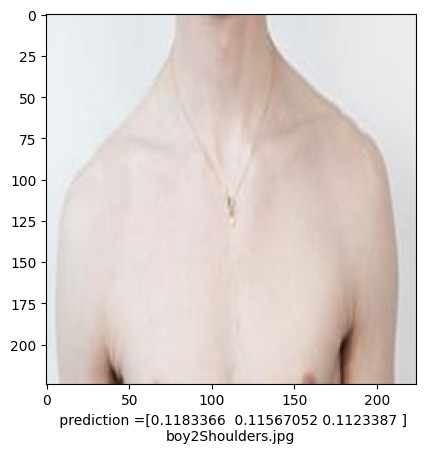

Goging to read drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/train/boy1Shoulders.jpg


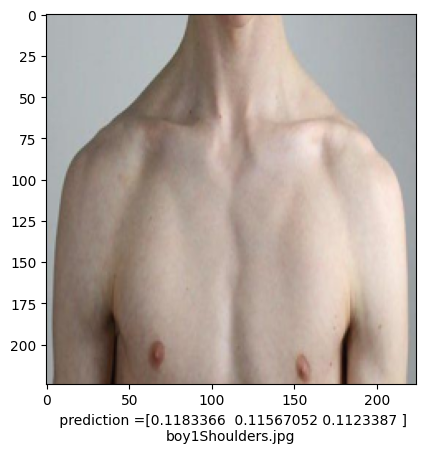

Goging to read drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/train/boy2Shoulders.jpg


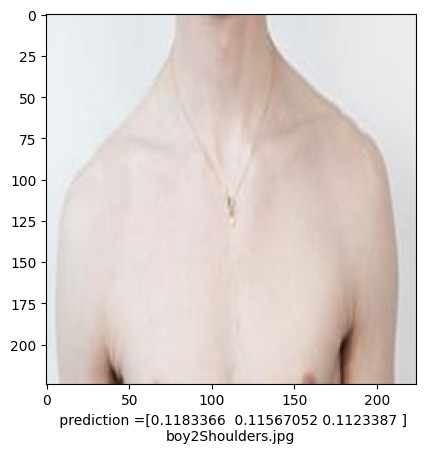

Goging to read drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/train/boy5Shoulders.jpg


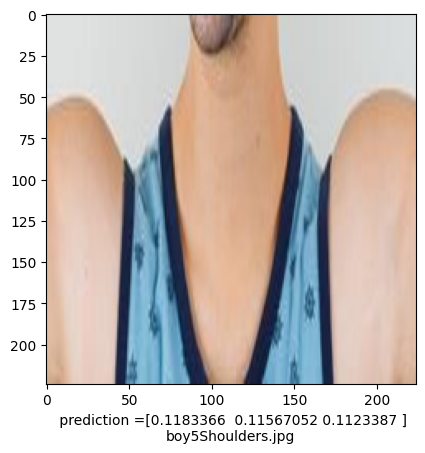

In [ ]:
# call previous functions to read in images from a directory and csv new testing data  AND to then call predictions on it & Plot

def readNewTestingData(model, test_directory="drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test", csvFile="drive/MyDrive/iLab/Orientation/ML_MultiInput_Regression/DummyHardCodedData/test/annotationsTestDataDummy.csv"):
  #read in numerical data
  newTestingNumericalData = readNumericalData(csvFile)


  #read in images as numpy array of 2D numpy arrays (newTestImageData) and their filenames image_names
  newTestImageData, image_names = open_images(test_directory)



  #perform predicitons
  predictions = model.predict([newTestingNumericalData, newTestImageData])

  print("PLOT RESULTS")
  #plot results
  print(image_names)
  showInfo = True
  for image_name, prediction in zip(images_names, predictions):
    print("Goging to read "+ image_name)
    img = np.array(PIL.Image.open(image_name).resize(IMAGE_SIZE))
    if showInfo : plt.imshow(img)
    if showInfo :  plt.xlabel(" prediction =" +str(prediction) + "\n" + str(os.path.basename(image_name)))
    if showInfo : plt.show()



#using default directory and csv file
readNewTestingData(model)


### **Step 4.1 run Mean Absolute Error Test on testing data**

In [ ]:

# Using 'auto'/'sum_over_batch_size' reduction type.
mae = tf.keras.losses.MeanAbsoluteError()
mean_absolute_error_test = mae(testAllRegressionData, predictions).numpy()
print("MAE-mean absolute error for testing data is " + str(mean_absolute_error_test))

MAE-mean absolute error for testing data is 0.9948913


## STEP 5.5 plot results -<mark>-**NOT DONE**</mark>




In [ ]:
#plot results using seaborn and matplotlib
import seaborn as sns
from tensorflow.keras.callbacks import History

def plot_results(model_history_eff_net: History, mean_baseline: float):
    """This function uses seaborn with matplotlib to plot the trainig and validation losses of both input models in an
    sns.relplot(). The mean baseline is plotted as a horizontal red dotted line.

    Parameters
    ----------
    model_history_eff_net : History
        keras History object of the model.fit() method.
    mean_baseline : float
        Result of the get_mean_baseline() function.
    """

    # create a dictionary for each model history and loss type
    dict3 = {
        "MAPE": model_history_eff_net.history["mean_absolute_percentage_error"],
        "type": "training",
        "model": "eff_net",
    }
    dict4 = {
        "MAPE": model_history_eff_net.history["val_mean_absolute_percentage_error"],
        "type": "validation",
        "model": "eff_net",
    }

    # convert the dicts to pd.Series and concat them to a pd.DataFrame in the long format
    s3 = pd.DataFrame(dict3)
    s4 = pd.DataFrame(dict4)
    df = pd.concat([s3, s4], axis=0).reset_index()
    grid = sns.relplot(data=df, x=df["index"], y="MAPE", hue="model", col="type", kind="line", legend=False)
    grid.set(ylim=(20, 100))  # set the y-axis limit
    for ax in grid.axes.flat:
        ax.axhline(
            y=mean_baseline, color="lightcoral", linestyle="dashed"
        )  # add a mean baseline horizontal bar to each plot
        ax.set(xlabel="Epoch")
    labels = ["eff_net", "mean_baseline"]  # custom labels for the plot

    plt.legend(labels=labels)
    plt.savefig("training_validation.png")
    plt.show()

In [ ]:
plot_results(hist,0.0)

AttributeError: ignored

# **STEP 6: Save model as Saved Model**

if the saved_model_path does not exist create it (or change it to where you want to save it)


IMPORTANT: current model structure only will save to SAVED_MODEL format and not the new .keras format --see below for error will need to investigate.  


In [ ]:
saved_model_path = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12/saved_model"
print(saved_model_path)
!ls $saved_model_path
#tf.saved_model.save(model, saved_model_path)
model.save(saved_model_path, save_format='tf')  # NOTE: now there is a new saved format .keras --otherwise you must specify tf to create SAVEDMODEL format

'''
Note there is some problem when trying to save this model to the new .keras format
Call tf.keras.Model.save to save a model's architecture, weights, and training configuration in a single model.keras zip archive.
this is the format that you get by saying
model.save(saved_model_path)  # see https://www.tensorflow.org/tutorials/keras/save_and_load

I get this error which I think may have something to do with how the Input is defined above when creating the model --based on searches.
Not sure how to resolve this?

TypeError: in user code:

    File "/usr/local/lib/python3.10/dist-packages/keras/src/saving/legacy/saving_utils.py", line 147, in _wrapped_model  *
        outputs = model(*args, **kwargs)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler  **
        raise e.with_traceback(filtered_tb) from None

    TypeError: Exception encountered when calling layer 'sequential' (type Sequential).

    Binding inputs to tf.function `keras_layer_layer_call_and_return_conditional_losses` failed due to `missing a required argument: 'inputs'`. Received args: (<tf.Tensor 'input_1:0' shape=(None, 224, 224, 3) dtype=float32>,) and kwargs: {'training': False} for signature: (self, inputs, training=<object object at 0x7d04a6e3c420>).

    Call arguments received by layer 'sequential' (type Sequential):
      • inputs=tf.Tensor(shape=(None, 224, 224, 3), dtype=float32)
      • training=False
      • mask=None
'''

#note the above will give a warning when run
# see https://stackoverflow.com/questions/65697623/tensorflow-warning-found-untraced-functions-such-as-lstm-cell-6-layer-call-and
# says to safely ignore

/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12/saved_model
ls: cannot access '/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12/saved_model': No such file or directory


NameError: name 'model' is not defined

# **STEP 7: Save TFlite model** for deployment to mobile devices

In [ ]:
# Convert the model.
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

# Save the model.
tflite_model_location = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12/model-300.tflite"

#create directory if does not exist
from pathlib import Path
file = Path(os.path.dirname(tflite_model_location))
print("creating " + str(file))
file.parent.mkdir(parents=True, exist_ok=True)
file.mkdir(parents=True, exist_ok=True)


#save
with open(tflite_model_location, 'wb') as f:
  f.write(tflite_model)

creating /content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run12


# OLD STEP 7 <mark>NOT DONE: Deployment to TensorFlow Lite</mark>

[TensorFlow Lite](https://www.tensorflow.org/lite) lets you deploy TensorFlow models to mobile and IoT devices. The code below shows how to convert the trained model to TFLite and apply post-training tools from the [TensorFlow Model Optimization Toolkit](https://www.tensorflow.org/model_optimization). Finally, it runs it in the TFLite Interpreter to examine the resulting quality

  * Converting without optimization provides the same results as before (up to roundoff error).
  * Converting with optimization without any data quantizes the model weights to 8 bits, but inference still uses floating-point computation for the neural network activations. This reduces model size almost by a factor of 4 and improves CPU latency on mobile devices.
  * On top, computation of the neural network activations can be quantized to 8-bit integers as well if a small reference dataset is provided to calibrate the quantization range. On a mobile device, this accelerates inference further and makes it possible to run on accelerators like Edge TPU.

In [ ]:
#@title Optimization settings
optimize_lite_model = False  #@param {type:"boolean"}
#@markdown Setting a value greater than zero enables quantization of neural network activations. A few dozen is already a useful amount.
num_calibration_examples = 60  #@param {type:"slider", min:0, max:1000, step:1}
representative_dataset = None
if optimize_lite_model and num_calibration_examples:
  # Use a bounded number of training examples without labels for calibration.
  # TFLiteConverter expects a list of input tensors, each with batch size 1.
  representative_dataset = lambda: itertools.islice(
      ([image[None, ...]] for batch, _ in train_ds for image in batch),
      num_calibration_examples)

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_path)
if optimize_lite_model:
  converter.optimizations = [tf.lite.Optimize.DEFAULT]
  if representative_dataset:  # This is optional, see above.
    converter.representative_dataset = representative_dataset
lite_model_content = converter.convert()

with open(f"/tmp/lite_flowers_model_{model_name}.tflite", "wb") as f:
  f.write(lite_model_content)
print("Wrote %sTFLite model of %d bytes." %
      ("optimized " if optimize_lite_model else "", len(lite_model_content)))

In [ ]:
interpreter = tf.lite.Interpreter(model_content=lite_model_content)
# This little helper wraps the TFLite Interpreter as a numpy-to-numpy function.
def lite_model(images):
  interpreter.allocate_tensors()
  interpreter.set_tensor(interpreter.get_input_details()[0]['index'], images)
  interpreter.invoke()
  return interpreter.get_tensor(interpreter.get_output_details()[0]['index'])

In [ ]:
#@markdown For rapid experimentation, start with a moderate number of examples.
num_eval_examples = 50  #@param {type:"slider", min:0, max:700}
eval_dataset = ((image, label)  # TFLite expects batch size 1.
                for batch in train_ds
                for (image, label) in zip(*batch))
count = 0
count_lite_tf_agree = 0
count_lite_correct = 0
for image, label in eval_dataset:
  probs_lite = lite_model(image[None, ...])[0]
  probs_tf = model(image[None, ...]).numpy()[0]
  y_lite = np.argmax(probs_lite)
  y_tf = np.argmax(probs_tf)
  y_true = np.argmax(label)
  count +=1
  if y_lite == y_tf: count_lite_tf_agree += 1
  if y_lite == y_true: count_lite_correct += 1
  if count >= num_eval_examples: break
print("TFLite model agrees with original model on %d of %d examples (%g%%)." %
      (count_lite_tf_agree, count, 100.0 * count_lite_tf_agree / count))
print("TFLite model is accurate on %d of %d examples (%g%%)." %
      (count_lite_correct, count, 100.0 * count_lite_correct / count))

# **STEP 8:  run Tensorboard**

In [ ]:
#in case have to find the current running tensorboard process to kill
!lsof -i :6006

COMMAND      PID USER   FD   TYPE  DEVICE SIZE/OFF NODE NAME
tensorboa 225293 root   14u  IPv4 6780692      0t0  TCP localhost:6006 (LISTEN)


In [ ]:
!kill 225293

In [ ]:
#log_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/tensorboard"

In [ ]:
#code to run tensorboard using log_dir specified above
# Load the TensorBoard notebook extension
#%load_ext tensorboard
%reload_ext tensorboard
import datetime, os
#import tensorflow as tf  #already done above
#see step 2.1 for log directory definition
%tensorboard --logdir $log_dir

Reusing TensorBoard on port 6006 (pid 225293), started 0:14:15 ago. (Use '!kill 225293' to kill it.)

<IPython.core.display.Javascript object>

# <mark>LYNNE LYNNE STOP STOP STOP HERE</mark>

# **STEP 9: TEST Metrics for Regression:  Mean Absolute Error**

main are Mean Absolute Error, Mean Squared Error and other variations.   We have
Mean Absolute Error plotted for training and validation using Tensorboard in Step 8.

https://iq.opengenus.org/performance-metrics-in-classification-regression/

**ASSUMES you HAVE RUN step 5.2 above to test testing results.  Expects predictions and severities = test["severity"] array to exist (ground truth from cell arrays**

### <mark>NEXT OPTION 1 need to be worked on</mark>

In [ ]:
#OPTION 1 if you are restarting the colab and do not currently have active severities and predictions you can
# read them in from the testing directory if you saved them in Step 5.2

prediction_file = "/content/drive/MyDrive/ObjectDetection/SmartFashion/Regression/Old/dressOnly/trainingRun/Run5/testing.txt"

#open a csv file with pandas
pandasTestFrame = pd.read_csv(prediction_file, header=None, usecols=[0,1])
print(pandasTestFrame)

#header=None and usecols=[0,1] for the 1st and 2nd columns:
# where 1st column is predicted value and 2nd is the corresponding ground truth
# read predictions into predictions numpy array and
# read ground truth into severities numpy array

predictions2 = pandasTestFrame[0].to_numpy()
print(predictions2)

for index, row in  pandasTestFrame.iterrows():
    print(row)
    #list = [row["xmin"], row["ymin"], row["xmax"]


groundTruthRegressionValues = pandasTestFrame[1].to_numpy()
print(groundTruthRegressionValues)


# Using 'auto'/'sum_over_batch_size' reduction type.
mae = tf.keras.losses.MeanAbsoluteError()
mean_absolute_error_test = mae(groundTruthRegressionValues, predictions2).numpy()
print("MAE-mean absolute error for testing data is " + str(mean_absolute_error_test))

                                      0             1
0   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
1   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
2   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
3   [0.1183366  0.11567052 0.1123387 ]    [7. 5. 7.] 
4   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 4.] 
5   [0.1183366  0.11567052 0.1123387 ]    [3. 7. 3.] 
6   [0.1183366  0.11567052 0.1123387 ]    [3. 7. 7.] 
7   [0.1183366  0.11567052 0.1123387 ]    [3. 7. 3.] 
8   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
9   [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
10  [0.1183366  0.11567052 0.1123387 ]    [5. 5. 5.] 
11  [0.1183366  0.11567052 0.1123387 ]    [3. 7. 7.] 
12  [0.1183366  0.11567052 0.1123387 ]    [7. 5. 7.] 
13  [0.1183366  0.11567052 0.1123387 ]    [3. 5. 5.] 
['[0.1183366  0.11567052 0.1123387 ] '
 '[0.1183366  0.11567052 0.1123387 ] '
 '[0.1183366  0.11567052 0.1123387 ] '
 '[0.1183366  0.11567052 0.1123387 ] '
 '[0.1183366  0.11567052 0.1123387

InvalidArgumentError: ignored

In [ ]:

# Using 'auto'/'sum_over_batch_size' reduction type.
mae = tf.keras.losses.MeanAbsoluteError()
mean_absolute_error_test = mae(testAllRegressionData, predictions).numpy()
print("MAE-mean absolute error for testing data is " + str(mean_absolute_error_test))

UnimplementedError: {{function_node __wrapped__Cast_device_/job:localhost/replica:0/task:0/device:CPU:0}} Cast float to string is not supported [Op:Cast] name: 

# **STEP 10: Find something similar to Confusion Matrix**

see https://medium.com/@dave.cote.msc/experimenting-confusion-matrix-for-regression-a-powerfull-model-analysis-tool-7c288d99d437

CONCEPT:  discretize the predictions and ground truth (if not alread) and then create confusion matrix agains these (treating them in essence like "classes")

ASSUME:  have predictions array that stores predictions and severities array that stores ground truth.  If not the optional cell directly below will load it assuming you saved in in step 5.2

ISSUE:  this will be custom to YOUR regression values

BELOW: this shows for a 1D regression value ranging from 0 to 10 (it could go above) and we are going to create bins every 0.5.  Meaning we will have bins like 0.0, 0.5, 1.0, 1.5, 2.0, 2.5 up to 10.0.   This is reflective of how we did our ground truth labeling of severities for our Stroke Data example using Roboflow (see top of this colab for a discussion of this).  As this regression problem requires the labeling of the regression values for ground truth by humans this discretization was done on the input data. (other regression problems will truly have continuous values in the input data like house prices --but, even there it is discretized to the dollar ammount).


In [ ]:
predictionsValues = predictions
print(predictionsValues)
truthValues = testAllRegressionData
print(truthValues)

[[ 1.3749485   3.218619    4.9404545  ...  4.483629    5.48901
   5.454494  ]
 [ 4.113861    0.5170225   1.4253496  ... -1.0492564   0.3138432
   0.3136173 ]
 [-0.9985501  -0.9992766  -1.0032396  ... -1.0010164  -0.99933165
  -1.0003744 ]
 ...
 [-0.9978218  -1.000023   -1.0026013  ... -1.0005801  -1.0004377
  -1.0012405 ]
 [-0.9986481  -0.9967738  -0.1108833  ... -1.0014611  -1.0000049
  -1.0031594 ]
 [ 2.0658257   1.109221    1.8825608  ...  0.6966938   0.17391175
   0.27844983]]
[[ 3.  3.  4. ...  5.  7.  7.]
 [ 7.  1.  2. ... -1.  1.  1.]
 [-1. -1. -1. ... -1. -1. -1.]
 ...
 [-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 [ 3.  2.  3. ...  2.  2.  2.]]


In [ ]:
#cycle through the predictions array and the truthValues
# create an array of arrays of the individual regression predictions and their matching groundtruth values
# one for each regression value in output_order  (have output_dimension of them)


#STEP 1: cycle through each regression value in the pred and truth arrays to create simple elements
#setup array of file objects pointing one for each regression value in output_order and print corresponind file.
individualRegressionPredictionNPArrays = []
individualRegressionTruthNPArrays = []

for regName in output_order:
  individualRegressionPredictionNPArrays.append([])
  individualRegressionTruthNPArrays.append([])


print(individualRegressionPredictionNPArrays)
print(individualRegressionTruthNPArrays)


#STEP 2: Cycle through the predictions+truth for each test image and add entries into the
# individualRegressionPredictionNPArrays and individualRegressionTruthNPArrays
for pred, truth in zip(predictionsValues, truthValues):

  #STEP 2.1: For this next Test Image results : convert from each prediction and truthValues
  # from Strings to numpy arrays of the form [5.3 2.3 3.3 ...]
  '''print("   ")
  print("pred is " + pred)
  print("truth is " + truth)
  pred = pred[1:-3] #remove the first character and the last 3 characters
  #now conver the strings that look like "3.3 4.4 5.5" to numpy arrays
  pred = np.fromstring(pred, sep=' ')

  truth = truth[2:-2] #remove the first character and the last 3 characters
  #now conver the strings that look like "3.3 4.4 5.5" to numpy arrays
  truth = np.fromstring(truth, sep=' ')


  print("now converted to numpy")
  print("pred is " + str(pred))
  print("truth is " + str(truth))'''

  #STEP 2.2 Add the information to the individualRgresssionPredicitonNPArrays and for truth too
  i=0
  for regName in output_order:
    individualRegressionPredictionNPArrays[i].append(pred[i])
    individualRegressionTruthNPArrays[i].append(truth[i])
    i = i+1

  print(individualRegressionPredictionNPArrays)
  print(individualRegressionTruthNPArrays)




[[], [], [], [], [], [], [], [], [], [], []]
[[], [], [], [], [], [], [], [], [], [], []]
[[1.3749485], [3.218619], [4.9404545], [4.3436394], [-0.5190351], [-0.6880437], [-0.47499394], [4.46745], [4.483629], [5.48901], [5.454494]]
[[3.0], [3.0], [4.0], [5.0], [-1.0], [-1.0], [-1.0], [5.0], [5.0], [7.0], [7.0]]
[[1.3749485, 4.113861], [3.218619, 0.5170225], [4.9404545, 1.4253496], [4.3436394, 0.9160911], [-0.5190351, 3.17576], [-0.6880437, 4.340192], [-0.47499394, 6.8842454], [4.46745, -1.0452405], [4.483629, -1.0492564], [5.48901, 0.3138432], [5.454494, 0.3136173]]
[[3.0, 7.0], [3.0, 1.0], [4.0, 2.0], [5.0, 2.0], [-1.0, 5.0], [-1.0, 8.0], [-1.0, 8.0], [5.0, -1.0], [5.0, -1.0], [7.0, 1.0], [7.0, 1.0]]
[[1.3749485, 4.113861, -0.9985501], [3.218619, 0.5170225, -0.9992766], [4.9404545, 1.4253496, -1.0032396], [4.3436394, 0.9160911, -1.0000944], [-0.5190351, 3.17576, 2.3057365], [-0.6880437, 4.340192, 3.0423632], [-0.47499394, 6.8842454, 5.397113], [4.46745, -1.0452405, -1.0014925], [4.4836

In [ ]:
#Assume that ground truth is already discretized by steps of 0.5 between 0.0 to 9.0
#NOW must discretize the predicitons
def round_off_number_half_integer(number):
    """Round a number to the closest half integer.
    >>> round_off_rating(1.3)
    1.5
    >>> round_off_rating(2.6)
    2.5
    >>> round_off_rating(3.0)
    3.0
    >>> round_off_rating(4.1)
    4.0"""
    return round(number * 2) / 2

#NOW must discretize a multi-regression value prediciton array like [0.1183366  0.11567052 0.1123387 ]
def vetor_round_off_number_half_integer(vector):
    """Round a number to the closest half integer.
    >>> round_off_rating(1.3)
    1.5
    >>> round_off_rating(2.6)
    2.5
    >>> round_off_rating(3.0)
    3.0
    >>> round_off_rating(4.1)
    4.0"""

    return round(number * 2) / 2





individualRegressionPredictionNPArraysDISCRETE = individualRegressionPredictionNPArrays.copy()

print("copy before discretization " + str(individualRegressionPredictionNPArraysDISCRETE))

#STEP 2.2 Discretize all of the values
i=0
for regName in output_order:
  print("working on regression " + regName)
  j=0;
  for val in individualRegressionTruthNPArrays[i]:
    individualRegressionPredictionNPArraysDISCRETE[i][j] = round_off_number_half_integer(individualRegressionPredictionNPArrays[i][j])
    j = j+1
  i = i+1

print(" discrete version " + str(individualRegressionPredictionNPArraysDISCRETE))

copy before discretization [[1.3749485, 4.113861, -0.9985501, 4.0399637, -0.9974256, -0.99820143, 0.6928282, 2.580458, -0.99959177, -0.99961406, -0.9987543, -0.9998726, 2.6301672, -0.9985536, -0.9976696, 2.1073418, 1.3790464, 3.9315884, 0.03850794, -0.99870217, 1.0938923, 1.9705307, -0.99678755, -0.99869794, 2.2452831, 5.1480207, -1.0002282, -1.0000437, 3.0597632, -0.99941254, 3.5190547, 3.213383, -0.9984997, 4.5977764, 1.2634039, -0.025398076, -0.998332, 2.7164743, -0.99786335, 2.6654909, 1.418493, 2.3309479, -0.99847174, -0.9869706, 4.1181755, -0.9979784, 4.4191475, -0.9984779, -0.9973921, -1.0009989, 2.6112149, -0.99755436, 6.6011744, -0.998082, -0.9975719, -0.9990465, 1.5005484, -1.000686, -0.99717975, -0.99698025, -0.9969467, -0.9965221, 2.1406238, -0.99890286, 2.85771, -0.9994964, 3.3095882, -1.0002282, -0.99939334, 0.31649327, -0.9996639, -0.9981415, -1.0002282, -0.99708545, 1.5250261, -0.99841964, -1.0000104, 1.6406393, 1.3272686, 3.435848, 2.3972003, -0.9982751, -0.99710125, -

In [ ]:
# increase values by 10
#predictions_discrete_times10 =  individualRegressionPredictionNPArraysDISCRETE.copy()
#truth_times10 = individualRegressionTruthNPArrays.copy()


import copy
predictions_discrete_times10 =  copy.deepcopy(individualRegressionPredictionNPArraysDISCRETE)
truth_times10 = copy.deepcopy(individualRegressionTruthNPArrays)


i=0
for regName in output_order:
  predictions_discrete_times10[i] = []
  truth_times10[i] = []
  j=0
  for val in individualRegressionPredictionNPArraysDISCRETE[i]:
    predictions_discrete_times10[i].append(individualRegressionPredictionNPArraysDISCRETE[i][j] * 10)
    truth_times10[i].append(individualRegressionTruthNPArrays[i][j]*10)
    j = j+1
  i=i+1


print(predictions_discrete_times10)

print(truth_times10)

print("Original ")
print(individualRegressionPredictionNPArraysDISCRETE)
print(individualRegressionTruthNPArrays)

[[15.0, 40.0, -10.0, 40.0, -10.0, -10.0, 5.0, 25.0, -10.0, -10.0, -10.0, -10.0, 25.0, -10.0, -10.0, 20.0, 15.0, 40.0, 0.0, -10.0, 10.0, 20.0, -10.0, -10.0, 20.0, 50.0, -10.0, -10.0, 30.0, -10.0, 35.0, 30.0, -10.0, 45.0, 15.0, 0.0, -10.0, 25.0, -10.0, 25.0, 15.0, 25.0, -10.0, -10.0, 40.0, -10.0, 45.0, -10.0, -10.0, -10.0, 25.0, -10.0, 65.0, -10.0, -10.0, -10.0, 15.0, -10.0, -10.0, -10.0, -10.0, -10.0, 20.0, -10.0, 30.0, -10.0, 35.0, -10.0, -10.0, 5.0, -10.0, -10.0, -10.0, -10.0, 15.0, -10.0, -10.0, 15.0, 15.0, 35.0, 25.0, -10.0, -10.0, -10.0, 30.0, -10.0, -10.0, 25.0, 10.0, 15.0, 20.0, 10.0, 30.0, -10.0, -10.0, 55.0, -10.0, -10.0, -10.0, -10.0, 40.0, 15.0, 15.0, 15.0, -10.0, -10.0, -10.0, 20.0], [30.0, 5.0, -10.0, 25.0, -10.0, -10.0, 10.0, 50.0, -10.0, -10.0, -10.0, -10.0, 5.0, -10.0, -10.0, -10.0, 40.0, 40.0, 30.0, -10.0, 25.0, -5.0, -10.0, -10.0, 30.0, 50.0, -10.0, -10.0, 10.0, -10.0, 20.0, 0.0, -10.0, 45.0, 20.0, 5.0, -10.0, 30.0, -10.0, -10.0, 30.0, 25.0, -10.0, -10.0, 30.0, -10.0, 

## **PROBLEM ---don't know how to know the classes as there are only 17 in this ground truth and when I specify the 20 that are possible (0.0, 0.5, etc) including ones that are absent in testing ground truth it gives error**
* `The number of FixedLocator locations (18), usually from a call to set_ticks, does not match the number of labels (21).`
* so I made the function return_Array_Unique_GroundTruth_Prediction_Values to return a sorted array of the unique ground truth values ("classes") and prediction values in one array


## **NOTE: must also use multiple of 10 can not specify class as 0.5 but, 5 so 1.5 --> 15  and 6.5 --> 65  as it doesnt allow for floating values in this confusion matrix code from tensorflow.  It doesnt think 1.5 is a class name it thinks I am trying to push in float numbers not classes.  BUT, it allows 15 as a class name.  So only integers work.   NOTE: the display name is just me writing it out as decimals but, what is fed into the confusion matrix as shown below are the predictions and severities multiplied by 10 to make integer values**

In [ ]:
#return array of sorted unique values that appear in either ground truth or prediction values
import numpy as np
def return_Array_Unique_GroundTruth_Prediction_Values(truth, predict):
    new_truth = np.unique(truth)
    new_truth = np.sort(new_truth)
    new_pred = np.unique(predict)
    new_pred = np.sort(new_pred)

    new_data = np.concatenate((new_truth, new_pred))

    new_data = np.unique(new_data)
    new_data = np.sort(new_data)

    return new_data



GROUND TRUTH
[[3.0, 7.0, -1.0, 6.0, -1.0, -1.0, 2.0, 5.0, -1.0, -1.0, -1.0, -1.0, 5.0, -1.0, -1.0, 6.0, 2.0, 5.0, -1.0, -1.0, 1.0, 6.0, -1.0, -1.0, 3.0, 8.0, -1.0, -1.0, 6.0, -1.0, 4.0, 6.0, -1.0, 6.0, 5.0, 2.0, -1.0, 6.0, -1.0, 6.0, 3.0, 4.0, -1.0, -1.0, 5.0, -1.0, 7.0, -1.0, -1.0, -1.0, 5.0, -1.0, 8.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 6.0, -1.0, 3.0, -1.0, 4.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 2.0, -1.0, -1.0, 2.0, 2.0, 6.0, 1.0, -1.0, -1.0, -1.0, 6.0, -1.0, -1.0, 6.0, 4.0, 3.0, 5.0, 2.0, 4.0, -1.0, -1.0, 7.0, -1.0, -1.0, -1.0, -1.0, 6.0, 2.0, 2.0, 2.0, -1.0, -1.0, -1.0, 3.0], [3.0, 1.0, -1.0, 7.0, -1.0, -1.0, 6.0, 6.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1.0, -1.0, 9.0, 5.0, 9.0, -1.0, 3.0, 1.0, -1.0, -1.0, 3.0, 6.0, -1.0, -1.0, 1.0, -1.0, 3.0, 1.0, -1.0, 8.0, 4.0, 4.0, -1.0, 2.0, -1.0, -1.0, 6.0, 4.0, -1.0, -1.0, 3.0, -1.0, 4.0, -1.0, -1.0, -1.0, 4.0, -1.0, 8.0, -1.0, -1.0, -1.0, 3.0, 4.0, -1.0, -1.0, -1.0, -1.0, 8.0, -1.0, 7.0, -1.0, 1.0, -1.0, -1.0, 1

<Figure size 1000x1000 with 0 Axes>

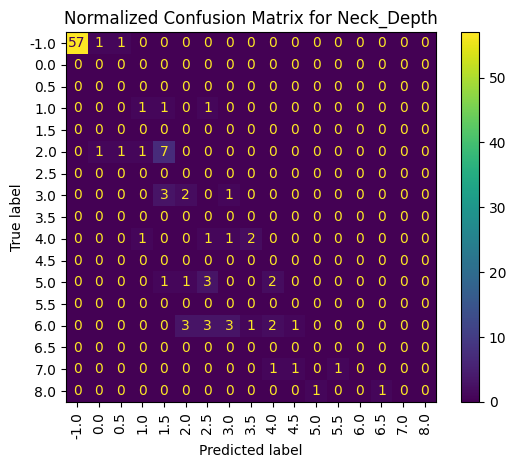



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   6.
  6.5  7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

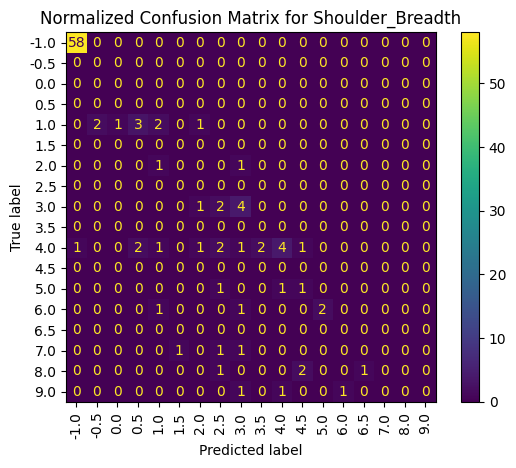



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5
  6.   7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

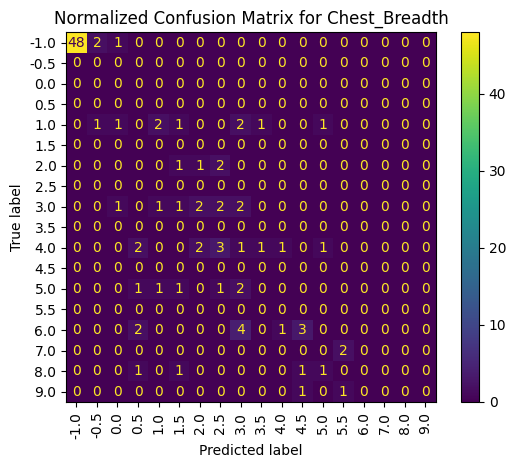



DISPLAY LABELS = unique sorted ground truth values
[-1.5 -1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.
  5.5  7.   8. ]


<Figure size 1000x1000 with 0 Axes>

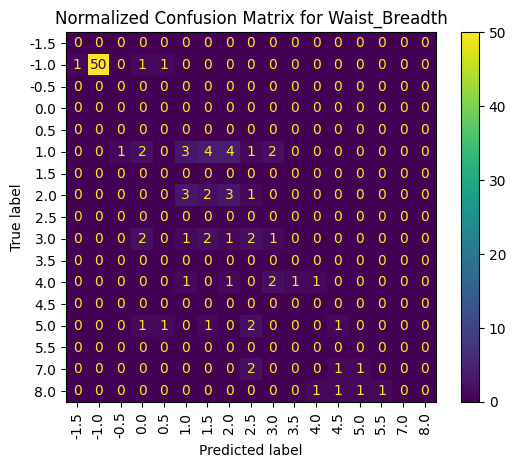



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   6.   7.
  8.   9. ]


<Figure size 1000x1000 with 0 Axes>

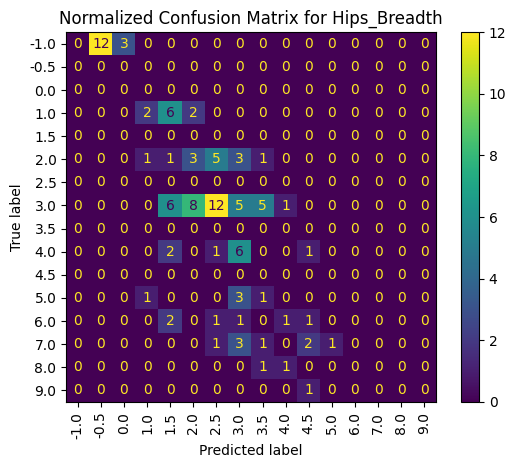



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5  6.
  6.5  7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

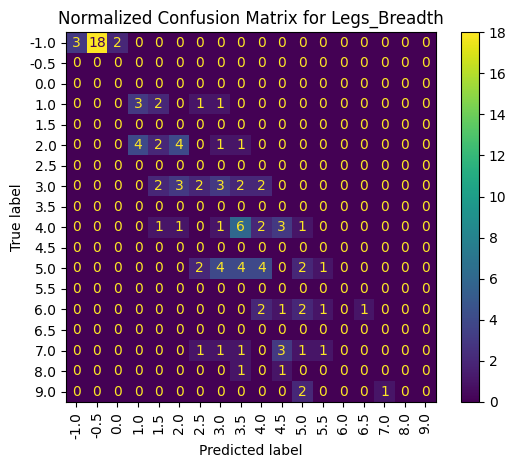



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5
  6.   6.5  7.   7.5  8.   9. ]


<Figure size 1000x1000 with 0 Axes>

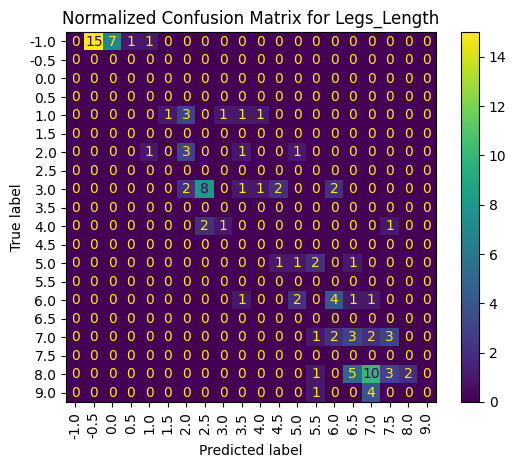



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   6.
  7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

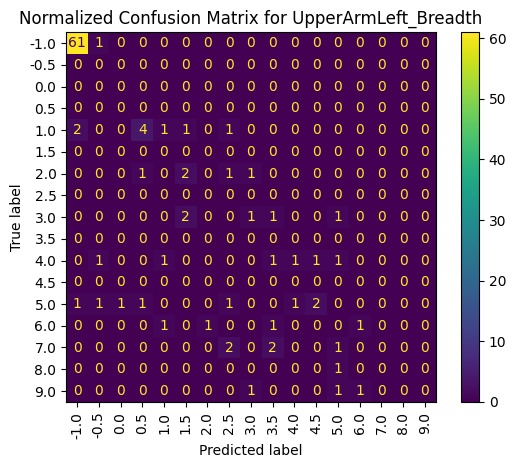



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5
  6.   7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

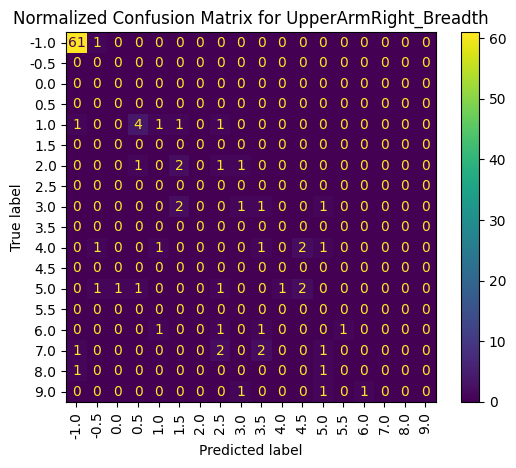



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5
  6.   6.5  7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

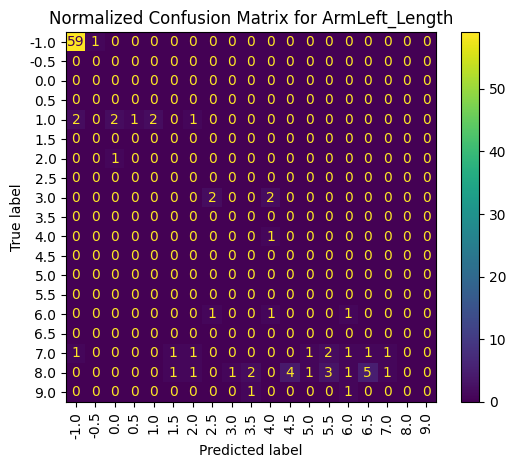



DISPLAY LABELS = unique sorted ground truth values
[-1.  -0.5  0.   0.5  1.   1.5  2.   2.5  3.   3.5  4.   4.5  5.   5.5
  6.   6.5  7.   8.   9. ]


<Figure size 1000x1000 with 0 Axes>

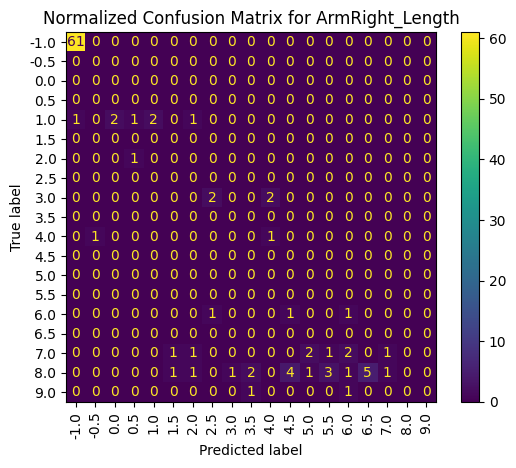

'\ni = 0\nfor regName in output_order:\n    confusion_matrix = metrics.confusion_matrix(truth_times10[i], predictions_discrete_times10[i], normalize=\'all\')\n    confusion_matrices.append(confusion_matrix)\n    display_labels = return_Array_Unique_GroundTruth_Prediction_Values(individualRegressionTruthNPArrays[i], individualRegressionPredictionNPArraysDISCRETE[i])\n\n    plt.figure(figsize=(12, 12))  # Increase figure size\n    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix=confusion_matrix, display_labels=display_labels)\n    ax = cm_display.plot(cmap=plt.cm.Blues).ax_  # Get the axes object from the plot\n\n    # Customize text annotations for better readability\n    for labels in ax.texts:\n        text = labels.get_text()\n        if text != \'0.00\':  # Avoid cluttering with zeros or very small numbers\n            labels.set_color(\'white\' if float(text) > 0.5 else \'black\')  # Change text color based on background\n            labels.set_fontsize(12)  # Make fon

In [ ]:
#now create Confusion Matrix using predictions_discrete and severities from above
# Implement confusion matrix

import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

#STEP 1: for EACH regression value create a Confusion Matix
confusion_matrices = []


print("GROUND TRUTH")
print(individualRegressionTruthNPArrays)  #ground truth
print("\n\nPREDICTIONS")
print(individualRegressionPredictionNPArraysDISCRETE)  #discretized predictions
print("\n\n")

print("GROUND TRUTH X 10")
print(truth_times10)
print("PREDICTIONS x 10")
print(predictions_discrete_times10)

num_classes = len(np.unique(np.concatenate((truth_times10, predictions_discrete_times10))))
fig_size = max(12, num_classes / 3)

i=0
for regName in output_order:
  confusion_matrix = metrics.confusion_matrix(truth_times10[i], predictions_discrete_times10[i], normalize= None)
  confusion_matrices.append(confusion_matrix)
  # Need to find only the actual values in ground truth& predicitons for the display_labels
  # as error to present classes that are not present in the data to sklearn's confusion matrix code
  display_labels = return_Array_Unique_GroundTruth_Prediction_Values(individualRegressionTruthNPArrays[i], individualRegressionPredictionNPArraysDISCRETE[i])
  print("\n\nDISPLAY LABELS = unique sorted ground truth values")
  print(display_labels)

  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = display_labels)
  plt.figure(figsize=(10, 10))
  cm_display.plot()

  plt.title(f"Normalized Confusion Matrix for {regName}")
  plt.xticks(rotation=90)

  plt.show()
  plt.close()
  i=i+1

# **STEP 11:  Scatter plot of predicted versus truth**

##  ONLY RUN after cell 5.2 is run --expects predictions and severities = test["severity"] array (later is ground truth) to exist


See https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.scatter.html

Scatter plot for Neck_Depth
 truth[3.0, 7.0, -1.0, 6.0, -1.0, -1.0, 2.0, 5.0, -1.0, -1.0, -1.0, -1.0, 5.0, -1.0, -1.0, 6.0, 2.0, 5.0, -1.0, -1.0, 1.0, 6.0, -1.0, -1.0, 3.0, 8.0, -1.0, -1.0, 6.0, -1.0, 4.0, 6.0, -1.0, 6.0, 5.0, 2.0, -1.0, 6.0, -1.0, 6.0, 3.0, 4.0, -1.0, -1.0, 5.0, -1.0, 7.0, -1.0, -1.0, -1.0, 5.0, -1.0, 8.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 6.0, -1.0, 3.0, -1.0, 4.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 2.0, -1.0, -1.0, 2.0, 2.0, 6.0, 1.0, -1.0, -1.0, -1.0, 6.0, -1.0, -1.0, 6.0, 4.0, 3.0, 5.0, 2.0, 4.0, -1.0, -1.0, 7.0, -1.0, -1.0, -1.0, -1.0, 6.0, 2.0, 2.0, 2.0, -1.0, -1.0, -1.0, 3.0]
 predictions [1.5, 4.0, -1.0, 4.0, -1.0, -1.0, 0.5, 2.5, -1.0, -1.0, -1.0, -1.0, 2.5, -1.0, -1.0, 2.0, 1.5, 4.0, 0.0, -1.0, 1.0, 2.0, -1.0, -1.0, 2.0, 5.0, -1.0, -1.0, 3.0, -1.0, 3.5, 3.0, -1.0, 4.5, 1.5, 0.0, -1.0, 2.5, -1.0, 2.5, 1.5, 2.5, -1.0, -1.0, 4.0, -1.0, 4.5, -1.0, -1.0, -1.0, 2.5, -1.0, 6.5, -1.0, -1.0, -1.0, 1.5, -1.0, -1.0, -1.0, -1.0, -1.0, 2.0, -1.0

Text(0.5, 1.0, 'Neck_Depth & Shoulder_Breadth & Chest_Breadth & Waist_Breadth & Hips_Breadth & Legs_Breadth & Legs_Length & UpperArmLeft_Breadth & UpperArmRight_Breadth & ArmLeft_Length & ArmRight_Length')

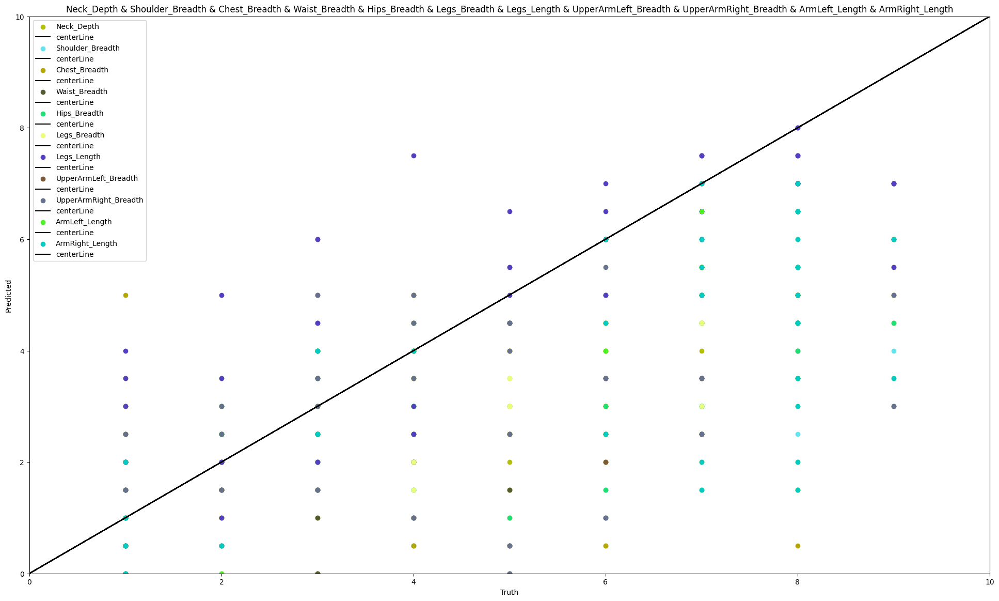

In [ ]:
def scatterplot_multipleRegressionValues_truth_predicted(title, ax, x, y):
  #ax.xlim(0,10)
  #ax.ylim(0,10)
  ax.scatter(x, y, label=title)
  #plt.scatter(severities, predictions, label='Data')
  #plt.plot(x, y, color='k', label='centerLine')
  ax.axline((1, 1), slope=1, label='centerLine', color='k')
  ax.set_title(title)
  #ax.xlabel('Truth')
  #ax.ylabel('Predicted')
  ax.legend(loc='upper left', bbox_to_anchor=(1, 1))


def scatterplot_truth_predicted(title, x, y):
  import random as random
  plt.xlim(0,10)
  plt.ylim(0,10)
  r= random.random()
  g = random.random()
  b = random.random()
  plt.scatter(x, y, color=(r,g,b), label=title)
  #plt.scatter(severities, predictions, label='Data')
  #plt.plot(x, y, color='k', label='centerLine')
  plt.axline((1, 1), slope=1, label='centerLine', color='k')
  plt.xlabel('Truth')
  plt.ylabel('Predicted')
  plt.legend()
  plt.title(title, color=(r,g,b))

import random as random
plt.figure(figsize=(24, 14))


#Cylce through EACH regression value and create the scatter plot
title = ""
i=0
for regName in output_order:
  if i != 0:
    title = title + " & "
  print("Scatter plot for " + regName)
  print(" truth" + str(individualRegressionTruthNPArrays[i]))
  print(" predictions " + str(individualRegressionPredictionNPArraysDISCRETE[i]))
  scatterplot_truth_predicted(regName, individualRegressionTruthNPArrays[i], individualRegressionPredictionNPArraysDISCRETE[i])
  #scatterplot_multipleRegressionValues_truth_predicted(regName, ax[i], individualRegressionTruthNPArrays[i], individualRegressionPredictionNPArraysDISCRETE[i])

  title = title + regName
  i = i+1

plt.title(title, color=(0,0,0))

Scatter plot for Neck_Depth
 truth[3.0, 7.0, -1.0, 6.0, -1.0, -1.0, 2.0, 5.0, -1.0, -1.0, -1.0, -1.0, 5.0, -1.0, -1.0, 6.0, 2.0, 5.0, -1.0, -1.0, 1.0, 6.0, -1.0, -1.0, 3.0, 8.0, -1.0, -1.0, 6.0, -1.0, 4.0, 6.0, -1.0, 6.0, 5.0, 2.0, -1.0, 6.0, -1.0, 6.0, 3.0, 4.0, -1.0, -1.0, 5.0, -1.0, 7.0, -1.0, -1.0, -1.0, 5.0, -1.0, 8.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 6.0, -1.0, 3.0, -1.0, 4.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, 2.0, -1.0, -1.0, 2.0, 2.0, 6.0, 1.0, -1.0, -1.0, -1.0, 6.0, -1.0, -1.0, 6.0, 4.0, 3.0, 5.0, 2.0, 4.0, -1.0, -1.0, 7.0, -1.0, -1.0, -1.0, -1.0, 6.0, 2.0, 2.0, 2.0, -1.0, -1.0, -1.0, 3.0]
 predictions [1.5, 4.0, -1.0, 4.0, -1.0, -1.0, 0.5, 2.5, -1.0, -1.0, -1.0, -1.0, 2.5, -1.0, -1.0, 2.0, 1.5, 4.0, 0.0, -1.0, 1.0, 2.0, -1.0, -1.0, 2.0, 5.0, -1.0, -1.0, 3.0, -1.0, 3.5, 3.0, -1.0, 4.5, 1.5, 0.0, -1.0, 2.5, -1.0, 2.5, 1.5, 2.5, -1.0, -1.0, 4.0, -1.0, 4.5, -1.0, -1.0, -1.0, 2.5, -1.0, 6.5, -1.0, -1.0, -1.0, 1.5, -1.0, -1.0, -1.0, -1.0, -1.0, 2.0, -1.0

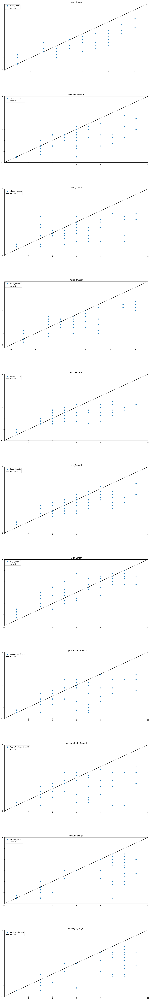

In [ ]:
def scatterplot_multipleRegressionValues_truth_predicted(title, ax, x, y):
  #ax.xlim(0,10)
  #ax.ylim(0,10)
  ax.scatter(x, y, label=title)
  min_val = min(min(x), min(y))  # Find the minimum value among truth and predicted
  max_val = max(max(x), max(y))
  #plt.scatter(severities, predictions, label='Data')
  #plt.plot(x, y, color='k', label='centerLine')
  ax.axline((min_val, min_val), slope=1, label='centerLine', color='k')
  ax.set_xlim(min_val - 1, max_val + 1)
  ax.set_ylim(min_val - 1, max_val + 1)

  ax.set_title(title)
  #ax.xlabel('Truth')
  #ax.ylabel('Predicted')
  ax.legend()



def scatterplot_truth_predicted(title, x, y):
  import random as random
  plt.xlim(0,10)
  plt.ylim(0,10)
  r= random.random()
  g = random.random()
  b = random.random()
  plt.scatter(x, y, color=(r,g,b), label=title)
  #plt.scatter(severities, predictions, label='Data')
  #plt.plot(x, y, color='k', label='centerLine')
  plt.axline((1, 1), slope=1, label='centerLine', color='k')
  plt.xlabel('Truth')
  plt.ylabel('Predicted')
  plt.legend()
  plt.title(title, color=(r,g,b))

import random as random
# Creating 2 subplots
fig, ax = plt.subplots(nrows=output_dimension, ncols=1, figsize=(16, 10 * output_dimension))
if output_dimension == 1:
    ax = [ax]
fig.tight_layout(pad=3.0)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.4, hspace=0.4)

#Cylce through EACH regression value and create the scatter plot
title = ""
i=0
for regName in output_order:
  if i != 0:
    title = title + " & "
  print("Scatter plot for " + regName)
  print(" truth" + str(individualRegressionTruthNPArrays[i]))
  print(" predictions " + str(individualRegressionPredictionNPArraysDISCRETE[i]))
  scatterplot_multipleRegressionValues_truth_predicted(regName, ax[i], individualRegressionTruthNPArrays[i], individualRegressionPredictionNPArraysDISCRETE[i])

  title = title + regName
  i = i+1


# **STEP 13: OPTION -load model from saved model**




```
TypeError                                 Traceback (most recent call last)
<ipython-input-23-7bd21d2cd051> in <cell line: 2>()
      1 model_dir = "drive/MyDrive/iLab/Stroke/LabeledData-Eye-Regression/saved_model"
----> 2 new_model = tf.keras.models.load_model(model_dir)
      3
      4 # Check its architecture
      5 new_model.summary()

1 frames
/usr/local/lib/python3.9/dist-packages/keras/dtensor/utils.py in _wrap_function(instance, *args, **kwargs)
    142         if mesh is not None:
    143             instance._mesh = mesh
--> 144         init_method(instance, *args, **kwargs)
    145
    146     return tf.__internal__.decorator.make_decorator(

TypeError: __init__() got an unexpected keyword argument 'reduction'
```



get error : https://stackoverflow.com/questions/74646911/typeerror-init-got-an-unexpected-keyword-argument-reduction-while-tryin


see https://stackoverflow.com/questions/65014660/tensorflow-2-2-0-and-keras-save-model-load-model-problems


Have resolved/bypassed the original keyword argument 'reduction' error by REMOVING the MeanSquareError() metric during model compile of original model. Original model:

model.compile(loss=positive_mse,
              optimizer=Adam(lr=LEARNING_RATE, decay=DECAY),
              metrics=[tf.keras.losses.MeanSquaredError()])

From the Keras docs: "Note that this is an important difference between loss functions like tf.keras.losses.mean_squared_error and default loss class instances like tf.keras.losses.MeanSquaredError: the function version does not perform reduction, but by default the class instance does."

The MeanSquaaredError loss class function is passing a 'reduction' keyword during evaluation of loss over a minibatch. Removing this metric allows model to be reloaded without error.

In [ ]:
model_dir = "drive/MyDrive/iLab/Orientation/ML_Regression/saved_model"
new_model = tf.keras.models.load_model(model_dir)

# Check its architecture
new_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1280)              5919312   
                                                                 
 dropout_1 (Dropout)         (None, 1280)              0         
                                                                 
 pred (Dense)                (None, 1)                 1281      
                                                                 
Total params: 5920593 (22.59 MB)
Trainable params: 5859985 (22.35 MB)
Non-trainable params: 60608 (236.75 KB)
_________________________________________________________________
